<a href="https://colab.research.google.com/github/shalin07/CMIP-for-AER/blob/master/CESM_2_main.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Installing Dependencies


In [0]:
! pip install --upgrade xarray zarr gcsfs cftime nc-time-axis

!apt-get install libgeos-3.6.2
!apt-get install libgeos-dev
!pip install https://github.com/matplotlib/basemap/archive/master.zip
!pip install pyproj==1.9.6

Requirement already up-to-date: xarray in /usr/local/lib/python3.6/dist-packages (0.15.1)
     |████████████████████████████████| 3.3MB 2.7MB/s 
     |████████████████████████████████| 327kB 34.5MB/s 
     |████████████████████████████████| 3.8MB 21.7MB/s 
  Created wheel for zarr: filename=zarr-2.4.0-cp36-none-any.whl size=127066 sha256=8a611cc6f6fb5c75738196e36a18a3f0242aac7dbf5525ebb1741ebf705d323b
  Stored in directory: /root/.cache/pip/wheels/e1/5b/25/24c685604b91139aba00a5b6299b53e7a0661f737f27782559
  Created wheel for asciitree: filename=asciitree-0.3.3-cp36-none-any.whl size=5037 sha256=fd9f5d91ce326623ba38b5da6ea3e67f2bbc2799ae87b580008cf1a1355d8635
  Stored in directory: /root/.cache/pip/wheels/1d/d9/58/9808b306744df0208fccc640d3d9952a5bc7468502d42897d5
  Created wheel for numcodecs: filename=numcodecs-0.6.4-cp36-cp36m-linux_x86_64.whl size=3889977 sha256=bd8040c76567d26955d1e38d573f0db40df1cb9cc1d4067f08509e59ea3b784b
  Stored in directory: /root/.cache/pip/wheels/ca/07/ed/

     |████████████████████████████████| 2.8MB 2.7MB/s 
  Created wheel for pyproj: filename=pyproj-1.9.6-cp36-cp36m-linux_x86_64.whl size=3702096 sha256=ad4d25fa6ffd5bd84aecb2e66ff91419f0420e1306c099f7d8c2483b3d84a784
  Stored in directory: /root/.cache/pip/wheels/02/cd/b1/a2d6430f74c7a778a43d62f78bec109ca69c732dc9b929142a
Successfully built pyproj
  Found existing installation: pyproj 2.6.0
    Uninstalling pyproj-2.6.0:
      Successfully uninstalled pyproj-2.6.0


# Importing Libraries


In [0]:
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd
import xarray as xr
import zarr
import gcsfs
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
from mpl_toolkits.basemap import Basemap, addcyclic, shiftgrid
import numpy as np

xr.set_options(display_style='html')
%matplotlib inline
%config InlineBackend.figure_format = 'retina' 

# Reading CSV File


In [0]:
df = pd.read_csv('https://storage.googleapis.com/cmip6/cmip6-zarr-consolidated-stores.csv')
df

,activity_id,institution_id,source_id,experiment_id,member_id,table_id,variable_id,grid_label,zstore,dcpp_init_year
0,AerChemMIP,AS-RCEC,TaiESM1,histSST,r1i1p1f1,AERmon,od550aer,gn,gs://cmip6/AerChemMIP/AS-RCEC/TaiESM1/histSST/...,NaN
1,AerChemMIP,BCC,BCC-ESM1,histSST,r1i1p1f1,AERmon,mmrbc,gn,gs://cmip6/AerChemMIP/BCC/BCC-ESM1/histSST/r1i...,NaN
2,AerChemMIP,BCC,BCC-ESM1,histSST,r1i1p1f1,AERmon,mmrdust,gn,gs://cmip6/AerChemMIP/BCC/BCC-ESM1/histSST/r1i...,NaN
3,AerChemMIP,BCC,BCC-ESM1,histSST,r1i1p1f1,AERmon,mmroa,gn,gs://cmip6/AerChemMIP/BCC/BCC-ESM1/histSST/r1i...,NaN
4,AerChemMIP,BCC,BCC-ESM1,histSST,r1i1p1f1,AERmon,mmrso4,gn,gs://cmip6/AerChemMIP/BCC/BCC-ESM1/histSST/r1i...,NaN
...,...,...,...,...,...,...,...,...,...,...
259416,ScenarioMIP,UA,MCM-UA-1-0,ssp585,r1i1p1f2,Omon,tos,gn,gs://cmip6/ScenarioMIP/UA/MCM-UA-1-0/ssp585/r1...,NaN
259417,ScenarioMIP,UA,MCM-UA-1-0,ssp585,r1i1p1f2,Omon,uo,gn,gs://cmip6/ScenarioMIP/UA/MCM-UA-1-0/ssp585/r1...,NaN
259418,ScenarioMIP,UA,MCM-UA-1-0,ssp585,r1i1p1f2,Omon,vo,gn,gs://cmip6/ScenarioMIP/UA/MCM-UA-1-0/ssp585/r1...,NaN
259419,ScenarioMIP,UA,MCM-UA-1-0,ssp585,r1i1p1f2,Omon,wo,gn,gs://cmip6/ScenarioMIP/UA/MCM-UA-1-0/ssp585/r1...,NaN


# Getting Model with given information


In [0]:
df_cesm = df.query("table_id == 'Amon' & variable_id == 'zg' & experiment_id == 'piControl' & source_id == 'CESM2'")
df_cesm

,activity_id,institution_id,source_id,experiment_id,member_id,table_id,variable_id,grid_label,zstore,dcpp_init_year
53626,CMIP,NCAR,CESM2,piControl,r1i1p1f1,Amon,zg,gn,gs://cmip6/CMIP/NCAR/CESM2/piControl/r1i1p1f1/...,NaN


# Opening Zarr file


In [0]:
gcs = gcsfs.GCSFileSystem(token='anon')
ds_cesm = xr.open_zarr(gcs.get_mapper(df_cesm.zstore.values[0]), consolidated=True)
ds_cesm

<xarray.Dataset>
Dimensions:    (lat: 192, lon: 288, nbnd: 2, plev: 19, time: 14400)
Coordinates:
  * lat        (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 88.12 89.06 90.0
    lat_bnds   (lat, nbnd) float32 dask.array<chunksize=(192, 2), meta=np.ndarray>
  * lon        (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
    lon_bnds   (lon, nbnd) float32 dask.array<chunksize=(288, 2), meta=np.ndarray>
  * plev       (plev) float64 1e+05 9.25e+04 8.5e+04 7e+04 ... 1e+03 500.0 100.0
  * time       (time) object 0001-01-15 12:00:00 ... 1200-12-15 12:00:00
    time_bnds  (time, nbnd) object dask.array<chunksize=(14400, 2), meta=np.ndarray>
Dimensions without coordinates: nbnd
Data variables:
    zg         (time, plev, lat, lon) float32 dask.array<chunksize=(30, 19, 192, 288), meta=np.ndarray>
Attributes:
    Conventions:            CF-1.7 CMIP-6.2
    activity_id:            CMIP
    branch_method:          standard
    branch_time_in_child:   0.0
    branch_time_in_parent:  48545.0
    case_id:                3
    cesm_casename:          b.e21.B1850.f09_g17.CMIP6-piControl.001
    contact:                cesm_cmip6@ucar.edu
    creation_date:          2019-01-20T22:41:36Z
    data_specs_version:     01.00.29
    experiment:             pre-industrial control
    experiment_id:          piControl
    external_variables:     areacella
    forcing_index:          1
    frequency:              mon
    further_info_url:       https://furtherinfo.es-doc.org/CMIP6.NCAR.CESM2.p...
    grid:                   native 0.9x1.25 finite volume grid (192x288 latxlon)
    grid_label:             gn
    initialization_index:   1
    institution:            National Center for Atmospheric Research, Climate...
    institution_id:         NCAR
    license:                CMIP6 model data produced by <The National Center...
    mip_era:                CMIP6
    model_doi_url:          https://doi.org/10.5065/D67H1H0V
    nominal_resolution:     100 km
    parent_activity_id:     CMIP
    parent_experiment_id:   piControl-spinup
    parent_mip_era:         CMIP6
    parent_source_id:       CESM2
    parent_time_units:      days since 0001-01-01 00:00:00
    parent_variant_label:   r1i1p1f1
    physics_index:          1
    product:                model-output
    realization_index:      1
    realm:                  atmos
    source:                 CESM2 (2017): atmosphere: CAM6 (0.9x1.25 finite v...
    source_id:              CESM2
    source_type:            AOGCM BGC AER
    sub_experiment:         none
    sub_experiment_id:      none
    table_id:               Amon
    tracking_id:            hdl:21.14100/9eddf64a-cf0f-489d-9ce4-8b514e591b1a...
    variable_id:            zg
    variant_info:           CMIP6 CESM2 piControl experiment with CAM6, inter...
    variant_label:          r1i1p1f1
    status:                 2019-10-25;created;by nhn2@columbia.edu

# Converting Dask array to in-memory NumPy array for faster processing





In [0]:
ds_cesm_500 = ds_cesm.sel(plev = 50000)
ds_cesm_500.load()

<xarray.Dataset>
Dimensions:    (lat: 192, lon: 288, nbnd: 2, time: 14400)
Coordinates:
  * lat        (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 88.12 89.06 90.0
    lat_bnds   (lat, nbnd) float32 -90.0 -89.52879 -89.52879 ... 89.52879 90.0
  * lon        (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
    lon_bnds   (lon, nbnd) float32 -0.625 0.625 0.625 ... 358.125 359.375
    plev       float64 5e+04
  * time       (time) object 0001-01-15 12:00:00 ... 1200-12-15 12:00:00
    time_bnds  (time, nbnd) object 0001-01-01 00:00:00 ... 1201-01-01 00:00:00
Dimensions without coordinates: nbnd
Data variables:
    zg         (time, lat, lon) float32 5084.511 5084.511 ... 5042.668 5042.668
Attributes:
    Conventions:            CF-1.7 CMIP-6.2
    activity_id:            CMIP
    branch_method:          standard
    branch_time_in_child:   0.0
    branch_time_in_parent:  48545.0
    case_id:                3
    cesm_casename:          b.e21.B1850.f09_g17.CMIP6-piControl.001
    contact:                cesm_cmip6@ucar.edu
    creation_date:          2019-01-20T22:41:36Z
    data_specs_version:     01.00.29
    experiment:             pre-industrial control
    experiment_id:          piControl
    external_variables:     areacella
    forcing_index:          1
    frequency:              mon
    further_info_url:       https://furtherinfo.es-doc.org/CMIP6.NCAR.CESM2.p...
    grid:                   native 0.9x1.25 finite volume grid (192x288 latxlon)
    grid_label:             gn
    initialization_index:   1
    institution:            National Center for Atmospheric Research, Climate...
    institution_id:         NCAR
    license:                CMIP6 model data produced by <The National Center...
    mip_era:                CMIP6
    model_doi_url:          https://doi.org/10.5065/D67H1H0V
    nominal_resolution:     100 km
    parent_activity_id:     CMIP
    parent_experiment_id:   piControl-spinup
    parent_mip_era:         CMIP6
    parent_source_id:       CESM2
    parent_time_units:      days since 0001-01-01 00:00:00
    parent_variant_label:   r1i1p1f1
    physics_index:          1
    product:                model-output
    realization_index:      1
    realm:                  atmos
    source:                 CESM2 (2017): atmosphere: CAM6 (0.9x1.25 finite v...
    source_id:              CESM2
    source_type:            AOGCM BGC AER
    sub_experiment:         none
    sub_experiment_id:      none
    table_id:               Amon
    tracking_id:            hdl:21.14100/9eddf64a-cf0f-489d-9ce4-8b514e591b1a...
    variable_id:            zg
    variant_info:           CMIP6 CESM2 piControl experiment with CAM6, inter...
    variant_label:          r1i1p1f1
    status:                 2019-10-25;created;by nhn2@columbia.edu

# Getting Mean Month-Wise


In [0]:
monthly_mean = ds_cesm_500.groupby('time.month').mean()

# Plotting Monthly Mean on globe


In [0]:
lats = monthly_mean.variables['lat'][:]
lons = monthly_mean.variables['lon'][:]
zg = monthly_mean.variables['zg'][:]
months = ['Jan', "Feb", 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

for i in range(len(months)):
  plt.figure(figsize=(18,9))
  m = Basemap(projection='moll', llcrnrlat=-90, urcrnrlat=90,\
              llcrnrlon=0, urcrnrlon=360, resolution='c', lon_0=0)

  m.drawcoastlines()
  m.drawmapboundary()

  z_cyclic, lons_cyclic = addcyclic(np.array(zg[i, :, :].data), lons)
  # Shift the grid so lons go from -180 to 180 instead of 0 to 360.
  z_cyclic, lons_cyclic = shiftgrid(180., z_cyclic, lons_cyclic, start=False)
  # Create 2D lat/lon arrays for Basemap
  lon2d, lat2d = np.meshgrid(lons_cyclic, lats)

  x, y = m(lon2d, lat2d)

  cs = m.contourf(x, y, z_cyclic, 11, cmap=plt.cm.Spectral_r)
  cbar = plt.colorbar(cs, orientation='horizontal', shrink=0.5)
  cbar.set_label('Mean GeoPotential-height at 500hPa for ' + months[i])

In [0]:
lats = monthly_mean.variables['lat'][:]
lons = monthly_mean.variables['lon'][:]
zg = monthly_mean.variables['zg'][:]

months = ['Jan', "Feb", 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

for i in range(12):
  plt.figure(figsize=(18,9))
  m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
                llcrnrlon=0, urcrnrlon=360, resolution='c', lon_0=0)

  m.drawcoastlines()
  m.drawmapboundary()
  m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
  m.drawmeridians(np.arange(-180.,180.,60.),labels=[0,0,0,1])

  x, y = m(*np.meshgrid(lons,lats))

  m.pcolormesh(x,y,zg[i, :, :], shading='flat',cmap=plt.cm.jet, vmin = 4750, vmax = 6000)
  m.colorbar(location='right')
  plt.title('Mean GeoPotential-height at 500hPa for ' + months[i])

# Monthly Mean - Total 1200 Years Mean


In [0]:
total_mean = monthly_mean.mean(dim='month')
total_mean

monthly_mean = monthly_mean  - total_mean

<xarray.Dataset>
Dimensions:   (lat: 192, lon: 288, nbnd: 2)
Coordinates:
    lat_bnds  (lat, nbnd) float32 -90.0 -89.52879 -89.52879 ... 89.52879 90.0
    plev      float64 5e+04
    lon_bnds  (lon, nbnd) float32 -0.625 0.625 0.625 ... 358.125 358.125 359.375
  * lat       (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 88.12 89.06 90.0
  * lon       (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
Dimensions without coordinates: nbnd
Data variables:
    zg        (lat, lon) float32 4930.1978 4930.1978 ... 5241.4927 5241.4927

In [0]:
lats = monthly_mean.variables['lat'][:]
lons = monthly_mean.variables['lon'][:]
zg = monthly_mean.variables['zg'][:]
months = ['Jan', "Feb", 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

for i in range(len(months)):
  plt.figure(figsize=(18,9))
  m = Basemap(projection='moll', llcrnrlat=-90, urcrnrlat=90,\
              llcrnrlon=0, urcrnrlon=360, resolution='c', lon_0=0)

  m.drawcoastlines()
  m.drawmapboundary()

  z_cyclic, lons_cyclic = addcyclic(np.array(zg[i, :, :].data), lons)
  # Shift the grid so lons go from -180 to 180 instead of 0 to 360.
  z_cyclic, lons_cyclic = shiftgrid(180., z_cyclic, lons_cyclic, start=False)
  # Create 2D lat/lon arrays for Basemap
  lon2d, lat2d = np.meshgrid(lons_cyclic, lats)

  x, y = m(lon2d, lat2d)

  cs = m.contourf(x, y, z_cyclic, 11, cmap=plt.cm.Spectral_r)
  cbar = plt.colorbar(cs, orientation='horizontal', shrink=0.5)
  cbar.set_label('Differnce Between Mean GeoPotential-height for ' + months[i] +' and Mean GeoPotential-height of 1200 year span')

In [0]:
lats = monthly_mean.variables['lat'][:]
lons = monthly_mean.variables['lon'][:]
zg = monthly_mean.variables['zg'][:]

months = ['Jan', "Feb", 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

for i in range(len(months)):
  plt.figure(figsize=(18,9))
  m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
                llcrnrlon=0, urcrnrlon=360, resolution='c', lon_0=0)

  m.drawcoastlines()
  m.drawmapboundary()
  m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
  m.drawmeridians(np.arange(-180.,180.,60.),labels=[0,0,0,1])

  x, y = m(*np.meshgrid(lons,lats))

  m.pcolormesh(x,y,zg[i, :, :], shading='flat',cmap=plt.cm.jet, vmin = -250, vmax = 250)
  m.colorbar(location='right')
  plt.title('Differnce Between Mean GeoPotential-height for ' + months[i] +' and Mean GeoPotential-height of 1200 year span')

# January



In [0]:
import cftime

monthly_data = ds_cesm_500.groupby('time.month').groups
jan_data = monthly_data[1]
gs_jan=ds_cesm_500.isel(time=jan_data)
zg = gs_jan.zg
zg = zg.where(zg.time != cftime.DatetimeNoLeap(500,1,15,12,0,0), drop=True)

# Mean and STD of Jan


In [0]:
gs_jan_std = zg.groupby('time.month').std()
gs_jan_mean = zg.groupby('time.month').mean()

# Plotting STD and Mean


<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06f0c2a7f0>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06f0c2af98>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06f11327b8>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06f1132a20>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06f1132d68>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06f1132e10>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06f1132630>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06f7f7b470>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06f1cb3ef0>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06f1cb3470>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06f1cb3e48>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06f1cb3198>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06f7fa0908>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, "STD of 1199 January's")

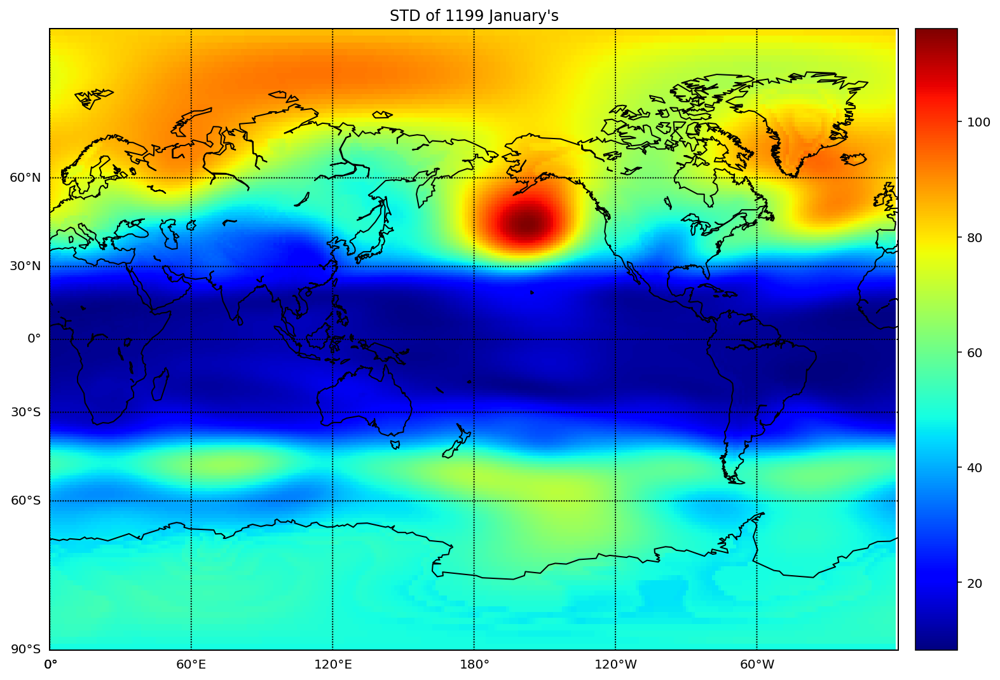

In [0]:
lats = gs_jan_std['lat'][:]
lons = gs_jan_std['lon'][:]
zg = gs_jan_std[:]

plt.figure(figsize=(18,9))
m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
                llcrnrlon=0, urcrnrlon=360, resolution='c', lon_0=0)

m.drawcoastlines()
m.drawmapboundary()
m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
m.drawmeridians(np.arange(-180.,180.,60.),labels=[0,0,0,1])

x, y = m(*np.meshgrid(lons,lats))

m.pcolormesh(x,y,zg[0, :, :], shading='flat',cmap=plt.cm.jet)
m.colorbar(location='right')
plt.title("STD of 1199 January's")

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06f41c6b38>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06f41c60f0>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06f41c6b70>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06f1aa46d8>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06f1aa40f0>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06f1aa4278>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06f1aa4828>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06f4068b38>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06f3ffc2b0>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06f3ffc828>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06f3ffc6d8>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06f3ffc1d0>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06f3ffcd30>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, "Mean of 1199 January's")

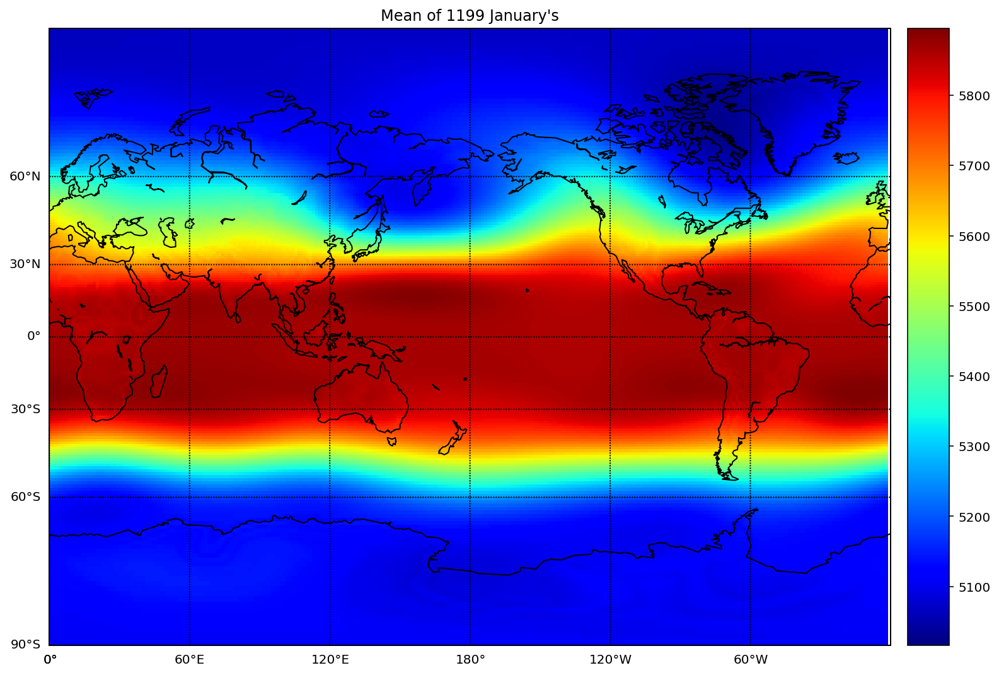

In [0]:
lats = gs_jan_mean['lat'][:]
lons = gs_jan_mean['lon'][:]
zg = gs_jan_mean[:]

plt.figure(figsize=(18,9))
m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
                llcrnrlon=0, urcrnrlon=360, resolution='c', lon_0=0)

m.drawcoastlines()
m.drawmapboundary()
m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
m.drawmeridians(np.arange(-180.,180.,60.),labels=[0,0,0,1])

x, y = m(*np.meshgrid(lons,lats))

m.pcolormesh(x,y,zg[0, :, :], shading='flat',cmap=plt.cm.jet)
m.colorbar(location='right')
plt.title("Mean of 1199 January's")

# Monthly anomaly of January


In [0]:
jan_monthly_anomalies = (gs_jan.groupby('time.month') - gs_jan_mean)/gs_jan_std

jan_monthly_anomalies

<xarray.Dataset>
Dimensions:    (lat: 192, lon: 288, month: 1, nbnd: 2, time: 1200)
Coordinates:
    lon_bnds   (lon, nbnd) float32 -0.625 0.625 0.625 ... 358.125 359.375
  * month      (month) int64 1
    plev       float64 5e+04
    lat_bnds   (lat, nbnd) float32 -90.0 -89.52879 -89.52879 ... 89.52879 90.0
  * lon        (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
  * lat        (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 88.12 89.06 90.0
  * time       (time) object 0001-01-15 12:00:00 ... 1200-01-15 12:00:00
    time_bnds  (time, nbnd) object 0001-01-01 00:00:00 ... 1200-02-01 00:00:00
Dimensions without coordinates: nbnd
Data variables:
    zg         (time, lat, lon, month) float32 -0.47543883 ... -0.79861426

# Plotting Target Jan(0500-01)

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06ee9230b8>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06ee923470>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06ee923748>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06ee923a58>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06ee923d68>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ee8890b8>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06ee8892e8>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ee896748>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06ee8967b8>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06ee896ac8>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06ee896dd8>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06ee89f128>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06ee89f438>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0500-01-15')

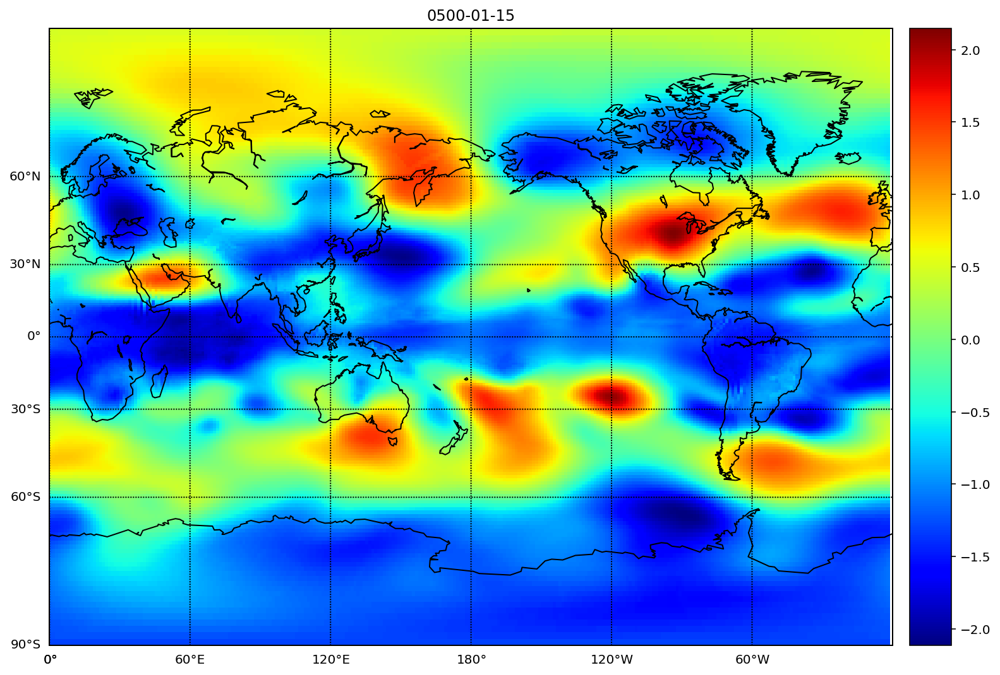

In [0]:
lats = jan_monthly_anomalies.variables['lat'][:]
lons = jan_monthly_anomalies.variables['lon'][:]
zg = jan_monthly_anomalies.variables['zg'][:]

plt.figure(figsize=(18,9))
m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
                llcrnrlon=0, urcrnrlon=360, resolution='c', lon_0=0)

m.drawcoastlines()
m.drawmapboundary()
m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
m.drawmeridians(np.arange(-180.,180.,60.),labels=[0,0,0,1])

x, y = m(*np.meshgrid(lons,lats))

m.pcolormesh(x,y,zg[499, :, :, 0], shading='flat',cmap=plt.cm.jet)
m.colorbar(location='right')
plt.title("0500-01-15")

# Getting Dimension of Alaska


In [0]:
gs_jan_alaska = jan_monthly_anomalies.sel(lat = range(60,70), lon = range(195,230), method='nearest')

# Calculating RMSE with respect to target year Jan(0500)

In [0]:
rms_alaska = []

for i in range(1200):
  err = 0
  err_1 = (gs_jan_alaska.zg[499, :, :] - gs_jan_alaska.zg[i, :, :])**2
  err_total = err_1.sum()
  err = ((err_total/(300))**(1/2))
  rms_alaska.append(err)

# Getting top 10 year with least RMSE 

In [0]:
import datetime 

a = sorted(range(len(rms_alaska)), key=lambda i: rms_alaska[i])[:11]

dates = [datetime.datetime.strptime(str(gs_jan_alaska.time[a[i]].values),"%Y-%m-%d %H:%M:%S").date() for i in range(11)] 

for i in range(10):
  print(str(i+1) +' Root mean Square Error of ' + str(dates[i+1]) + ': ' + str(rms_alaska[a[i+1]].values))

1 Root mean Square Error of 0980-01-15: 0.17703658739816436
2 Root mean Square Error of 1094-01-15: 0.18053101625537976
3 Root mean Square Error of 1017-01-15: 0.19270131966139506
4 Root mean Square Error of 0526-01-15: 0.19344381113598116
5 Root mean Square Error of 0434-01-15: 0.20220687341022203
6 Root mean Square Error of 0341-01-15: 0.20554720658309755
7 Root mean Square Error of 0330-01-15: 0.2143764300803779
8 Root mean Square Error of 0686-01-15: 0.22544549707115066
9 Root mean Square Error of 0216-01-15: 0.2267212340176995
10 Root mean Square Error of 0802-01-15: 0.22675507177185572


# Plotting Analog Year of Alaska Region

In [0]:
lats = jan_monthly_anomalies.variables['lat'][:]
lons = jan_monthly_anomalies.variables['lon'][:]
zg = jan_monthly_anomalies.variables['zg'][:]

for i in range(11):
  plt.figure(figsize=(18,9))
  m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
                llcrnrlon=0, urcrnrlon=360, resolution='c')

  m.drawcoastlines()
  m.drawmapboundary()
  m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
  m.drawmeridians(np.arange(0.,360., 60.),labels=[0,0,0,1])

  x, y = m(*np.meshgrid(lons,lats))

  m.pcolormesh(x,y,zg[a[i], :, :, 0], shading='flat',cmap=plt.cm.jet, vmin = -3, vmax = 3)
  m.colorbar(location='right', )
  plt.title(str(dates[i]) + ' RMS: '+ str(rms_alaska[a[i]].values))
  plt.savefig(str(i) + '_' + str(dates[i])+ '.png')

# Calculating RMSE with respect to target year Jan(0500)

In [0]:
rms = []

for i in range(1200):
  err = 0
  err_1 = (jan_monthly_anomalies.zg[499, :, :] - jan_monthly_anomalies.zg[i, :, :])**2
  err_total = err_1.sum()
  err = ((err_total/(192*288))**(1/2))
  rms.append(err)

# Getting top 10 year with least RMSE

In [0]:
import datetime 

a = sorted(range(len(rms)), key=lambda i: rms[i])[:11]

dates = [datetime.datetime.strptime(str(gs_jan.time[a[i]].values),"%Y-%m-%d %H:%M:%S").date() for i in range(11)] 

for i in range(10):
  print(str(i+1) +' Root mean Square Error of ' + str(dates[i+1]) + ': ' + str(rms[a[i+1]].values))

1 Root mean Square Error of 0341-01-15: 0.7392277825573562
2 Root mean Square Error of 1147-01-15: 0.7891172439726952
3 Root mean Square Error of 0943-01-15: 0.8029671955557536
4 Root mean Square Error of 0011-01-15: 0.8229859399409535
5 Root mean Square Error of 0359-01-15: 0.8242630172447403
6 Root mean Square Error of 0705-01-15: 0.8275485268192024
7 Root mean Square Error of 0494-01-15: 0.832259142806088
8 Root mean Square Error of 0204-01-15: 0.8340813564426554
9 Root mean Square Error of 0127-01-15: 0.8554576845322732
10 Root mean Square Error of 0386-01-15: 0.8555227127487025


# Plotting Histogram of RMSE values

(array([  2.,  99., 311., 344., 219., 130.,  62.,  24.,   6.]),
 array([0.6, 0.8, 1. , 1.2, 1.4, 1.6, 1.8, 2. , 2.2, 2.4]),
 <a list of 9 Patch objects>)

Text(0.5, 0, 'RMSE')

Text(0, 0.5, 'count')

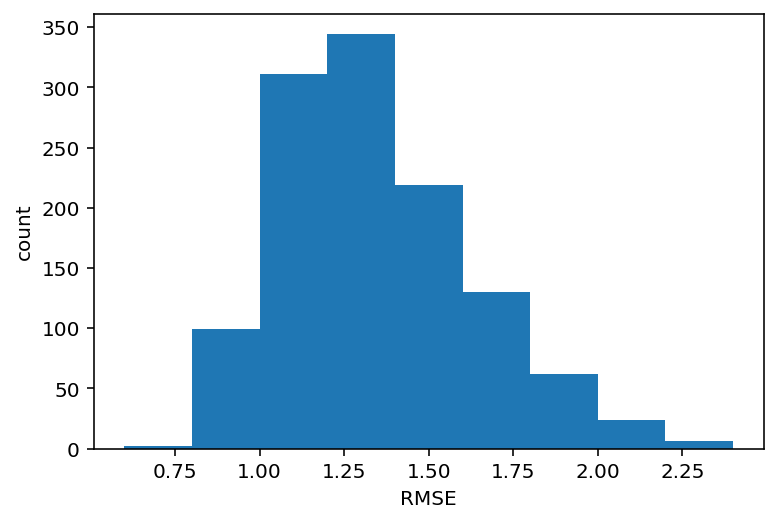

In [0]:
import numpy as np
bins = [0.6, 0.8, 1, 1.2, 1.4, 1.6, 1.8, 2, 2.2, 2.4]
plt.hist(rms, bins = bins, rwidth= 1.2)
plt.xlabel('RMSE')
plt.ylabel('count')

plt.show()

# Plotting Analog Years of Year 0500

In [0]:
lats = jan_monthly_anomalies.variables['lat'][:]
lons = jan_monthly_anomalies.variables['lon'][:]
zg = jan_monthly_anomalies.variables['zg'][:]

for i in range(11):
  plt.figure(figsize=(18,9))
  m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
                llcrnrlon=0, urcrnrlon=360, resolution='c')

  m.drawcoastlines()
  m.drawmapboundary()
  m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
  m.drawmeridians(np.arange(0.,360., 60.),labels=[0,0,0,1])

  x, y = m(*np.meshgrid(lons,lats))

  m.pcolormesh(x,y,zg[a[i], :, :, 0], shading='flat',cmap=plt.cm.jet, vmin = -2.5, vmax = 2.5)
  m.colorbar(location='right', )
  plt.title(str(dates[i]) + ' RMSE: '+ str(rms[a[i]].values))
  # plt.savefig(str(i+1) + '_' + str(dates[i])+ '.png')

# February


In [0]:
monthly_data = ds_cesm_500.groupby('time.month').groups
feb_data = monthly_data[2]
gs_feb=ds_cesm_500.isel(time=feb_data)
gs_feb

<xarray.Dataset>
Dimensions:    (lat: 192, lon: 288, nbnd: 2, time: 1200)
Coordinates:
  * lat        (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 88.12 89.06 90.0
    lat_bnds   (lat, nbnd) float32 -90.0 -89.52879 -89.52879 ... 89.52879 90.0
  * lon        (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
    lon_bnds   (lon, nbnd) float32 -0.625 0.625 0.625 ... 358.125 359.375
    plev       float64 5e+04
  * time       (time) object 0001-02-14 00:00:00 ... 1200-02-14 00:00:00
    time_bnds  (time, nbnd) object 0001-02-01 00:00:00 ... 1200-03-01 00:00:00
Dimensions without coordinates: nbnd
Data variables:
    zg         (time, lat, lon) float32 5016.61 5016.61 ... 5111.583 5111.583
Attributes:
    Conventions:            CF-1.7 CMIP-6.2
    activity_id:            CMIP
    branch_method:          standard
    branch_time_in_child:   0.0
    branch_time_in_parent:  48545.0
    case_id:                3
    cesm_casename:          b.e21.B1850.f09_g17.CMIP6-piControl.001
    contact:                cesm_cmip6@ucar.edu
    creation_date:          2019-01-20T22:41:36Z
    data_specs_version:     01.00.29
    experiment:             pre-industrial control
    experiment_id:          piControl
    external_variables:     areacella
    forcing_index:          1
    frequency:              mon
    further_info_url:       https://furtherinfo.es-doc.org/CMIP6.NCAR.CESM2.p...
    grid:                   native 0.9x1.25 finite volume grid (192x288 latxlon)
    grid_label:             gn
    initialization_index:   1
    institution:            National Center for Atmospheric Research, Climate...
    institution_id:         NCAR
    license:                CMIP6 model data produced by <The National Center...
    mip_era:                CMIP6
    model_doi_url:          https://doi.org/10.5065/D67H1H0V
    nominal_resolution:     100 km
    parent_activity_id:     CMIP
    parent_experiment_id:   piControl-spinup
    parent_mip_era:         CMIP6
    parent_source_id:       CESM2
    parent_time_units:      days since 0001-01-01 00:00:00
    parent_variant_label:   r1i1p1f1
    physics_index:          1
    product:                model-output
    realization_index:      1
    realm:                  atmos
    source:                 CESM2 (2017): atmosphere: CAM6 (0.9x1.25 finite v...
    source_id:              CESM2
    source_type:            AOGCM BGC AER
    sub_experiment:         none
    sub_experiment_id:      none
    table_id:               Amon
    tracking_id:            hdl:21.14100/9eddf64a-cf0f-489d-9ce4-8b514e591b1a...
    variable_id:            zg
    variant_info:           CMIP6 CESM2 piControl experiment with CAM6, inter...
    variant_label:          r1i1p1f1
    status:                 2019-10-25;created;by nhn2@columbia.edu

# Plotting Target February(0500-02)

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06f1b9eb00>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06f14faeb8>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06ee6336d8>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06ee3026d8>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06ee302dd8>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06f146a2b0>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06f146a940>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06f1aac278>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06ee3086a0>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06ee308898>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06ee378f28>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06f40ed9b0>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06f40edf28>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0500-02-14')

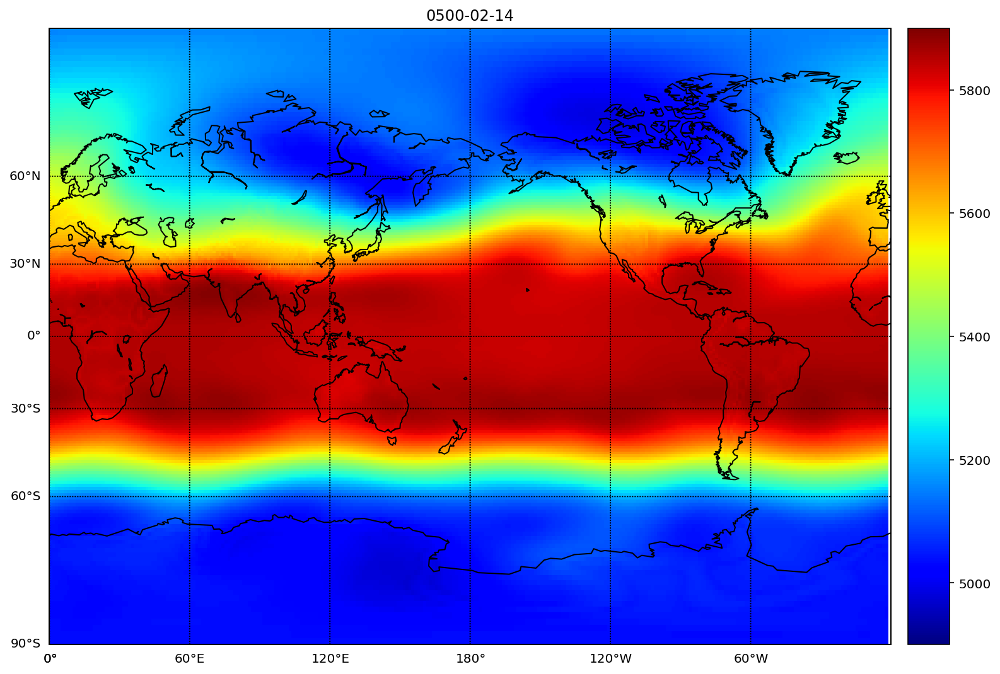

In [0]:
lats = gs_feb.variables['lat'][:]
lons = gs_feb.variables['lon'][:]
zg = gs_feb.variables['zg'][:]


plt.figure(figsize=(18,9))
m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
              llcrnrlon=0, urcrnrlon=360, resolution='c')

m.drawcoastlines()
m.drawmapboundary()
m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
m.drawmeridians(np.arange(0.,360., 60.),labels=[0,0,0,1])

x, y = m(*np.meshgrid(lons,lats))

m.pcolormesh(x,y,zg[499, :, :], shading='flat',cmap=plt.cm.jet, vmin = 4900, vmax = 5900)
m.colorbar(location='right', )
plt.title('0500-02-14')
# plt.savefig(str(i+1) + '_' + str(dates[i])+ '.png')

# New DataSet of analog year

In [0]:
feb_analog_1 =  gs_feb.sel(time = '0341-02-14')
feb_analog_2 =  gs_feb.sel(time = '1147-02-14')
feb_analog_3 =  gs_feb.sel(time = '0943-02-14')
feb_analog_4 =  gs_feb.sel(time = '0011-02-14')
feb_analog_5 =  gs_feb.sel(time = '0359-02-14')
feb_analog_6 =  gs_feb.sel(time = '0705-02-14')
feb_analog_7 =  gs_feb.sel(time = '0494-02-14')
feb_analog_8 =  gs_feb.sel(time = '0204-02-14')
feb_analog_9 =  gs_feb.sel(time = '0127-02-14')
feb_analog_10 =  gs_feb.sel(time = '0386-02-14')


feb_analog = xr.merge([feb_analog_1, feb_analog_2, feb_analog_3, feb_analog_4, feb_analog_5, feb_analog_6, feb_analog_7, feb_analog_8, feb_analog_9, feb_analog_10])
feb_analog

<xarray.Dataset>
Dimensions:    (lat: 192, lon: 288, nbnd: 2, time: 10)
Coordinates:
  * time       (time) object 0011-02-14 00:00:00 ... 1147-02-14 00:00:00
  * lat        (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 88.12 89.06 90.0
    lat_bnds   (lat, nbnd) float32 -90.0 -89.52879 -89.52879 ... 89.52879 90.0
  * lon        (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
    lon_bnds   (lon, nbnd) float32 -0.625 0.625 0.625 ... 358.125 359.375
    plev       float64 5e+04
    time_bnds  (time, nbnd) object 0011-02-01 00:00:00 ... 1147-03-01 00:00:00
Dimensions without coordinates: nbnd
Data variables:
    zg         (time, lat, lon) float32 5058.7983 5058.7983 ... 5095.906

# Calculating RMSE with respect to target year Feb(0500-02) and arranging them in order

In [0]:
rms = []

for i in range(10):
  err = 0
  err_1 = (gs_feb.zg[499, :, :] - feb_analog.zg[i, :, :])**2
  err_total = err_1.sum()
  err = ((err_total/(192*288))**(1/2))
  rms.append(err)

a = sorted(range(len(rms)), key=lambda i: rms[i])[:10]

dates = [datetime.datetime.strptime(str(feb_analog.time[a[i]].values),"%Y-%m-%d %H:%M:%S").date() for i in range(10)] 

for i in range(10):
  print(str(i+1) +' Root mean Square Error of ' + str(dates[i]) + ': ' + str(rms[a[i]].values))

# Plotting February Analog(Analog Year of January)

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06ee0a50f0>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06ee0a5470>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06ee0a5748>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06ee0a5a58>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06ee0a5d68>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ee3c40b8>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06ee3c42e8>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ee3cb748>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06ee3cb7b8>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06ee3cbac8>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06ee3cbdd8>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06ee3d2128>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06ee3d2438>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0127-02-14, RMSE Value: 57.82053372609397')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06ee5dc0b8>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06ee5dc438>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06ee5dc710>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06ee5dca20>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06ee5dcd30>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ee5e4080>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06ee5e42b0>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ee57c710>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06ee57c780>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06ee57ca90>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06ee57cda0>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06ee5880f0>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06ee588400>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '1147-02-14, RMSE Value: 62.426591148383295')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06edee5048>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06edee5400>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06edee56d8>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06edee59e8>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06edee5cf8>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06edef0048>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06edef0278>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06edc556d8>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06edc55748>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06edc55a58>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06edc55d68>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06edc3a0b8>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06edc3a3c8>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0359-02-14, RMSE Value: 67.14848027154284')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06ee4d1048>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06ee4d13c8>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06ee4d16a0>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06ee4d19b0>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06ee4d1cc0>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ee4d1fd0>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06ee4d4240>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ee4e46a0>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06ee4e4710>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06ee4e4a20>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06ee4e4d30>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06ee4ff080>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06ee4ff390>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0204-02-14, RMSE Value: 67.72343421347345')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06ee00efd0>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06ee397390>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06ee397668>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06ee397978>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06ee397c88>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ee397f98>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06ee39a208>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ee3a7668>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06ee3a76d8>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06ee3a79e8>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06ee3a7cf8>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06ee3b2048>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06ee3b2358>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0494-02-14, RMSE Value: 71.46760143978217')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06edb25f98>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06edb38358>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06edb38630>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06edb38940>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06edb38c50>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06edb38f60>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06ede7a1d0>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06edeaf630>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06edeaf6a0>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06edeaf9b0>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06edeafcc0>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06edeaffd0>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06edea1320>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0705-02-14, RMSE Value: 76.63850252610919')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06ede74f60>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06ede71320>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06ede715f8>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06ede71908>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06ede71c18>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ede71f28>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06ede3d198>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ede655f8>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06ede65668>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06ede65978>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06ede65c88>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06ede65f98>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06ede6b2e8>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0386-02-14, RMSE Value: 79.41065472172694')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06edd72f28>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06edd482e8>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06edd485c0>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06edd488d0>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06edd48be0>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06edd48ef0>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06edd5f160>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06edd415c0>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06edd41630>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06edd41940>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06edd41c50>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06edd41f60>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06edfc42b0>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0943-02-14, RMSE Value: 82.11131784668005')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06edf3eef0>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06edf592b0>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06edf59588>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06edf59898>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06edf59ba8>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06edf59eb8>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06ede0a128>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ede2d588>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06ede2d5f8>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06ede2d908>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06ede2dc18>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06ede2df28>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06ede0c278>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0341-02-14, RMSE Value: 82.94354673176476')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06edf3aeb8>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06ee2c0278>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06ee2c0550>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06ee2c0860>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06ee2c0b70>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ee2c0e80>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06ee2cf080>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ee2ed550>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06ee2ed5c0>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06ee2ed8d0>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06ee2edbe0>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06ee2edef0>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06ee2ea240>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0011-02-14, RMSE Value: 83.87192617318384')

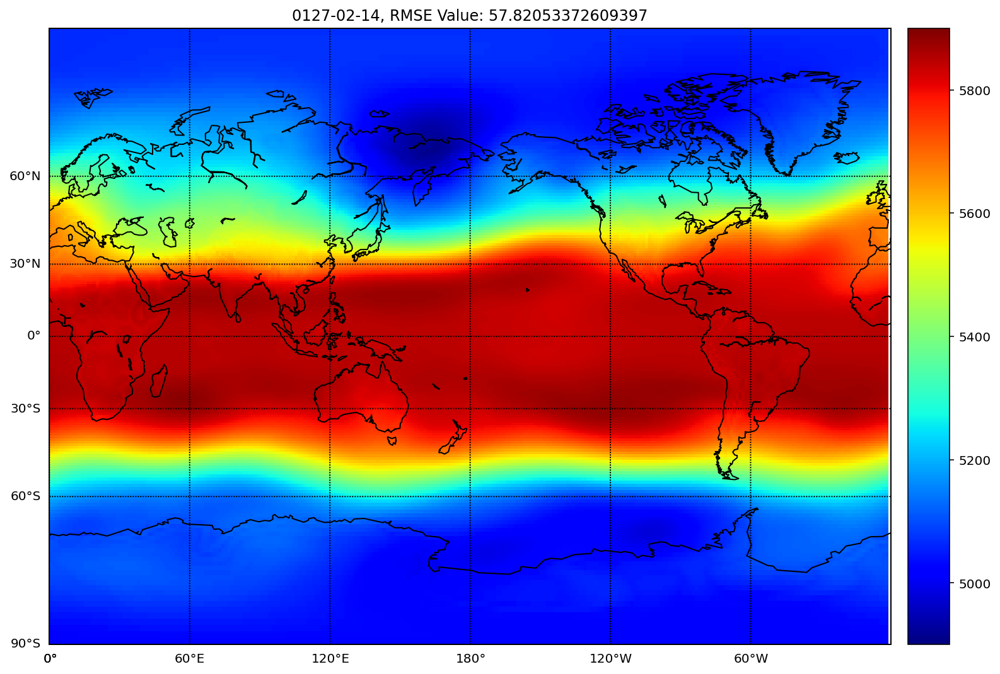

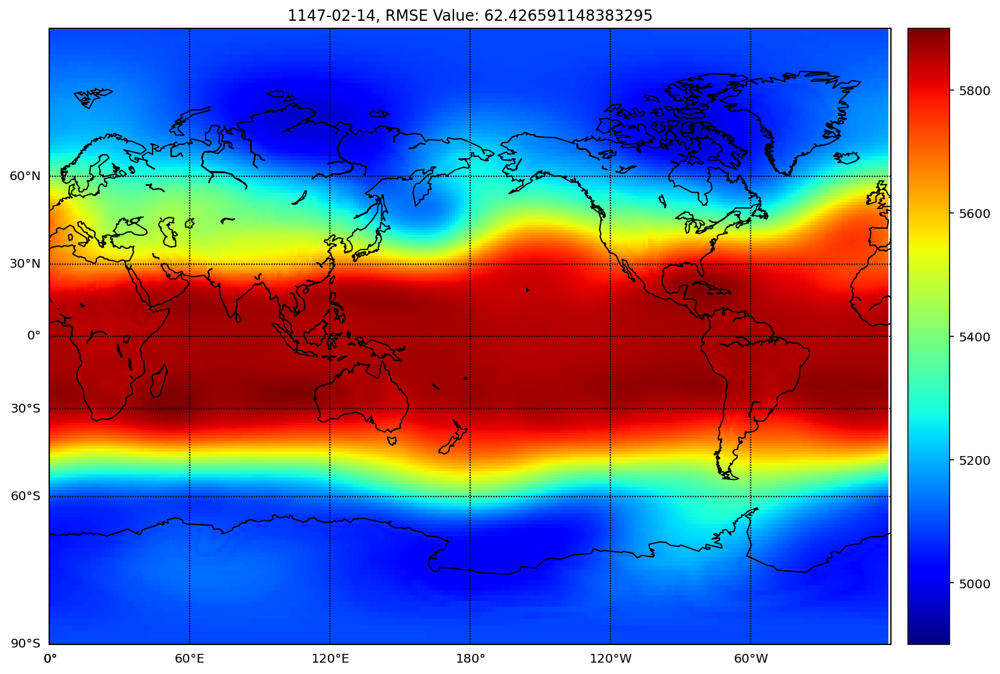

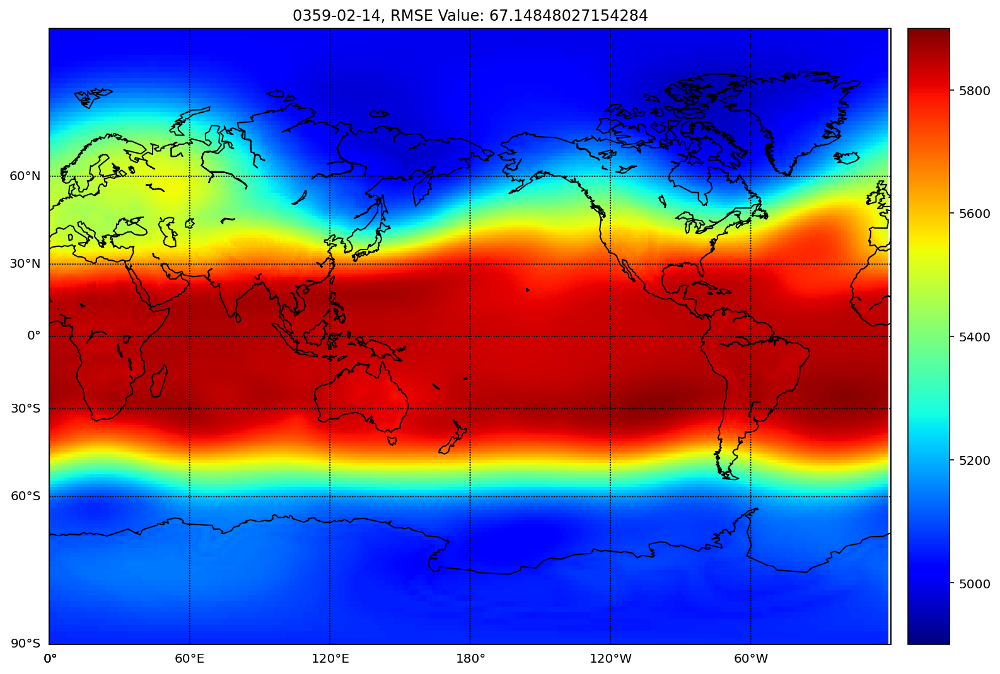

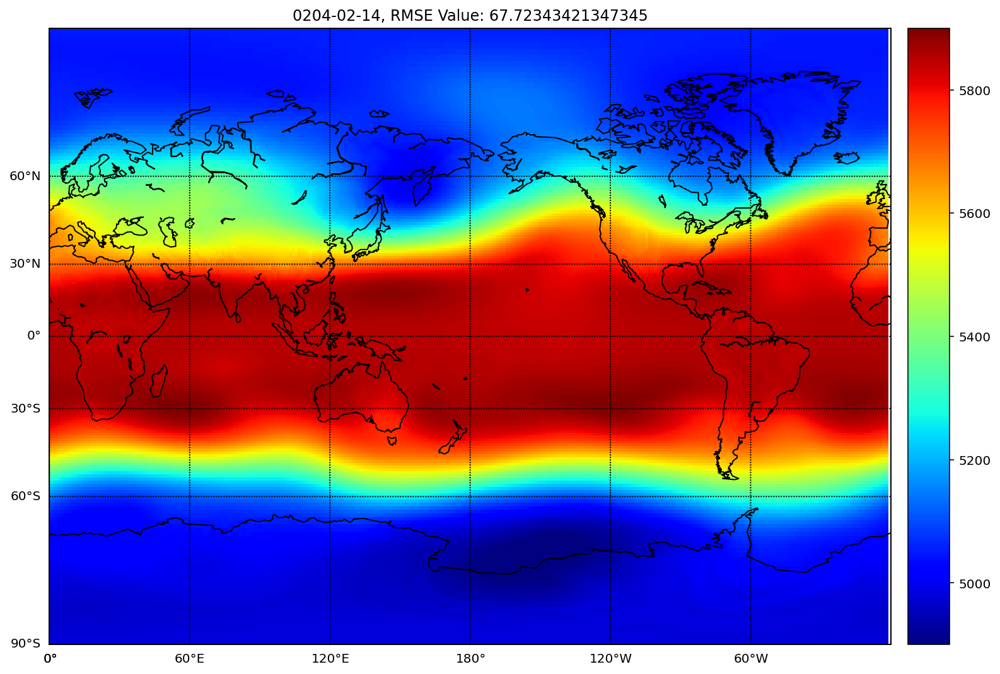

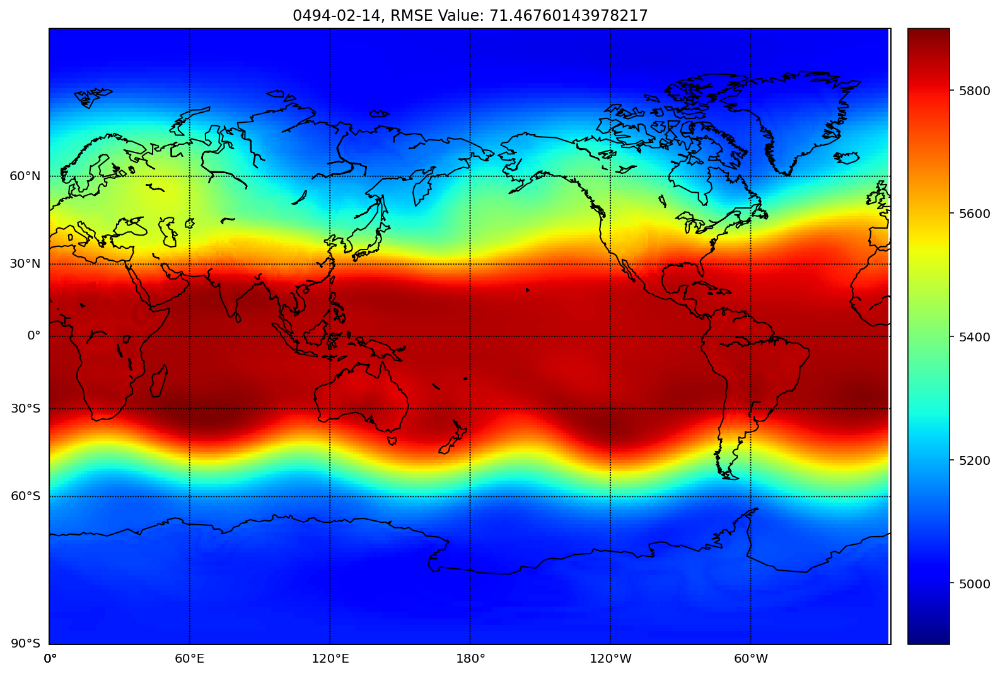

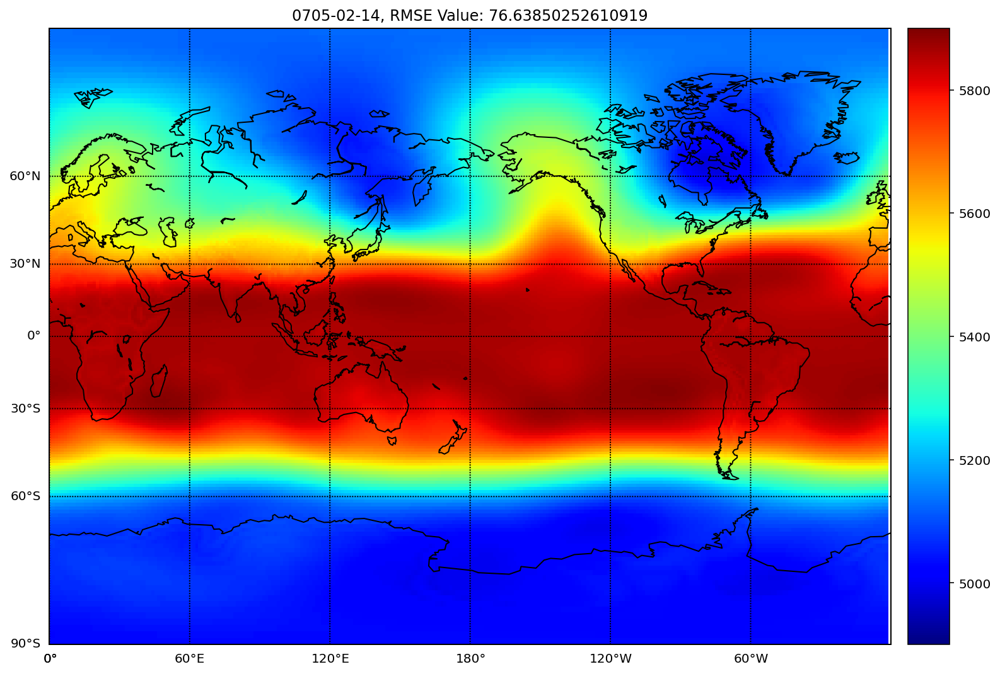

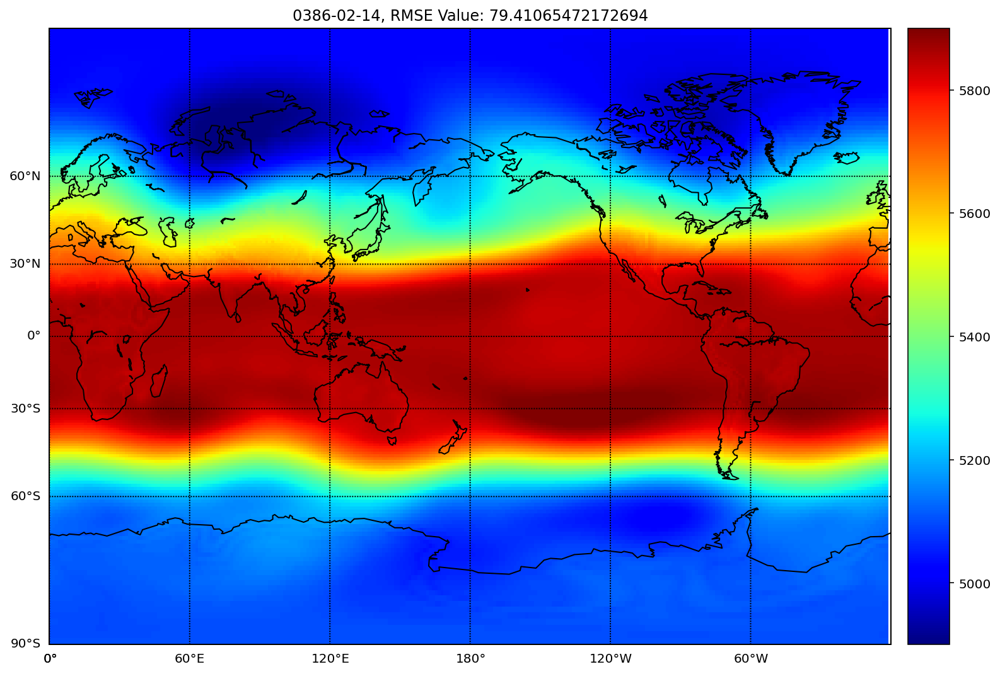

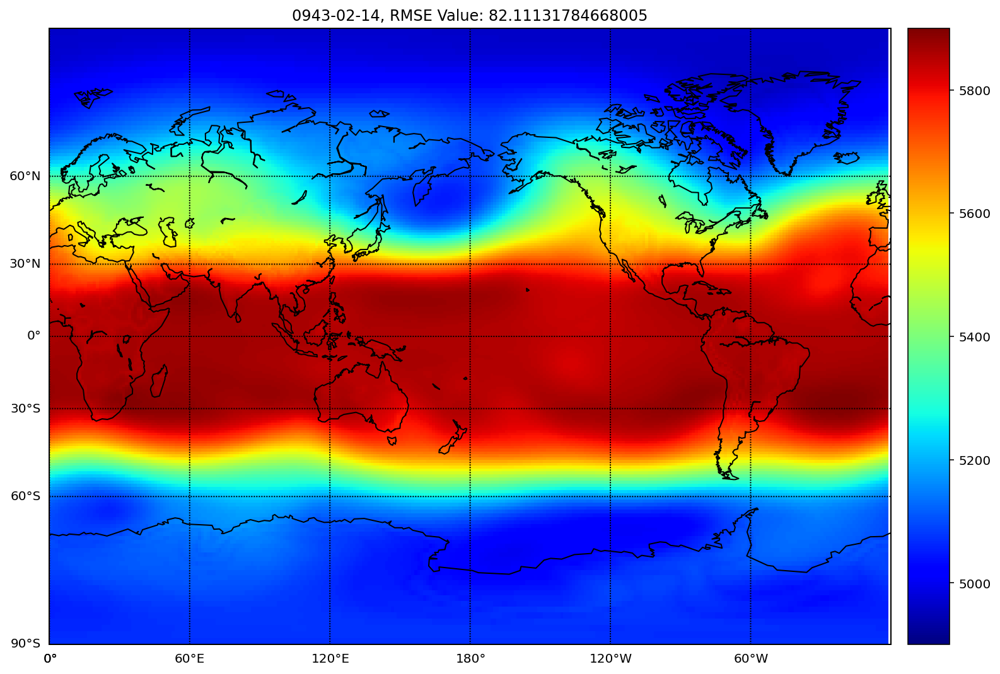

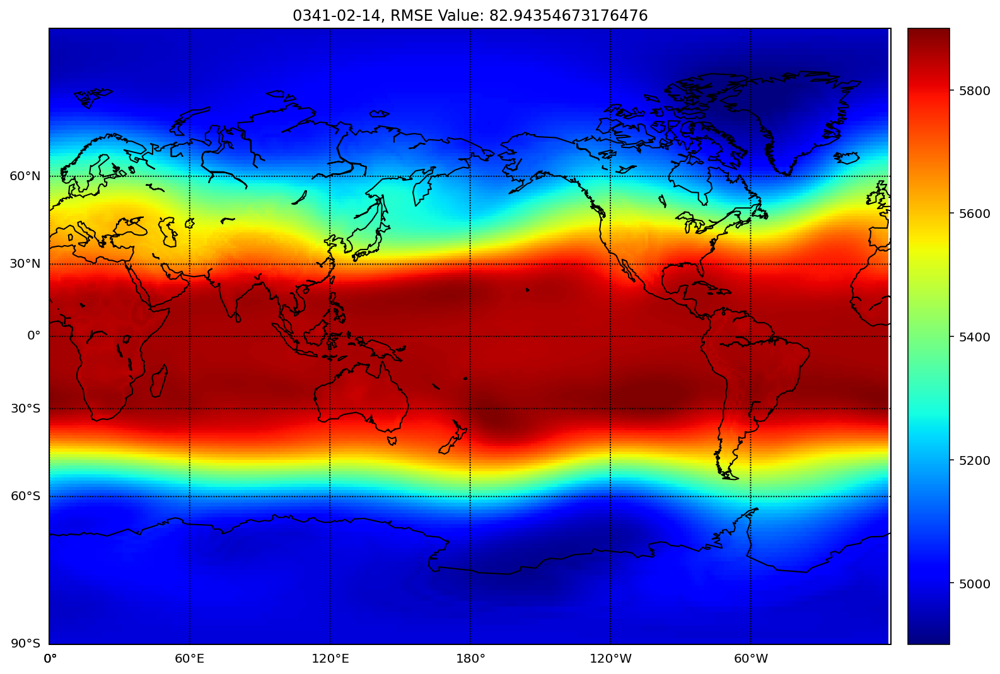

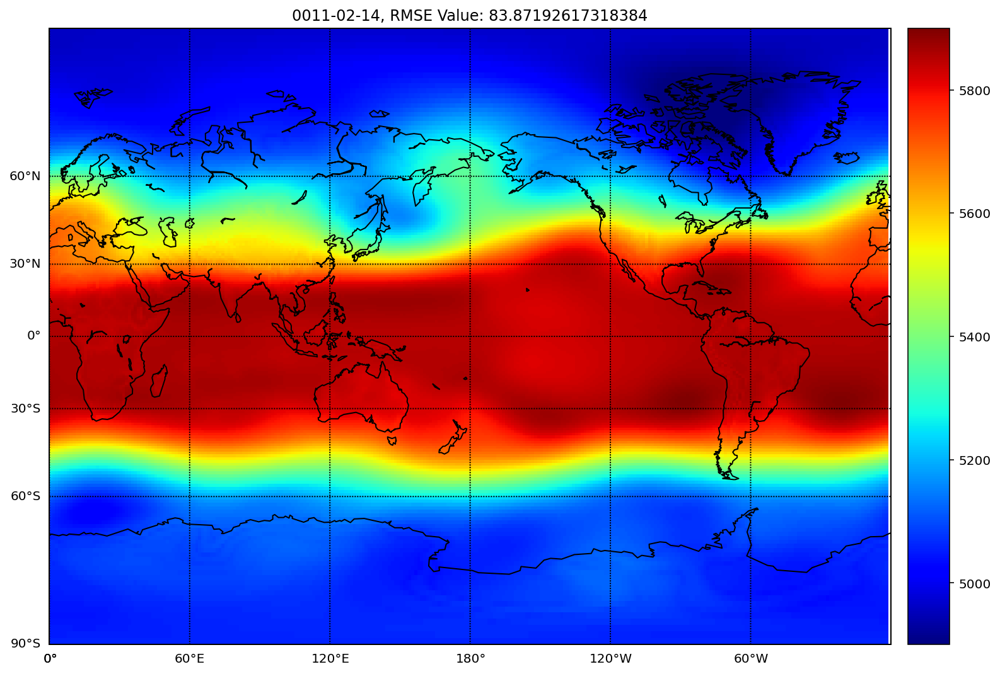

In [0]:
lats = feb_analog.variables['lat'][:]
lons = feb_analog.variables['lon'][:]
zg = feb_analog.variables['zg'][:]

for i in range(10):
  plt.figure(figsize=(18,9))
  m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
                llcrnrlon=0, urcrnrlon=360, resolution='c')

  m.drawcoastlines()
  m.drawmapboundary()
  m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
  m.drawmeridians(np.arange(0.,360., 60.),labels=[0,0,0,1])

  x, y = m(*np.meshgrid(lons,lats))

  m.pcolormesh(x,y,zg[a[i], :, :], shading='flat',cmap=plt.cm.jet, vmin = 4900 , vmax = 5900)
  m.colorbar(location='right', )
  plt.title(str(dates[i]) + ', RMSE Value: '+ str(rms[a[i]].values))
  # plt.savefig(str(i+1) + '_' + str(dates[i])+ '.png')

# Mean and STD of February

In [0]:
gs_feb_mean = gs_feb.groupby('time.month').mean()
gs_feb_std = gs_feb.groupby('time.month').std()
gs_feb_mean.zg

<xarray.DataArray 'zg' (month: 1, lat: 192, lon: 288)>
array([[[5038.0845, 5038.0845, 5038.0845, ..., 5038.0845, 5038.0845,
         5038.0845],
        [5036.6523, 5036.7144, 5036.792 , ..., 5036.4834, 5036.5337,
         5036.5933],
        [5037.0005, 5036.905 , 5036.8105, ..., 5037.2886, 5037.1924,
         5037.092 ],
        ...,
        [5056.5576, 5056.6123, 5056.664 , ..., 5056.3965, 5056.4424,
         5056.4976],
        [5057.8965, 5057.8936, 5057.8965, ..., 5057.9004, 5057.897 ,
         5057.8955],
        [5060.3   , 5060.3   , 5060.3   , ..., 5060.3   , 5060.3   ,
         5060.3   ]]], dtype=float32)
Coordinates:
    plev     float64 5e+04
  * lat      (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 87.17 88.12 89.06 90.0
  * lon      (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
  * month    (month) int64 2

# Calculating RMSE of Feb Mean with respect to target year Feb(0500-02)

In [0]:
err = 0
err_1 = (gs_feb.zg[499, :, :] - gs_feb_mean.zg[0, :, :])**2
err_total = err_1.sum()
err = ((err_total/(192*288))**(1/2))
err

<xarray.DataArray 'zg' ()>
array(60.95359118)
Coordinates:
    plev     float64 5e+04
    time     object 0500-02-14 00:00:00
    month    int64 2

# Plotting Mean of Feb

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06f15be470>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06f15bebe0>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06f15beb00>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06f15be9b0>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06f3ac8cc0>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06f3c91630>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06f3c91048>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ee6a7940>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06edf3c0b8>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06edf3c780>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06edf3cc50>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06edf3c550>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06edf3c278>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '1200 Feb Mean, RMSE Value: 60.95359118032159')

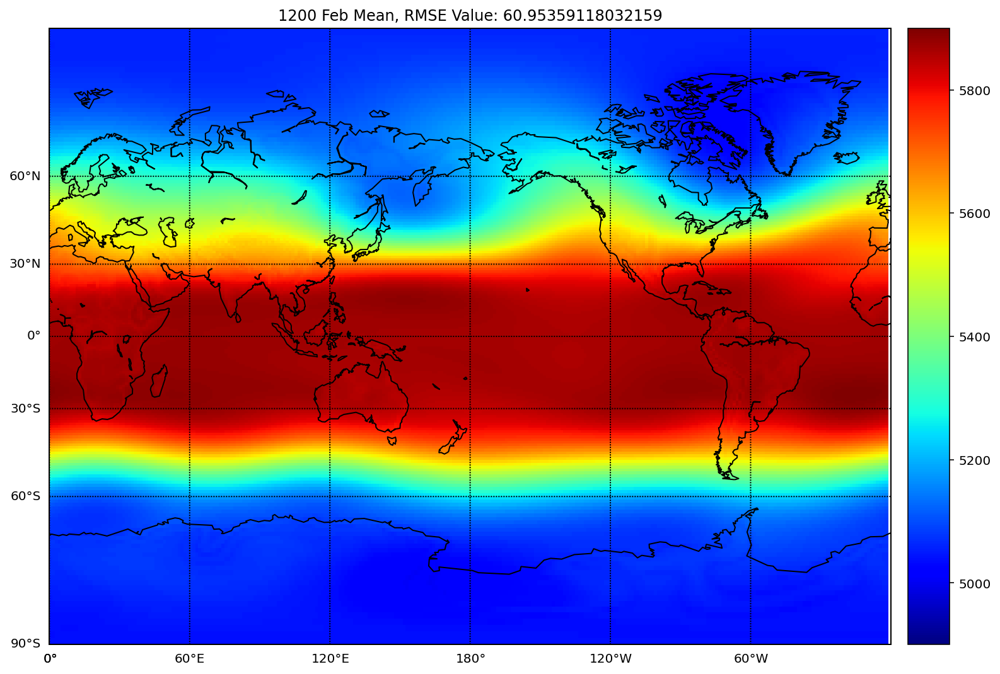

In [0]:
lats = gs_feb_mean.variables['lat'][:]
lons = gs_feb_mean.variables['lon'][:]
zg = gs_feb_mean.variables['zg'][:]

plt.figure(figsize=(18,9))
m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
                llcrnrlon=0, urcrnrlon=360, resolution='c', lon_0=0)

m.drawcoastlines()
m.drawmapboundary()
m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
m.drawmeridians(np.arange(-180.,180.,60.),labels=[0,0,0,1])

x, y = m(*np.meshgrid(lons,lats))

m.pcolormesh(x,y,zg[0, :, :], shading='flat',cmap=plt.cm.jet, vmin = 4900 , vmax = 5900)
m.colorbar(location='right')
plt.title("1200 Feb Mean, RMSE Value: " + str(err.values))

# Plotting STD of February

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06f3fa77f0>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06f3fa7898>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06f3fa7358>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06f7f6d828>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06f7f6d0b8>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06f7f6dd30>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06f7f6d240>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06f11888d0>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06f11aa860>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06f11aa358>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06f11aa160>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06f11aae48>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06f11aaf60>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, 'STD of February')

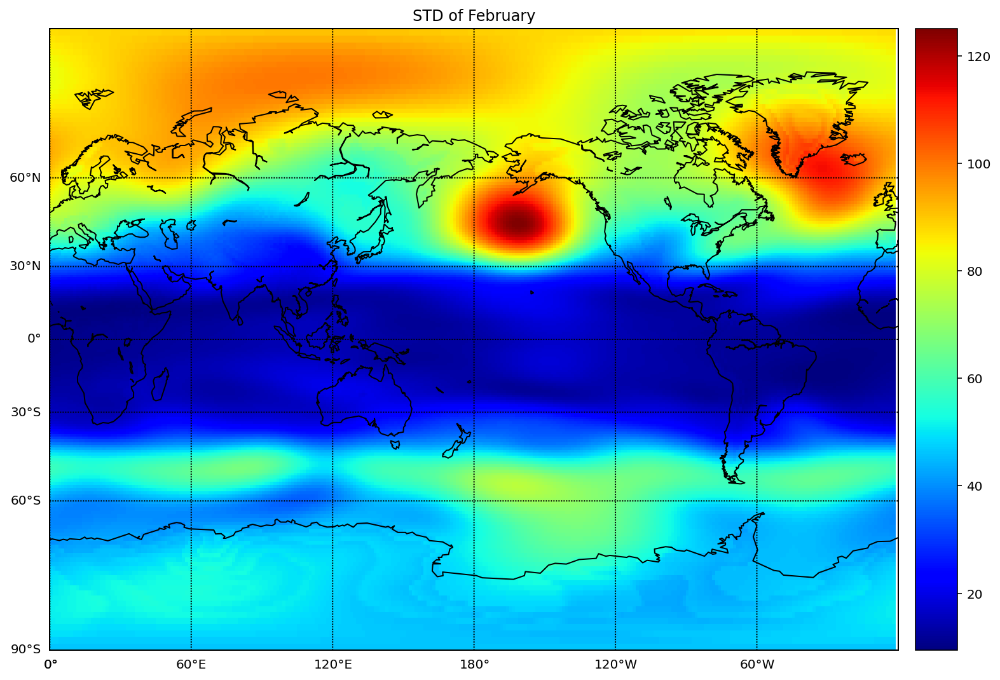

In [0]:
lats = gs_feb_std.variables['lat'][:]
lons = gs_feb_std.variables['lon'][:]
zg = gs_feb_std.variables['zg'][:]

plt.figure(figsize=(18,9))
m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
                llcrnrlon=0, urcrnrlon=360, resolution='c', lon_0=0)

m.drawcoastlines()
m.drawmapboundary()
m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
m.drawmeridians(np.arange(-180.,180.,60.),labels=[0,0,0,1])

x, y = m(*np.meshgrid(lons,lats))

m.pcolormesh(x,y,zg[0, :, :], shading='flat',cmap=plt.cm.jet)
m.colorbar(location='right')
plt.title("STD of February")

# Mean of Analog Year of Feb

In [0]:
feb_analog_mean = feb_analog.mean(dim = 'time')
feb_analog_mean

<xarray.Dataset>
Dimensions:   (lat: 192, lon: 288, nbnd: 2)
Coordinates:
  * lat       (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 88.12 89.06 90.0
    lat_bnds  (lat, nbnd) float32 -90.0 -89.52879 -89.52879 ... 89.52879 90.0
  * lon       (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
    lon_bnds  (lon, nbnd) float32 -0.625 0.625 0.625 ... 358.125 358.125 359.375
    plev      float64 5e+04
Dimensions without coordinates: nbnd
Data variables:
    zg        (lat, lon) float32 5044.7383 5044.7383 ... 5026.3706 5026.3706

# Calculating RMSE of Mean of Analogs with respect to target year Feb(0500-02) 

In [0]:
err = 0
err_1 = (gs_feb.zg[499, :, :] - feb_analog_mean.zg[:, :])**2
err_total = err_1.sum()
err = ((err_total/(192*288))**(1/2))
err

<xarray.DataArray 'zg' ()>
array(58.05835985)
Coordinates:
    plev     float64 5e+04
    time     object 0500-02-14 00:00:00

# Plotting Mean of Analogs of February

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06f7f71b38>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06fddec710>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06f1b583c8>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06f1b58be0>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06f1b58f98>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06f1b58f28>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06f400f8d0>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06f3fbc198>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06fb85a470>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06f3d64eb8>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06f1adf0f0>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06f12178d0>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06f1217f28>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, 'Feb Analog Mean, RMSE value: 58.05835984721019')

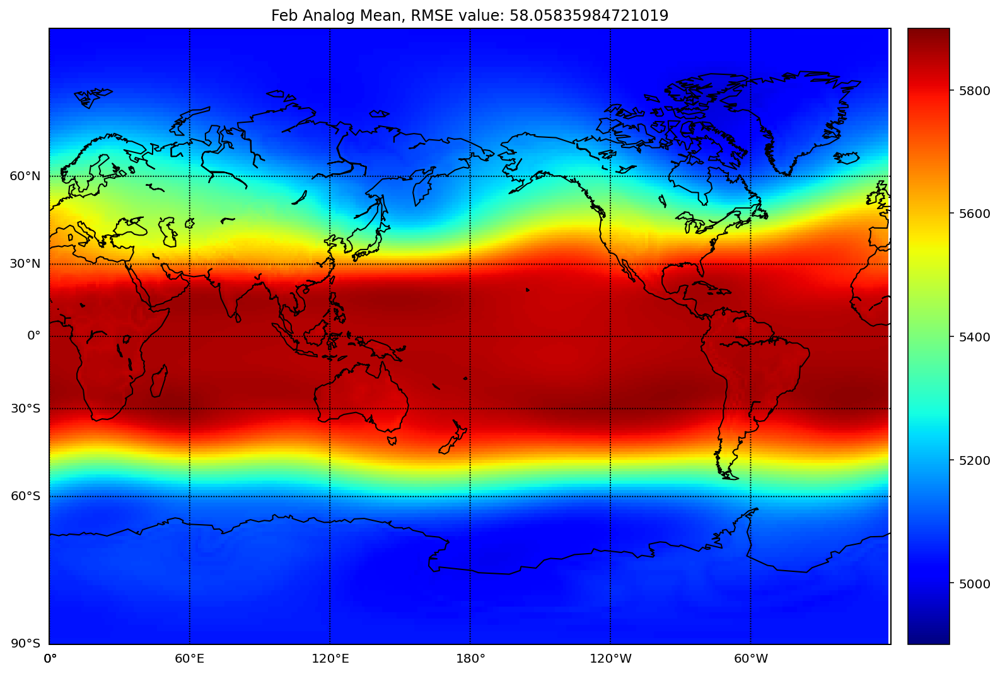

In [0]:
lats = feb_analog_mean.variables['lat'][:]
lons = feb_analog_mean.variables['lon'][:]
zg = feb_analog_mean.variables['zg'][:]

plt.figure(figsize=(18,9))
m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
                llcrnrlon=0, urcrnrlon=360, resolution='c', lon_0=0)

m.drawcoastlines()
m.drawmapboundary()
m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
m.drawmeridians(np.arange(-180.,180.,60.),labels=[0,0,0,1])

x, y = m(*np.meshgrid(lons,lats))

m.pcolormesh(x,y,zg[:, :], shading='flat',cmap=plt.cm.jet, vmin = 4900 , vmax = 5900)
m.colorbar(location='right')
plt.title("Feb Analog Mean, RMSE value: " + str(err.values))

# February Persistence

In [0]:
feb_persistence_1 =  jan_monthly_anomalies.sel(time = '0500-01-15')
feb_persistence = (feb_persistence_1.zg[0] * gs_feb_std.zg[0]) + gs_feb_mean.zg[0]
feb_persistence

<xarray.DataArray 'zg' (lat: 192, lon: 288, month: 1)>
array([[[4977.451 ],
        [4977.451 ],
        [4977.451 ],
        ...,
        [4977.451 ],
        [4977.451 ],
        [4977.451 ]],

       [[4977.2163],
        [4977.4434],
        [4977.6753],
        ...,
        [4976.484 ],
        [4976.7344],
        [4976.9893]],

       [[4975.4014],
        [4975.4146],
        [4975.4424],
        ...,
        [4975.4243],
        [4975.4106],
        [4975.394 ]],

       ...,

       [[5099.047 ],
        [5099.329 ],
        [5099.601 ],
        ...,
        [5098.226 ],
        [5098.493 ],
        [5098.766 ]],

       [[5099.849 ],
        [5099.982 ],
        [5100.104 ],
        ...,
        [5099.4688],
        [5099.591 ],
        [5099.719 ]],

       [[5099.4673],
        [5099.4673],
        [5099.4673],
        ...,
        [5099.4673],
        [5099.4673],
        [5099.4673]]], dtype=float32)
Coordinates:
  * month    (month) int64 1
    plev     float64 5e+04
  * lat      (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 87.17 88.12 89.06 90.0
  * lon      (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
    time     object 0500-01-15 12:00:00

# Calculating RMSE of Persistence with respect to target year Feb(0500-02)

In [0]:
err = 0
err_1 = (gs_feb.zg[499, :, :] - feb_persistence)**2
err_total = err_1.sum()
err = ((err_total/(192*288))**(1/2))
err

<xarray.DataArray 'zg' ()>
array(64.94770867)
Coordinates:
    plev     float64 5e+04

# Plotting Persistence

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06f1295ac8>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06f1295080>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06f7fa2f98>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06f7fa2630>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06f7fa22e8>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06f3e49668>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06ee61ca90>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06f41aa828>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06f41aa860>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06f41aad30>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06f41aae10>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06ee78e048>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06ee78e748>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, 'Feb Persistence , RMSE Value: 64.94770866713553')

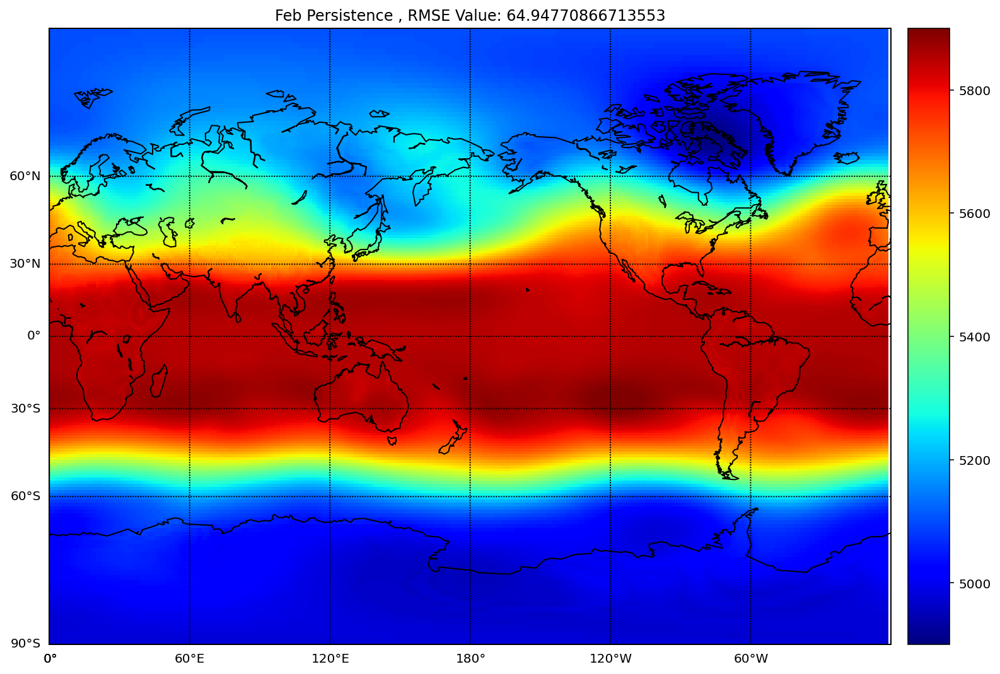

In [0]:
lats = feb_persistence['lat'][:]
lons = feb_persistence['lon'][:]
zg = feb_persistence[:]

plt.figure(figsize=(18,9))
m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
                llcrnrlon=0, urcrnrlon=360, resolution='c', lon_0=0)

m.drawcoastlines()
m.drawmapboundary()
m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
m.drawmeridians(np.arange(-180.,180.,60.),labels=[0,0,0,1])

x, y = m(*np.meshgrid(lons,lats))

m.pcolormesh(x,y,zg[:, :, 0], shading='flat',cmap=plt.cm.jet, vmin = 4900 , vmax = 5900)
m.colorbar(location='right')
plt.title("Feb Persistence , RMSE Value: " + str(err.values))

# Calculating Monthly Anomalies of Feb

In [0]:
feb_monthly_anomalies = (gs_feb.groupby('time.month') - gs_feb.groupby('time.month').mean())/gs_feb.groupby('time.month').std()
feb_monthly_anomalies

<xarray.Dataset>
Dimensions:    (lat: 192, lon: 288, month: 1, nbnd: 2, time: 1200)
Coordinates:
    lat_bnds   (lat, nbnd) float32 -90.0 -89.52879 -89.52879 ... 89.52879 90.0
  * month      (month) int64 2
    lon_bnds   (lon, nbnd) float32 -0.625 0.625 0.625 ... 358.125 359.375
    plev       float64 5e+04
  * lat        (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 88.12 89.06 90.0
  * lon        (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
  * time       (time) object 0001-02-14 00:00:00 ... 1200-02-14 00:00:00
    time_bnds  (time, nbnd) object 0001-02-01 00:00:00 ... 1200-03-01 00:00:00
Dimensions without coordinates: nbnd
Data variables:
    zg         (time, lat, lon, month) float32 -0.464782 ... 0.57966137

# Plotting Target Year Feb Anomalie(0500-02)  

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06f3b47978>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06f3b47518>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06f3b47630>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06f0f0d7b8>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06f0f0ddd8>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06f0f0d518>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06f0f0dac8>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06f1c93d30>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06f1c934a8>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06f1c93780>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06edd080f0>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06f1591630>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06f1591d68>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0500-02-14')

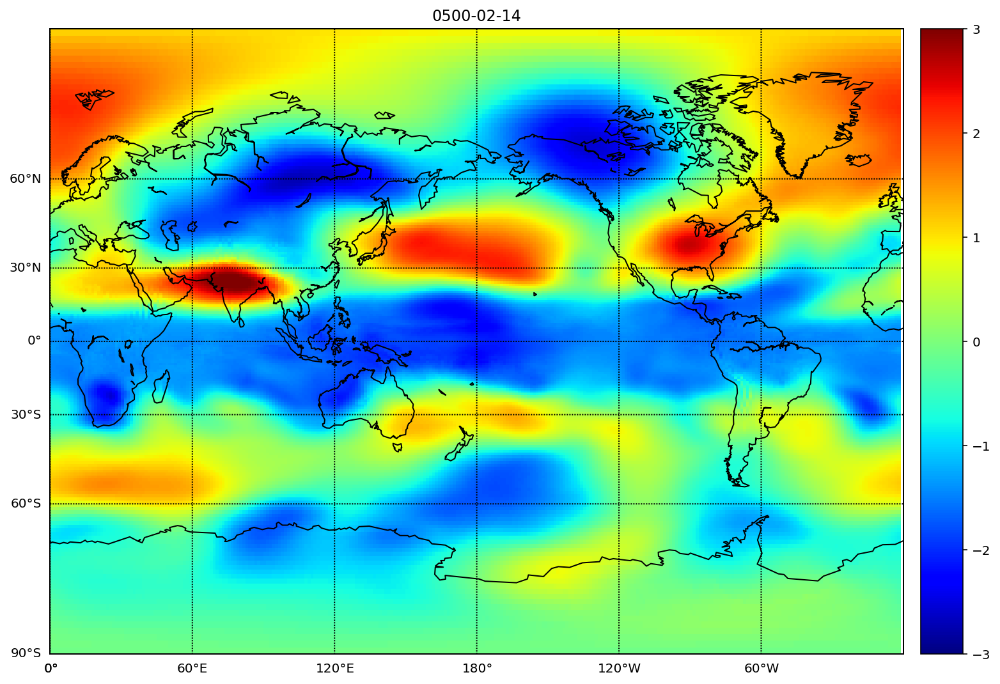

In [0]:
lats = feb_monthly_anomalies.variables['lat'][:]
lons = feb_monthly_anomalies.variables['lon'][:]
zg = feb_monthly_anomalies.variables['zg'][:]


plt.figure(figsize=(18,9))
m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
              llcrnrlon=0, urcrnrlon=360, resolution='c')

m.drawcoastlines()
m.drawmapboundary()
m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
m.drawmeridians(np.arange(0.,360., 60.),labels=[0,0,0,1])

x, y = m(*np.meshgrid(lons,lats))

m.pcolormesh(x,y,zg[499, :, :, 0], shading='flat',cmap=plt.cm.jet, vmin = -3, vmax = 3)
m.colorbar(location='right', )
plt.title('0500-02-14')
# plt.savefig(str(i+1) + '_' + str(dates[i])+ '.png')

# Making new dataset of Analog Year Anomalie

In [0]:
feb_analog_1 =  feb_monthly_anomalies.sel(time = '0341-02-14')
feb_analog_2 =  feb_monthly_anomalies.sel(time = '1147-02-14')
feb_analog_3 =  feb_monthly_anomalies.sel(time = '0943-02-14')
feb_analog_4 =  feb_monthly_anomalies.sel(time = '0011-02-14')
feb_analog_5 =  feb_monthly_anomalies.sel(time = '0359-02-14')
feb_analog_6 =  feb_monthly_anomalies.sel(time = '0705-02-14')
feb_analog_7 =  feb_monthly_anomalies.sel(time = '0494-02-14')
feb_analog_8 =  feb_monthly_anomalies.sel(time = '0204-02-14')
feb_analog_9 =  feb_monthly_anomalies.sel(time = '0127-02-14')
feb_analog_10 =  feb_monthly_anomalies.sel(time = '0386-02-14')


feb_analog = xr.merge([feb_analog_1, feb_analog_2, feb_analog_3, feb_analog_4, feb_analog_5, feb_analog_6, feb_analog_7, feb_analog_8, feb_analog_9, feb_analog_10])
feb_analog

<xarray.Dataset>
Dimensions:    (lat: 192, lon: 288, month: 1, nbnd: 2, time: 10)
Coordinates:
  * time       (time) object 0011-02-14 00:00:00 ... 1147-02-14 00:00:00
    lat_bnds   (lat, nbnd) float32 -90.0 -89.52879 -89.52879 ... 89.52879 90.0
  * month      (month) int64 2
    lon_bnds   (lon, nbnd) float32 -0.625 0.625 0.625 ... 358.125 359.375
    plev       float64 5e+04
  * lat        (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 88.12 89.06 90.0
  * lon        (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
    time_bnds  (time, nbnd) object 0011-02-01 00:00:00 ... 1147-03-01 00:00:00
Dimensions without coordinates: nbnd
Data variables:
    zg         (time, lat, lon, month) float32 0.448317 0.448317 ... 0.4024592

# Calculating RMSE with respect to target year Feb(0500-02) and arranging them in order

In [0]:
rms = []

for i in range(10):
  err = 0
  err_1 = (feb_monthly_anomalies.zg[499, :, :] - feb_analog.zg[i, :, :])**2
  err_total = err_1.sum()
  err = ((err_total/(192*288))**(1/2))
  rms.append(err)

a = sorted(range(len(rms)), key=lambda i: rms[i])[:10]

dates = [datetime.datetime.strptime(str(feb_analog.time[a[i]].values),"%Y-%m-%d %H:%M:%S").date() for i in range(10)] 

for i in range(10):
  print(str(i+1) +' Root mean Square Error of ' + str(dates[i]) + ': ' + str(rms[a[i]].values))

1 Root mean Square Error of 0127-02-14: 1.0230083865576052
2 Root mean Square Error of 0359-02-14: 1.0973590062721301
3 Root mean Square Error of 0494-02-14: 1.1548982495114177
4 Root mean Square Error of 0204-02-14: 1.1615920738232364
5 Root mean Square Error of 0705-02-14: 1.273798251133991
6 Root mean Square Error of 1147-02-14: 1.2887295927798694
7 Root mean Square Error of 0011-02-14: 1.3030720529998503
8 Root mean Square Error of 0943-02-14: 1.3134614628718682
9 Root mean Square Error of 0341-02-14: 1.3495320622419285
10 Root mean Square Error of 0386-02-14: 1.3556628707625413


# Plotting Analog Year Anomalie

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06ee11bdd8>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06ee6cc198>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06ee6cc470>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06ee6cc780>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06ee6cca90>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ee6ccda0>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06ee6ccf98>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06edce3048>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06edce34e0>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06edce37f0>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06edce3b00>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06edce3e10>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06edae8160>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0127-02-14, RMSE Value: 1.0230083865576052')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06ee556da0>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06ee547160>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06ee547438>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06ee547748>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06ee547a58>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ee547d68>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06ee547f28>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06edb481d0>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06edb484a8>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06edb487b8>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06edb48ac8>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06edb48dd8>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06edb43128>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0359-02-14, RMSE Value: 1.0973590062721301')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06ee497d68>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06ee488128>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06ee488400>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06ee488710>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06ee488a20>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ee488d30>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06ee488f60>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ee4b2198>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06ee4b2470>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06ee4b2780>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06ee4b2a90>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06ee4b2da0>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06ee0160f0>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0494-02-14, RMSE Value: 1.1548982495114177')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06edf9cd30>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06edfa30f0>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06edfa33c8>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06edfa36d8>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06edfa39e8>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06edfa3cf8>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06edfa3f28>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ede22160>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06ede22438>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06ede22748>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06ede22a58>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06ede22d68>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06ede0f0b8>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0204-02-14, RMSE Value: 1.1615920738232364')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06ee441cf8>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06ee4670b8>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06ee467390>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06ee4676a0>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06ee4679b0>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ee467cc0>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06ee467ef0>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06edee1320>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06edee1400>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06edee1710>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06edee1a20>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06edee1d30>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06ededa080>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0705-02-14, RMSE Value: 1.273798251133991')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06ee391cc0>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06ee3ac080>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06ee3ac358>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06ee3ac668>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06ee3ac978>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ee3acc88>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06ee3aceb8>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06edda00f0>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06edda03c8>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06edda06d8>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06edda09e8>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06edda0cf8>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06eddb6080>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '1147-02-14, RMSE Value: 1.2887295927798694')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06ed854c88>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06ed854f98>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06ed85b320>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06ed85b630>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06ed85b940>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ed85bc50>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06ed85be80>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ed8750b8>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06ed8753c8>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06ed8756a0>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06ed8759b0>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06ed875cc0>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06ed875fd0>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0011-02-14, RMSE Value: 1.3030720529998503')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06ed7d3c50>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06ed7d3fd0>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06ed7e12e8>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06ed7e15f8>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06ed7e1908>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ed7e1c18>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06ed7e1e48>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ed7f7080>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06ed7f7358>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06ed7f7668>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06ed7f7978>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06ed7f7c88>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06ed7f7f98>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0943-02-14, RMSE Value: 1.3134614628718682')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06ed727c18>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06ed727f98>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06ed72e2b0>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06ed72e5c0>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06ed72e8d0>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ed72ebe0>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06ed72ee10>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ed72ee80>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06ed790358>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06ed790630>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06ed790940>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06ed790c50>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06ed790f60>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0341-02-14, RMSE Value: 1.3495320622419285')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06ed667be0>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06ed667f60>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06ed66d278>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06ed66d588>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06ed66d898>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ed66dba8>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06ed66ddd8>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ed6bbfd0>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06ed6c82e8>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06ed6c85f8>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06ed6c8908>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06ed6c8c18>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06ed6c8f28>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0386-02-14, RMSE Value: 1.3556628707625413')

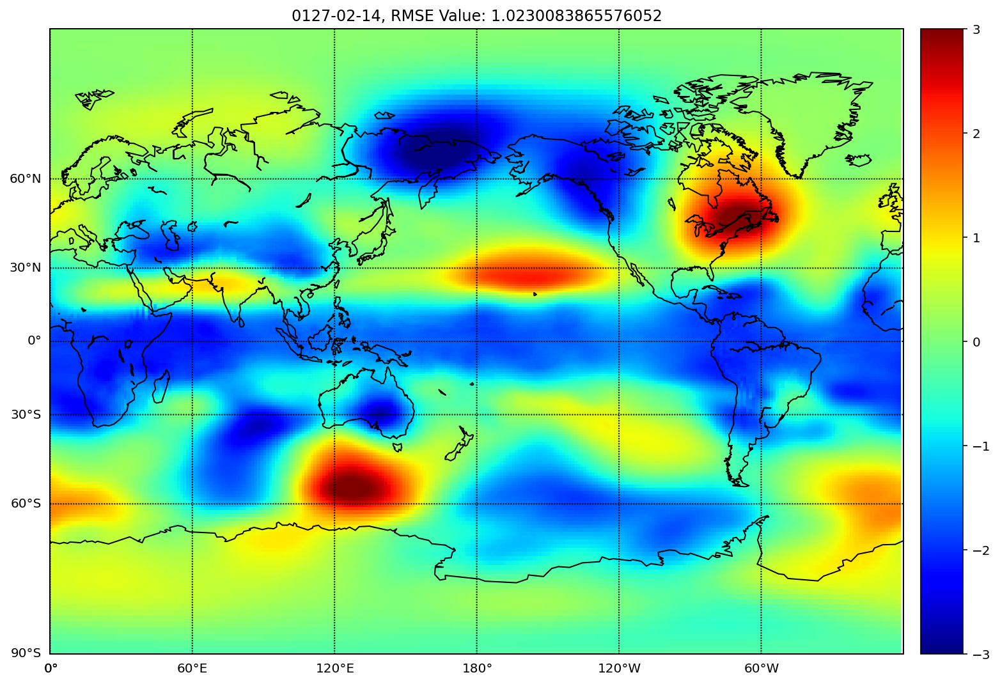

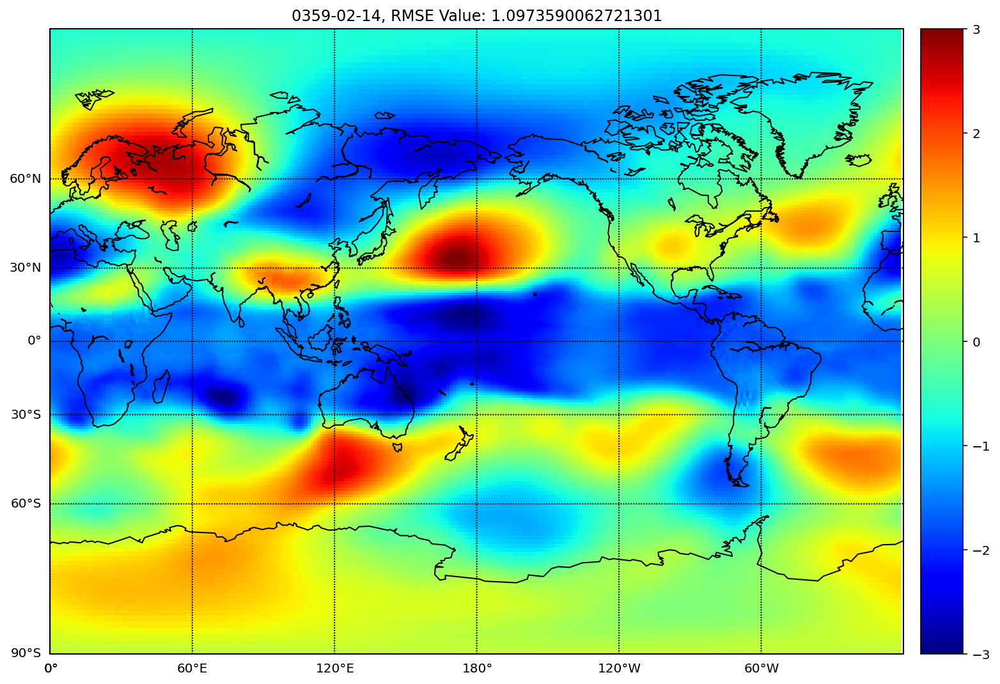

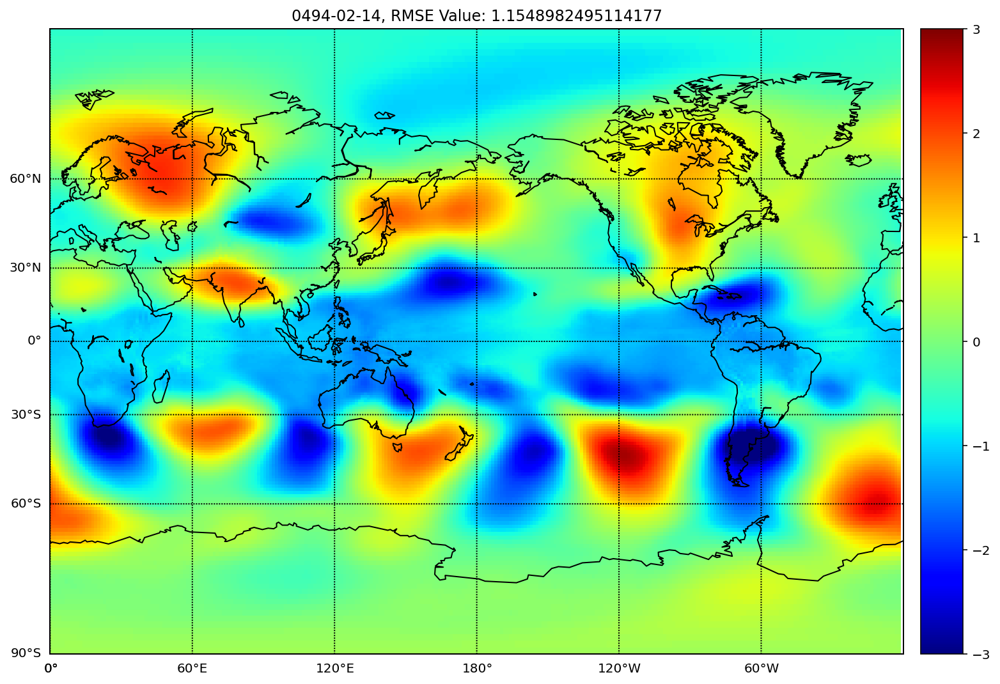

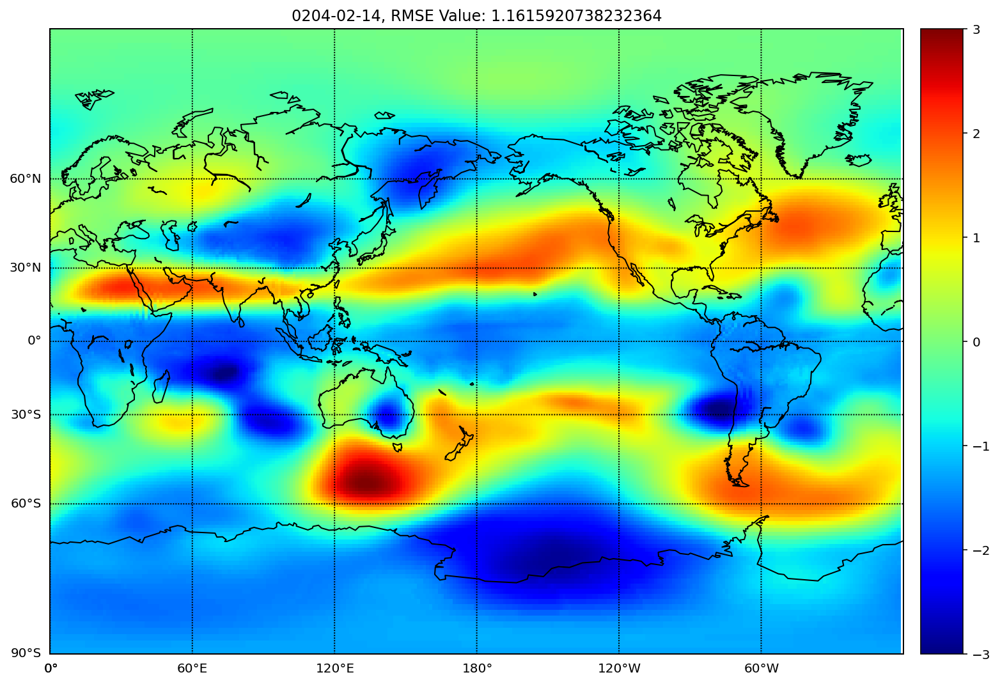

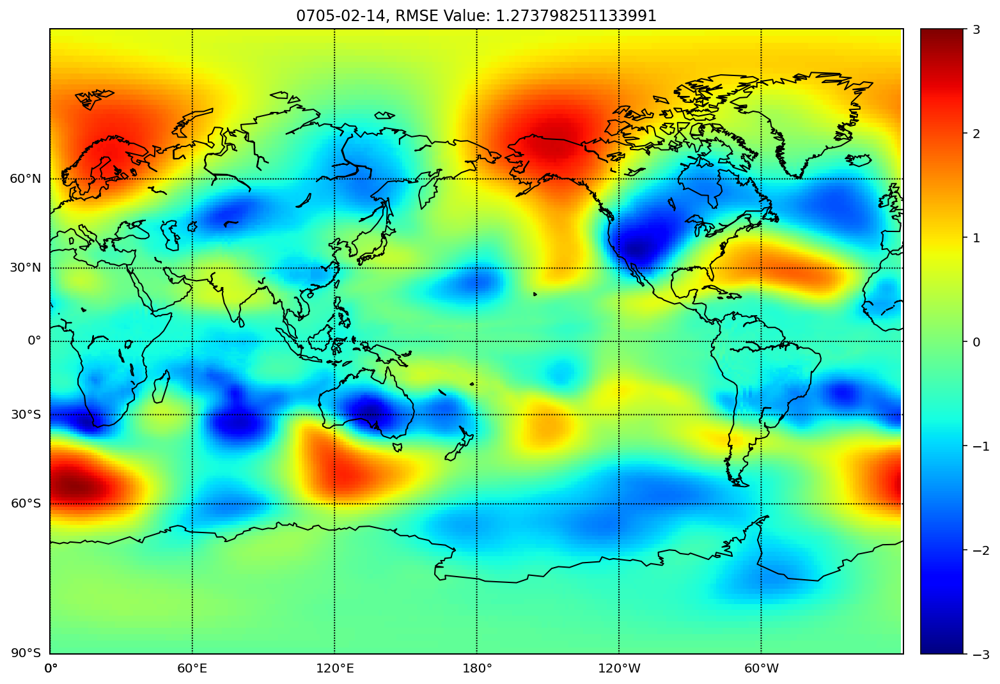

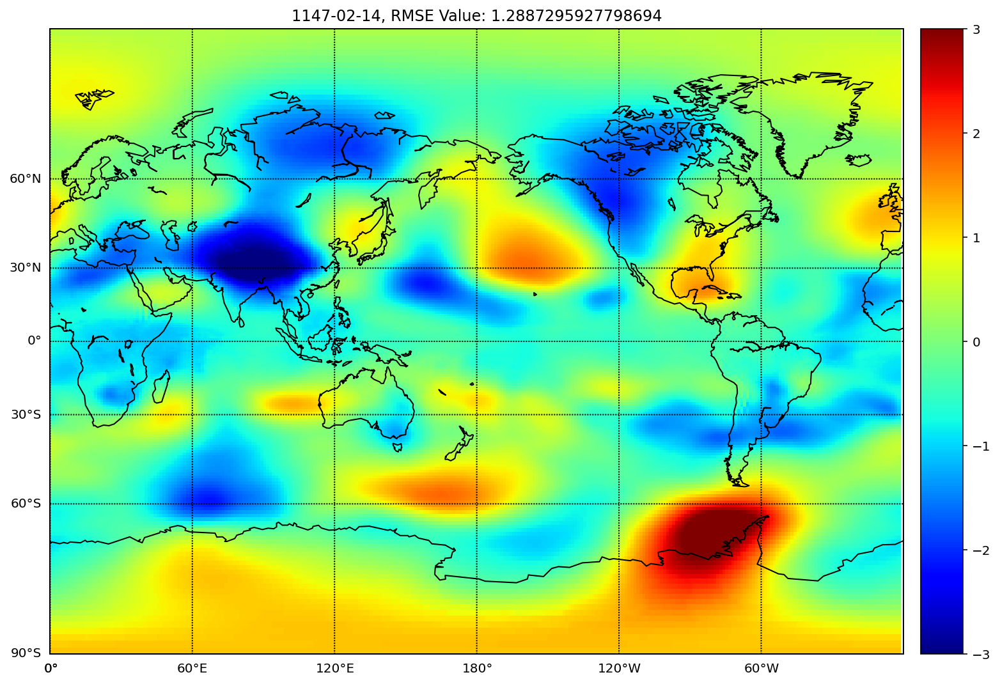

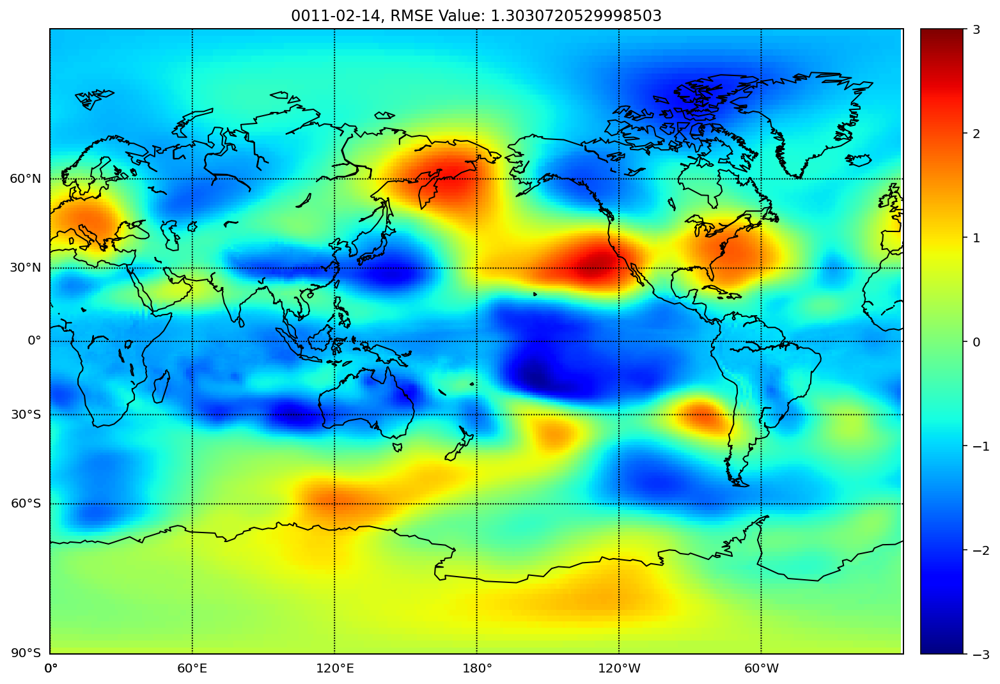

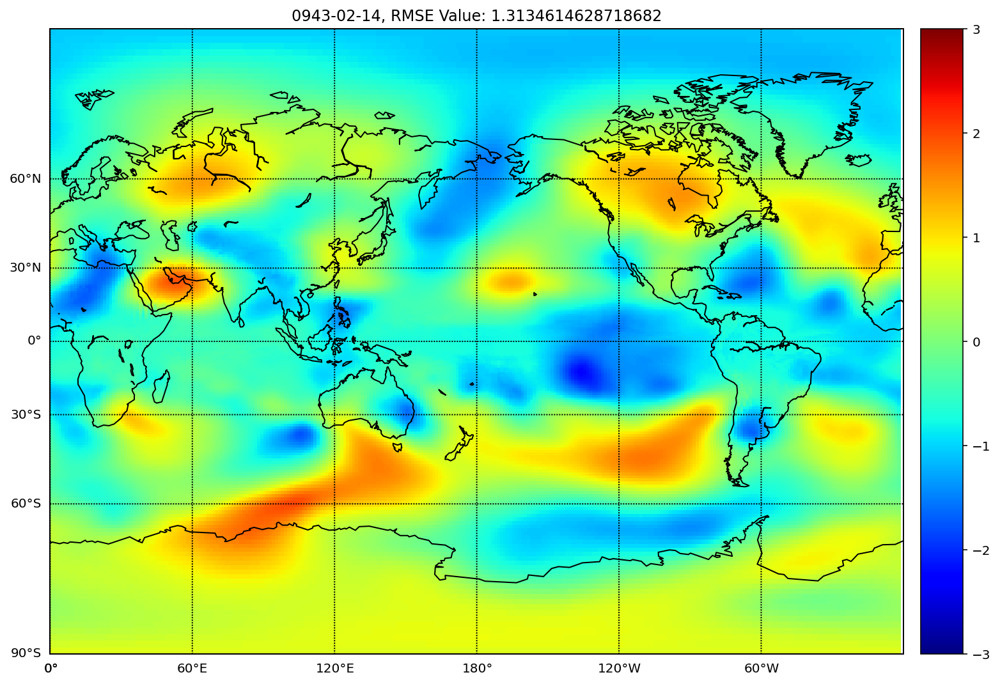

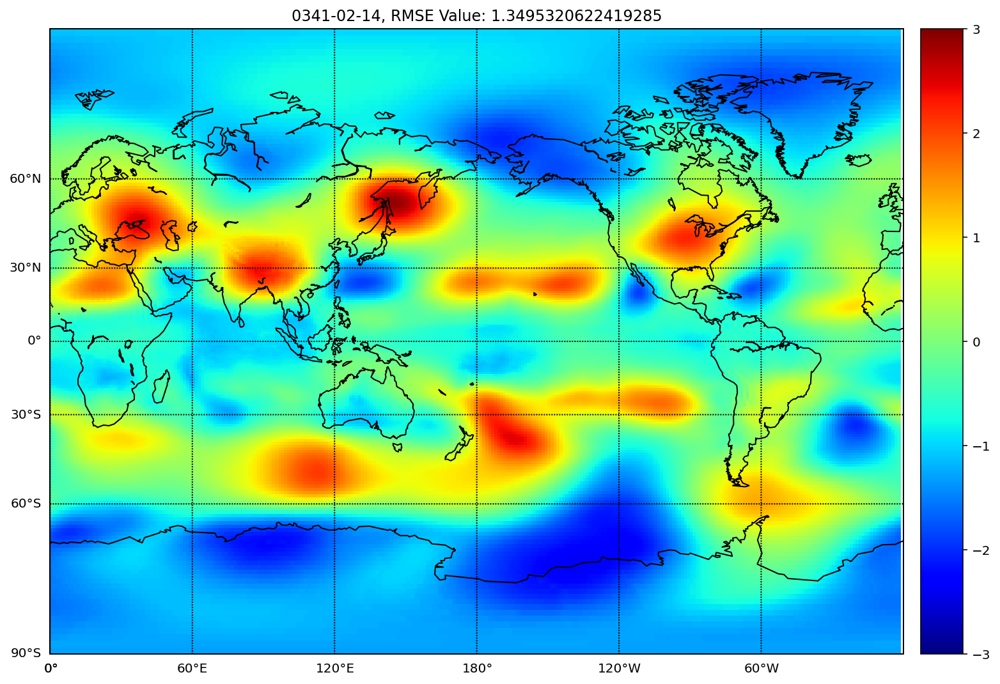

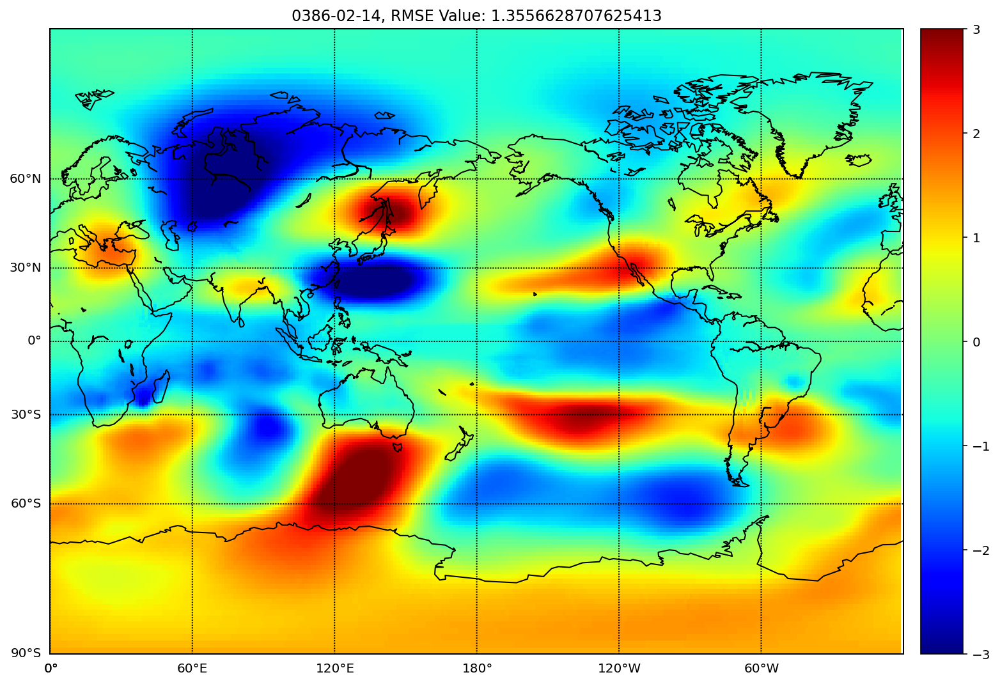

In [0]:
lats = feb_analog.variables['lat'][:]
lons = feb_analog.variables['lon'][:]
zg = feb_analog.variables['zg'][:]

for i in range(10):
  plt.figure(figsize=(18,9))
  m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
                llcrnrlon=0, urcrnrlon=360, resolution='c')

  m.drawcoastlines()
  m.drawmapboundary()
  m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
  m.drawmeridians(np.arange(0.,360., 60.),labels=[0,0,0,1])

  x, y = m(*np.meshgrid(lons,lats))

  m.pcolormesh(x,y,zg[a[i], :, :, 0], shading='flat',cmap=plt.cm.jet, vmin = -3 , vmax = 3)
  m.colorbar(location='right', )
  plt.title(str(dates[i]) + ', RMSE Value: '+ str(rms[a[i]].values))
  # plt.savefig(str(i+1) + '_' + str(dates[i])+ '.png')

# Plotting Feb Analog Anomalie Mean and calculating it's RMSE with respect to target year Feb(0500-02)

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f06ed64aa90>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f06ed64ae10>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f06ed657128>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f06ed657438>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f06ed657748>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ed657a58>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f06ed657c88>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f06ed6a5278>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f06ed3e41d0>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f06ed3e44a8>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f06ed3e47b8>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f06ed3e4ac8>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f06ed3e4dd8>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, 'Feb Analog Mean RMSE: 1.182893738858311')

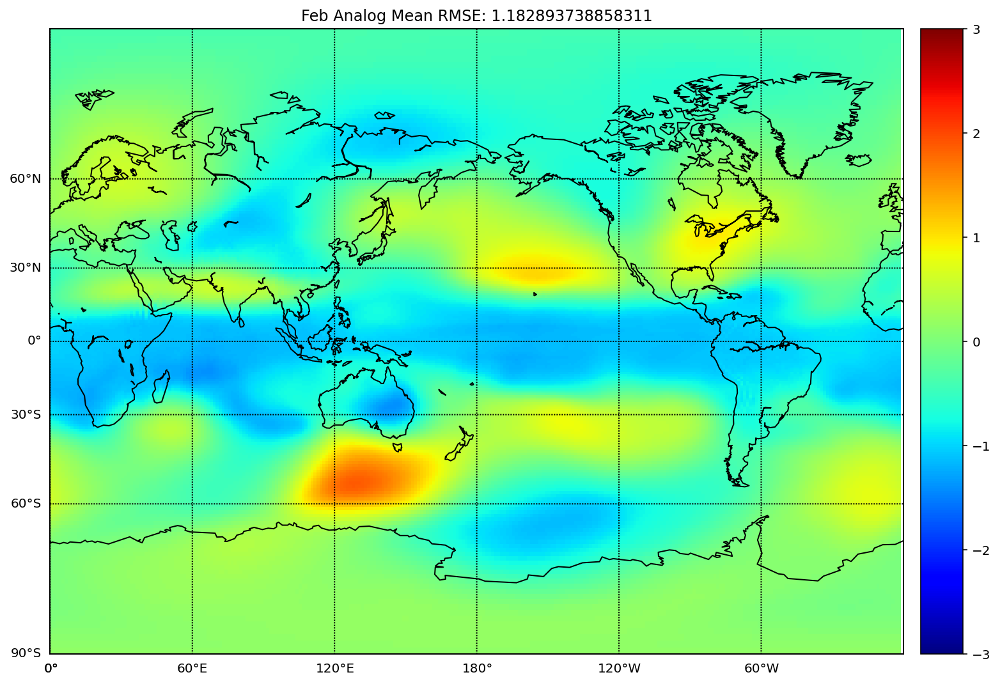

In [0]:
feb_analog_mean = feb_analog.mean(dim = 'time')

err = 0
err_1 = (feb_monthly_anomalies.zg[499, :, :] - feb_analog_mean.zg[i, :, :])**2
err_total = err_1.sum()
err = ((err_total/(192*288))**(1/2))

lats = feb_analog_mean.variables['lat'][:]
lons = feb_analog_mean.variables['lon'][:]
zg = feb_analog_mean.variables['zg'][:]


plt.figure(figsize=(18,9))
m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
              llcrnrlon=0, urcrnrlon=360, resolution='c')

m.drawcoastlines()
m.drawmapboundary()
m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
m.drawmeridians(np.arange(0.,360., 60.),labels=[0,0,0,1])

x, y = m(*np.meshgrid(lons,lats))

m.pcolormesh(x,y,zg[:, :, 0], shading='flat',cmap=plt.cm.jet, vmin = -3 , vmax = 3)
m.colorbar(location='right', )
plt.title('Feb Analog Mean RMSE: ' + str(err.values))
# plt.savefig(str(i+1) + '_' + str(dates[i])+ '.png')

# March


In [0]:
monthly_data = ds_cesm_500.groupby('time.month').groups
march_data = monthly_data[3]
gs_march=ds_cesm_500.isel(time=march_data)
gs_march

<xarray.Dataset>
Dimensions:    (lat: 192, lon: 288, nbnd: 2, time: 1200)
Coordinates:
  * lat        (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 88.12 89.06 90.0
    lat_bnds   (lat, nbnd) float32 -90.0 -89.52879 -89.52879 ... 89.52879 90.0
  * lon        (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
    lon_bnds   (lon, nbnd) float32 -0.625 0.625 0.625 ... 358.125 359.375
    plev       float64 5e+04
  * time       (time) object 0001-03-15 12:00:00 ... 1200-03-15 12:00:00
    time_bnds  (time, nbnd) object 0001-03-01 00:00:00 ... 1200-04-01 00:00:00
Dimensions without coordinates: nbnd
Data variables:
    zg         (time, lat, lon) float32 4956.429 4956.429 ... 5163.186 5163.186
Attributes:
    Conventions:            CF-1.7 CMIP-6.2
    activity_id:            CMIP
    branch_method:          standard
    branch_time_in_child:   0.0
    branch_time_in_parent:  48545.0
    case_id:                3
    cesm_casename:          b.e21.B1850.f09_g17.CMIP6-piControl.001
    contact:                cesm_cmip6@ucar.edu
    creation_date:          2019-01-20T22:41:36Z
    data_specs_version:     01.00.29
    experiment:             pre-industrial control
    experiment_id:          piControl
    external_variables:     areacella
    forcing_index:          1
    frequency:              mon
    further_info_url:       https://furtherinfo.es-doc.org/CMIP6.NCAR.CESM2.p...
    grid:                   native 0.9x1.25 finite volume grid (192x288 latxlon)
    grid_label:             gn
    initialization_index:   1
    institution:            National Center for Atmospheric Research, Climate...
    institution_id:         NCAR
    license:                CMIP6 model data produced by <The National Center...
    mip_era:                CMIP6
    model_doi_url:          https://doi.org/10.5065/D67H1H0V
    nominal_resolution:     100 km
    parent_activity_id:     CMIP
    parent_experiment_id:   piControl-spinup
    parent_mip_era:         CMIP6
    parent_source_id:       CESM2
    parent_time_units:      days since 0001-01-01 00:00:00
    parent_variant_label:   r1i1p1f1
    physics_index:          1
    product:                model-output
    realization_index:      1
    realm:                  atmos
    source:                 CESM2 (2017): atmosphere: CAM6 (0.9x1.25 finite v...
    source_id:              CESM2
    source_type:            AOGCM BGC AER
    sub_experiment:         none
    sub_experiment_id:      none
    table_id:               Amon
    tracking_id:            hdl:21.14100/9eddf64a-cf0f-489d-9ce4-8b514e591b1a...
    variable_id:            zg
    variant_info:           CMIP6 CESM2 piControl experiment with CAM6, inter...
    variant_label:          r1i1p1f1
    status:                 2019-10-25;created;by nhn2@columbia.edu

# Plotting target March (0500-03)

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f8b6f65f828>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f8b6f65fba8>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f8b6f65fe80>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f8b6f5f21d0>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f8b6f5f24e0>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6f5f27f0>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f8b6f5f2a20>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6f60deb8>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f8b6f60df28>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f8b6f606278>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f8b6f606588>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f8b6f606898>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f8b6f606ba8>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0500-03-15')

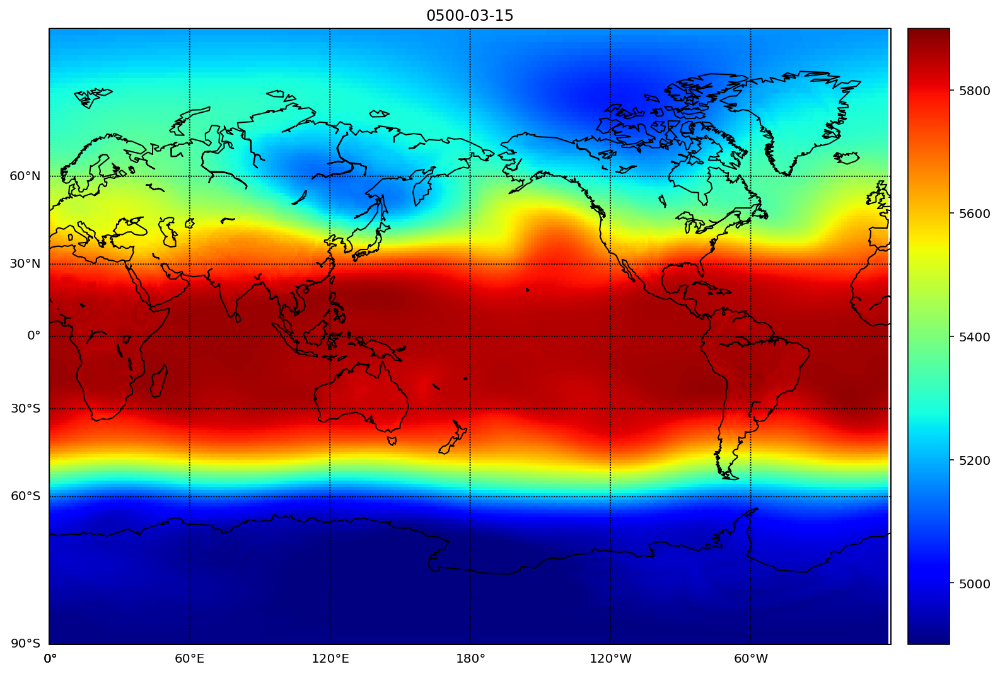

In [0]:
lats = gs_march.variables['lat'][:]
lons = gs_march.variables['lon'][:]
zg = gs_march.variables['zg'][:]


plt.figure(figsize=(18,9))
m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
              llcrnrlon=0, urcrnrlon=360, resolution='c')

m.drawcoastlines()
m.drawmapboundary()
m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
m.drawmeridians(np.arange(0.,360., 60.),labels=[0,0,0,1])

x, y = m(*np.meshgrid(lons,lats))

m.pcolormesh(x,y,zg[499, :, :], shading='flat',cmap=plt.cm.jet, vmin = 4900, vmax = 5900)
m.colorbar(location='right', )
plt.title('0500-03-15')
# plt.savefig(str(i+1) + '_' + str(dates[i])+ '.png')

# Making new dataset of Analog Year


In [0]:
march_analog_1 =  gs_march.sel(time = '0341-03-15')
march_analog_2 =  gs_march.sel(time = '1147-03-15')
march_analog_3 =  gs_march.sel(time = '0943-03-15')
march_analog_4 =  gs_march.sel(time = '0011-03-15')
march_analog_5 =  gs_march.sel(time = '0359-03-15')
march_analog_6 =  gs_march.sel(time = '0705-03-15')
march_analog_7 =  gs_march.sel(time = '0494-03-15')
march_analog_8 =  gs_march.sel(time = '0204-03-15')
march_analog_9 =  gs_march.sel(time = '0127-03-15')
march_analog_10 =  gs_march.sel(time = '0386-03-15')


march_analog = xr.merge([march_analog_1, march_analog_2, march_analog_3, march_analog_4, march_analog_5, march_analog_6, march_analog_7, march_analog_8, march_analog_9, march_analog_10])
march_analog

<xarray.Dataset>
Dimensions:    (lat: 192, lon: 288, nbnd: 2, time: 10)
Coordinates:
  * time       (time) object 0011-03-15 12:00:00 ... 1147-03-15 12:00:00
  * lat        (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 88.12 89.06 90.0
    lat_bnds   (lat, nbnd) float32 -90.0 -89.52879 -89.52879 ... 89.52879 90.0
  * lon        (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
    lon_bnds   (lon, nbnd) float32 -0.625 0.625 0.625 ... 358.125 359.375
    plev       float64 5e+04
    time_bnds  (time, nbnd) object 0011-03-01 00:00:00 ... 1147-04-01 00:00:00
Dimensions without coordinates: nbnd
Data variables:
    zg         (time, lat, lon) float32 4966.884 4966.884 ... 5044.6895

# Mean of Analog Year of March

In [0]:
march_analog_mean = march_analog.zg.groupby('time.month').mean()
march_analog_mean

<xarray.DataArray 'zg' (month: 1, lat: 192, lon: 288)>
array([[[4955.7275, 4955.7275, 4955.7275, ..., 4955.7275, 4955.7275,
         4955.7275],
        [4955.837 , 4955.943 , 4956.061 , ..., 4955.491 , 4955.6094,
         4955.7295],
        [4954.4546, 4954.425 , 4954.419 , ..., 4954.602 , 4954.513 ,
         4954.479 ],
        ...,
        [5073.8154, 5073.969 , 5074.121 , ..., 5073.331 , 5073.4956,
         5073.6567],
        [5071.206 , 5071.2686, 5071.331 , ..., 5071.007 , 5071.074 ,
         5071.1406],
        [5069.175 , 5069.175 , 5069.175 , ..., 5069.175 , 5069.175 ,
         5069.175 ]]], dtype=float32)
Coordinates:
  * lat      (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 87.17 88.12 89.06 90.0
  * lon      (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
    plev     float64 5e+04
  * month    (month) int64 3

# Calculating RMSE of Mean of Analogs with respect to target year(500)


In [0]:
err = 0
err_1 = (gs_march.zg[499, :, :] - march_analog_mean[0, :, :])**2
err_total = err_1.sum()
err = ((err_total/55296)**(1/2))
err

<xarray.DataArray 'zg' ()>
array(62.10340373)
Coordinates:
    plev     float64 5e+04
    time     object 0500-03-15 12:00:00
    month    int64 3

# Plotting Mean of Analogs of March

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f8b7327fba8>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f8b7327ff60>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f8b7326c278>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f8b7326c588>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f8b7326c898>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b7326cba8>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f8b7326cdd8>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b73324fd0>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f8b732a12e8>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f8b732a15f8>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f8b732a1908>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f8b732a1c18>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f8b732a1f28>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, 'March Analog Mean RMSE: 62.10340372821469')

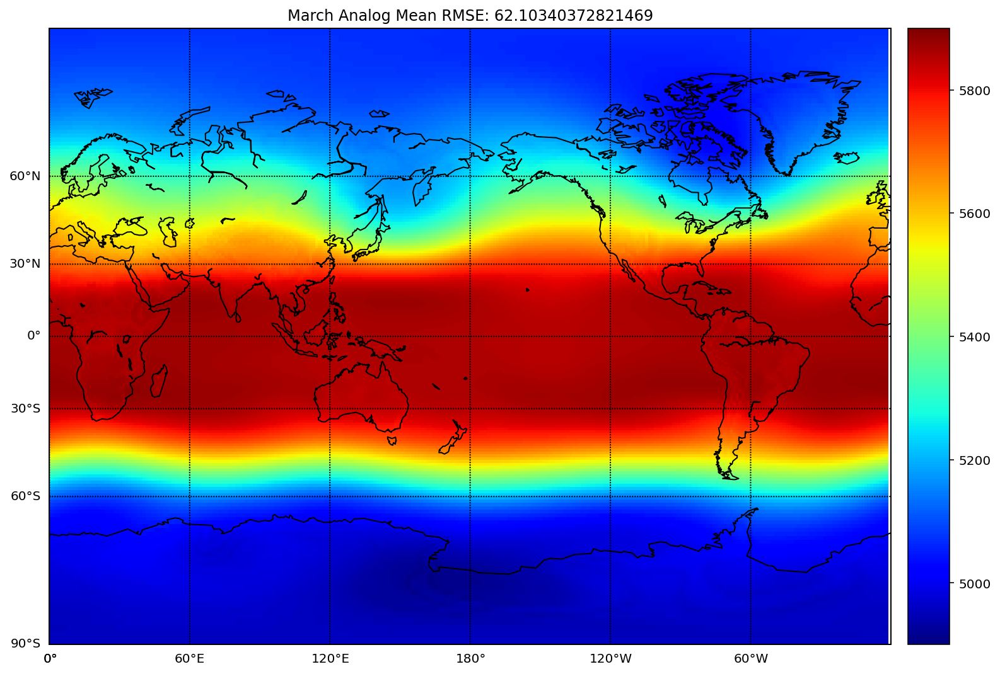

In [0]:
lats = march_analog_mean['lat'][:]
lons = march_analog_mean['lon'][:]
zg = march_analog_mean[:]


plt.figure(figsize=(18,9))
m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
              llcrnrlon=0, urcrnrlon=360, resolution='c')

m.drawcoastlines()
m.drawmapboundary()
m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
m.drawmeridians(np.arange(0.,360., 60.),labels=[0,0,0,1])

x, y = m(*np.meshgrid(lons,lats))

m.pcolormesh(x,y,zg[0, :, :], shading='flat',cmap=plt.cm.jet, vmin = 4900, vmax = 5900)
m.colorbar(location='right', )
plt.title('March Analog Mean RMSE: '+ str(err.values) )
# plt.savefig(str(i+1) + '_' + str(dates[i])+ '.png')

# Calculating RMSE of Analog year with respect to year 0500 and arranging them in order

In [0]:
import datetime 

rms = []

for i in range(10):
  err = 0
  err_1 = (gs_march.zg[499, :, :] - march_analog.zg[i, :, :])**2
  err_total = err_1.sum()
  err = ((err_total/55296)**(1/2))
  rms.append(err.values)

a = sorted(range(len(rms)), key=lambda i: rms[i])[:10]

dates = [datetime.datetime.strptime(str(march_analog.time[a[i]].values),"%Y-%m-%d %H:%M:%S").date() for i in range(10)] 

for i in range(10):
  print(str(i+1) +' Root mean Square Error of ' + str(dates[i]) + ': ' + str(rms[a[i]]))

1 Root mean Square Error of 0494-03-15: 49.897145366651394
2 Root mean Square Error of 0011-03-15: 59.29732492326745
3 Root mean Square Error of 0359-03-15: 72.4001067883395
4 Root mean Square Error of 0705-03-15: 73.43223286863933
5 Root mean Square Error of 0127-03-15: 73.55712774209354
6 Root mean Square Error of 0204-03-15: 74.52710481329495
7 Root mean Square Error of 0386-03-15: 80.06147811387058
8 Root mean Square Error of 0943-03-15: 81.24044815648585
9 Root mean Square Error of 1147-03-15: 81.75331641817579
10 Root mean Square Error of 0341-03-15: 104.5939458980228


# Plotting Analogs

In [0]:
lats = march_analog.variables['lat'][:]
lons = march_analog.variables['lon'][:]
zg = march_analog.variables['zg'][:]

for i in range(10):
  plt.figure(figsize=(18,9))
  m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
                llcrnrlon=0, urcrnrlon=360, resolution='c')

  m.drawcoastlines()
  m.drawmapboundary()
  m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
  m.drawmeridians(np.arange(0.,360., 60.),labels=[0,0,0,1])

  x, y = m(*np.meshgrid(lons,lats))

  m.pcolormesh(x,y,zg[a[i], :, :], shading='flat',cmap=plt.cm.jet)
  m.colorbar(location='right', )
  plt.title(str(march_analog.time[a[i]].values)+ ' RMSE: ' + str(rms[a[i]]))
  # plt.savefig(str(i+1) + '_' + str(dates[i])+ '.png')

# Calculating STD and Mean of March

In [0]:
gs_march_std = gs_march.groupby('time.month').std()
gs_march_mean = gs_march.groupby('time.month').mean()

# Plotting STD of March

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f8b6b02f3c8>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f8b6b30cbe0>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f8b6b12f208>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f8b6b102a58>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f8b6afdb1d0>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6afdb908>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f8b6afdbb70>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6b22d128>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f8b6bd86630>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f8b6bd9c470>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f8b6bd9cb70>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f8b6f6b2da0>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f8b6bd28d30>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, 'March STD')

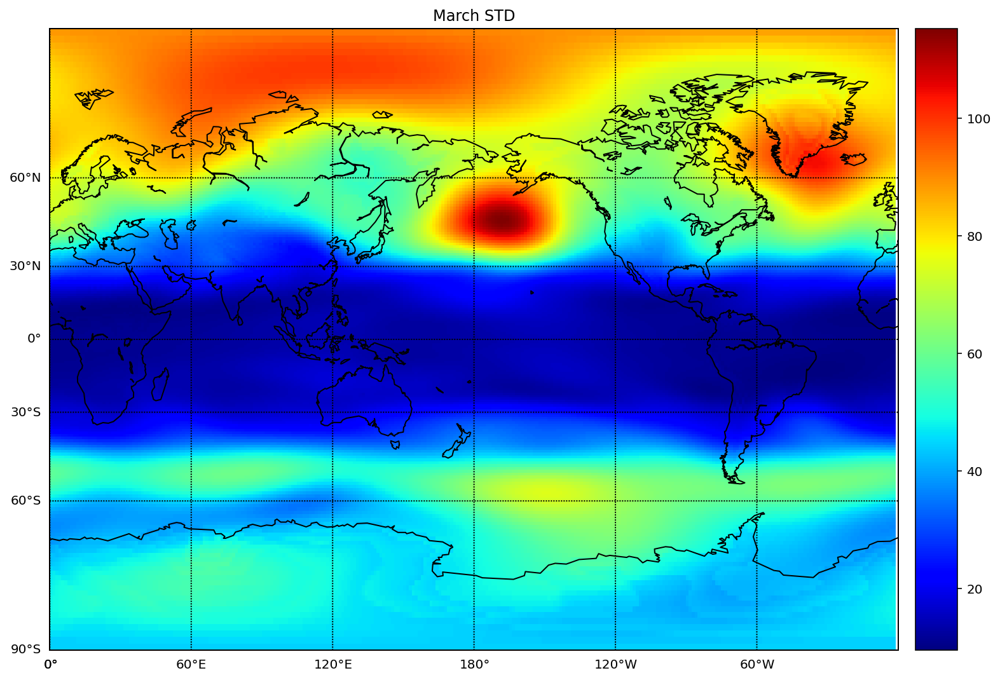

In [0]:
lats = gs_march_std.variables['lat'][:]
lons = gs_march_std.variables['lon'][:]
zg = gs_march_std.variables['zg'][:]


plt.figure(figsize=(18,9))
m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
              llcrnrlon=0, urcrnrlon=360, resolution='c')

m.drawcoastlines()
m.drawmapboundary()
m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
m.drawmeridians(np.arange(0.,360., 60.),labels=[0,0,0,1])

x, y = m(*np.meshgrid(lons,lats))

m.pcolormesh(x,y,zg[0, :, :], shading='flat',cmap=plt.cm.jet)
m.colorbar(location='right', )
plt.title('March STD')
# plt.savefig(str(i+1) + '_' + str(dates[i])+ '.png')

# Calculating RMSE of Mean March with respect to target year(0500)


In [0]:
err = 0
err_1 = (gs_march.zg[499, :, :] - gs_march_mean.zg[0, :, :])**2
err_total = err_1.sum()
err = ((err_total/55296)**(1/2))
err

<xarray.DataArray 'zg' ()>
array(61.15633191)
Coordinates:
    plev     float64 5e+04
    time     object 0500-03-15 12:00:00
    month    int64 3

# Plottting Mean March

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f8b6ad75198>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f8b6ad75518>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f8b6ad75860>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f8b6ad75ba8>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f8b6ad75ef0>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6ad80278>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f8b6ad80470>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6ad8bbe0>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f8b6ad8bcc0>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f8b6ad8bf98>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f8b6ae54390>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f8b6ae546d8>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f8b6ae54a20>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, 'March Mean RMSE: 61.15633191150668')

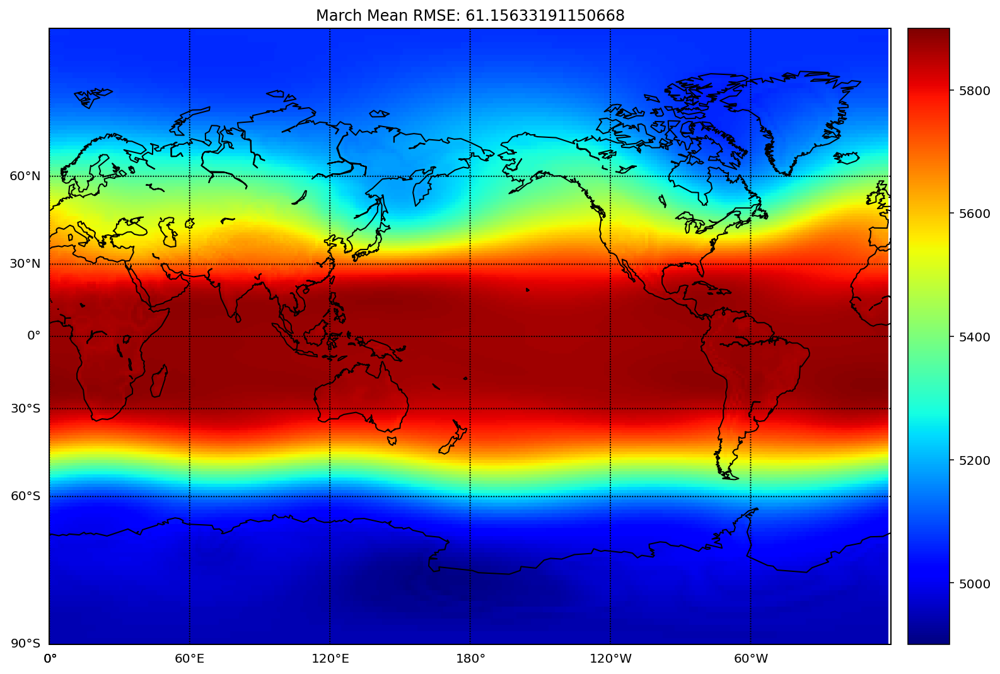

In [0]:
lats = gs_march_mean.variables['lat'][:]
lons = gs_march_mean.variables['lon'][:]
zg = gs_march_mean.variables['zg'][:]


plt.figure(figsize=(18,9))
m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
              llcrnrlon=0, urcrnrlon=360, resolution='c')

m.drawcoastlines()
m.drawmapboundary()
m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
m.drawmeridians(np.arange(0.,360., 60.),labels=[0,0,0,1])

x, y = m(*np.meshgrid(lons,lats))

m.pcolormesh(x,y,zg[0, :, :], shading='flat',cmap=plt.cm.jet, vmin = 4900, vmax = 5900)
m.colorbar(location='right', )
plt.title('March Mean RMSE: ' + str(err.values))
# plt.savefig(str(i+1) + '_' + str(dates[i])+ '.png')

# March Persistence

In [0]:
march_persistence_1 =  new_monthly_anomalies_jan.sel(time = '0500-01-15')
march_persistence = (march_persistence_1.zg[0] * gs_march_std.zg[0]) + gs_march_mean.zg[0]
march_persistence

<xarray.DataArray 'zg' (lat: 192, lon: 288, month: 1)>
array([[[4887.8584],
        [4887.8584],
        [4887.8584],
        ...,
        [4887.8584],
        [4887.8584],
        [4887.8584]],

       [[4890.2793],
        [4890.4424],
        [4890.6016],
        ...,
        [4889.715 ],
        [4889.915 ],
        [4890.1157]],

       [[4887.2427],
        [4887.4805],
        [4887.7627],
        ...,
        [4886.75  ],
        [4886.8716],
        [4887.039 ]],

       ...,

       [[5110.4766],
        [5110.684 ],
        [5110.89  ],
        ...,
        [5109.8706],
        [5110.074 ],
        [5110.2744]],

       [[5110.593 ],
        [5110.6973],
        [5110.787 ],
        ...,
        [5110.3076],
        [5110.3984],
        [5110.4976]],

       [[5109.59  ],
        [5109.59  ],
        [5109.59  ],
        ...,
        [5109.59  ],
        [5109.59  ],
        [5109.59  ]]], dtype=float32)
Coordinates:
  * month    (month) int64 1
    plev     float64 5e+04
  * lon      (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
  * lat      (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 87.17 88.12 89.06 90.0
    time     object 0500-01-15 12:00:00

# Calculating RMSE of March Persistence with respect to target year(0500) 

In [0]:
err = 0
err_1 = (gs_march.zg[499, :, :] - march_persistence[:, :, 0])**2
err_total = err_1.sum()
err = ((err_total/55296)**(1/2))
err

<xarray.DataArray 'zg' ()>
array(61.61365965)
Coordinates:
    plev     float64 5e+04
    month    int64 1

# Plotting March Persistence

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f8b6ac06160>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f8b6ac064e0>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f8b6ac06828>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f8b6ac06b70>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f8b6ac06eb8>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6ac11240>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f8b6ac11438>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6ad9cba8>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f8b6ad9cc88>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f8b6ad9cfd0>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f8b6ada8358>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f8b6ada86a0>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f8b6ada89e8>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, 'March Persistence RMSE: 61.61365965072644')

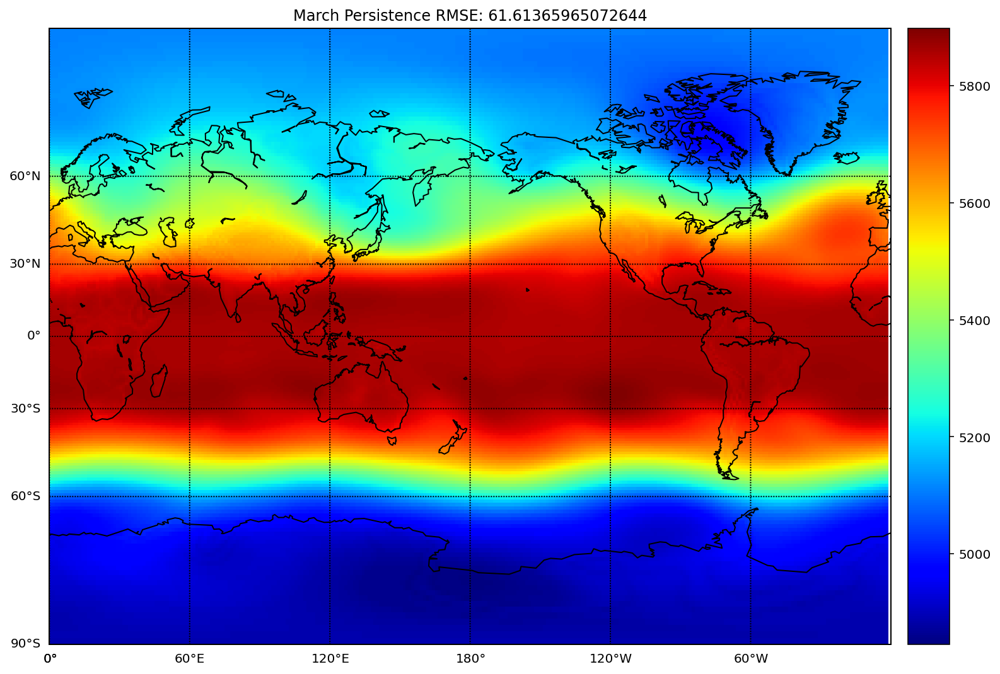

In [0]:
lats = march_persistence['lat'][:]
lons = march_persistence['lon'][:]
zg = march_persistence[:]


plt.figure(figsize=(18,9))
m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
              llcrnrlon=0, urcrnrlon=360, resolution='c')

m.drawcoastlines()
m.drawmapboundary()
m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
m.drawmeridians(np.arange(0.,360., 60.),labels=[0,0,0,1])

x, y = m(*np.meshgrid(lons,lats))

m.pcolormesh(x,y,zg[:, :, 0], shading='flat',cmap=plt.cm.jet)
m.colorbar(location='right', )
plt.title('March Persistence RMSE: ' + str(err.values))
# plt.savefig(str(i+1) + '_' + str(dates[i])+ '.png')

# Monthly Anomalies of March

In [0]:
march_monthly_anomalies = (gs_march.groupby('time.month') - gs_march.groupby('time.month').mean())/gs_march.groupby('time.month').std()
march_monthly_anomalies

<xarray.Dataset>
Dimensions:    (lat: 192, lon: 288, month: 1, nbnd: 2, time: 1200)
Coordinates:
    lon_bnds   (lon, nbnd) float32 -0.625 0.625 0.625 ... 358.125 359.375
  * month      (month) int64 3
    plev       float64 5e+04
    lat_bnds   (lat, nbnd) float32 -90.0 -89.52879 -89.52879 ... 89.52879 90.0
  * lon        (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
  * lat        (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 88.12 89.06 90.0
  * time       (time) object 0001-03-15 12:00:00 ... 1200-03-15 12:00:00
    time_bnds  (time, nbnd) object 0001-03-01 00:00:00 ... 1200-04-01 00:00:00
Dimensions without coordinates: nbnd
Data variables:
    zg         (time, lat, lon, month) float32 0.23921308 ... 1.039391

# Plotting target year(0500)

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f8b6abebdd8>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f8b6aad9198>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f8b6aad94e0>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f8b6aad9828>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f8b6aad9b70>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6aad9eb8>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f8b6aaf0080>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6aafc860>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f8b6aafc940>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f8b6aafcc88>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f8b6aafcfd0>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f8b6ab06358>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f8b6ab066a0>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0500-03-15 12:00:00')

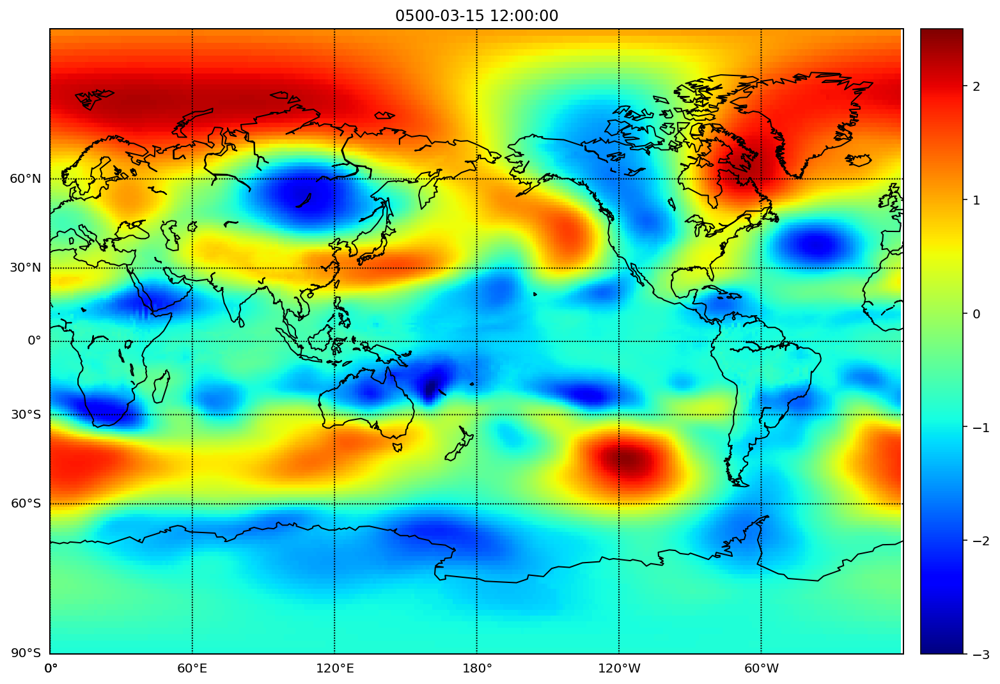

In [0]:
lats = march_monthly_anomalies.variables['lat'][:]
lons = march_monthly_anomalies.variables['lon'][:]
zg = march_monthly_anomalies.variables['zg'][:]

plt.figure(figsize=(18,9))
m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
              llcrnrlon=0, urcrnrlon=360, resolution='c')

m.drawcoastlines()
m.drawmapboundary()
m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
m.drawmeridians(np.arange(0.,360., 60.),labels=[0,0,0,1])

x, y = m(*np.meshgrid(lons,lats))

m.pcolormesh(x,y,zg[499, :, :, 0], shading='flat',cmap=plt.cm.jet, vmin = -3, vmax = 2.5)
m.colorbar(location='right', )
plt.title(march_monthly_anomalies.time[499].values)
# plt.savefig(str(i+1) + '_' + str(dates[i])+ '.png')

# Making new dataset of Analog Year

In [0]:
march_analog_anomalies_1 =  march_monthly_anomalies.sel(time = '0341-03-15')
march_analog_anomalies_2 =  march_monthly_anomalies.sel(time = '1147-03-15')
march_analog_anomalies_3 =  march_monthly_anomalies.sel(time = '0943-03-15')
march_analog_anomalies_4 =  march_monthly_anomalies.sel(time = '0011-03-15')
march_analog_anomalies_5 =  march_monthly_anomalies.sel(time = '0359-03-15')
march_analog_anomalies_6 =  march_monthly_anomalies.sel(time = '0705-03-15')
march_analog_anomalies_7 =  march_monthly_anomalies.sel(time = '0494-03-15')
march_analog_anomalies_8 =  march_monthly_anomalies.sel(time = '0204-03-15')
march_analog_anomalies_9 =  march_monthly_anomalies.sel(time = '0127-03-15')
march_analog_anomalies_10 =  march_monthly_anomalies.sel(time = '0386-03-15')


march_analog_anomalies = xr.merge([march_analog_anomalies_1, march_analog_anomalies_2, march_analog_anomalies_3, march_analog_anomalies_4, march_analog_anomalies_5, march_analog_anomalies_6, march_analog_anomalies_7, march_analog_anomalies_8, march_analog_anomalies_9, march_analog_anomalies_10])
march_analog_anomalies

<xarray.Dataset>
Dimensions:    (lat: 192, lon: 288, month: 1, nbnd: 2, time: 10)
Coordinates:
  * time       (time) object 0011-03-15 12:00:00 ... 1147-03-15 12:00:00
    lon_bnds   (lon, nbnd) float32 -0.625 0.625 0.625 ... 358.125 359.375
  * month      (month) int64 3
    plev       float64 5e+04
    lat_bnds   (lat, nbnd) float32 -90.0 -89.52879 -89.52879 ... 89.52879 90.0
  * lon        (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
  * lat        (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 88.12 89.06 90.0
    time_bnds  (time, nbnd) object 0011-03-01 00:00:00 ... 1147-04-01 00:00:00
Dimensions without coordinates: nbnd
Data variables:
    zg         (time, lat, lon, month) float32 0.47576356 ... -0.27980992

# Calculating RMSE with respect to target year(0500) and arranging them in order

In [0]:
import datetime 

rms = []

for i in range(10):
  err = 0
  err_1 = (march_monthly_anomalies.zg[499, :, :] - march_analog_anomalies.zg[i, :, :])**2
  err_total = err_1.sum()
  err = ((err_total/55296)**(1/2))
  rms.append(err.values)

a = sorted(range(len(rms)), key=lambda i: rms[i])[:10]

dates = [datetime.datetime.strptime(str(march_analog_anomalies.time[a[i]].values),"%Y-%m-%d %H:%M:%S").date() for i in range(10)] 

for i in range(10):
  print(str(i+1) +' Root mean Square Error of ' + str(dates[i]) + ': ' + str(rms[a[i]]))

1 Root mean Square Error of 0494-03-15: 1.080833321777804
2 Root mean Square Error of 0011-03-15: 1.1271186627209566
3 Root mean Square Error of 0705-03-15: 1.2326541141530853
4 Root mean Square Error of 0943-03-15: 1.2739967759741069
5 Root mean Square Error of 0204-03-15: 1.292107564953228
6 Root mean Square Error of 0359-03-15: 1.2958146628519989
7 Root mean Square Error of 0386-03-15: 1.3159806858798209
8 Root mean Square Error of 0127-03-15: 1.3584692264909488
9 Root mean Square Error of 1147-03-15: 1.3638346578188687
10 Root mean Square Error of 0341-03-15: 1.5875299174464763


# Plotting March monthly anomalies

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f8b6a9e5eb8>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f8b6a9f2278>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f8b6a9f2550>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f8b6a9f2860>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f8b6a9f2b70>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6a9f2e80>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f8b6a9f80f0>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6aa07550>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f8b6aa075c0>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f8b6aa078d0>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f8b6aa07be0>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f8b6aa07ef0>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f8b6aa10240>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0494-03-15 12:00:00 RMSE: 1.080833321777804')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f8b6a918e80>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f8b6a92e240>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f8b6a92e518>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f8b6a92e828>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f8b6a92eb38>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6a92ee48>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f8b6a9320b8>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6a9400f0>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f8b6a940588>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f8b6a940898>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f8b6a940ba8>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f8b6a940eb8>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f8b6a94b208>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0011-03-15 12:00:00 RMSE: 1.1271186627209566')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f8b6a86fe48>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f8b6a87e208>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f8b6a87e4e0>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f8b6a87e7f0>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f8b6a87eb00>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6a87ee10>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f8b6a883080>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6a95a0b8>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f8b6a95a550>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f8b6a95a860>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f8b6a95ab70>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f8b6a95ae80>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f8b6a95c1d0>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0705-03-15 12:00:00 RMSE: 1.2326541141530853')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f8b6a7b5e10>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f8b6a7ba1d0>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f8b6a7ba4a8>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f8b6a7ba7b8>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f8b6a7baac8>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6a7badd8>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f8b6a7baf60>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6a895240>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f8b6a895518>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f8b6a895828>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f8b6a895b38>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f8b6a895e48>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f8b6a8a0198>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0943-03-15 12:00:00 RMSE: 1.2739967759741069')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f8b6a701dd8>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f8b6a710198>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f8b6a710470>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f8b6a710780>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f8b6a710a90>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6a710da0>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f8b6a710f98>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6a76c048>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f8b6a76c4e0>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f8b6a76c7f0>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f8b6a76cb00>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f8b6a76ce10>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f8b6a76f160>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0204-03-15 12:00:00 RMSE: 1.292107564953228')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f8b6a642d68>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f8b6a642cf8>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f8b6a649470>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f8b6a649748>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f8b6a649a58>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6a649d68>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f8b6a649f28>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6a6aa1d0>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f8b6a6aa4a8>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f8b6a6aa7b8>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f8b6a6aaac8>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f8b6a6aadd8>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f8b6a6b4128>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0359-03-15 12:00:00 RMSE: 1.2958146628519989')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f8b6b19c470>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f8b6b19cc50>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f8b6b19cd68>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f8b6b1d5f28>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f8b6b1d5ef0>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6b1d5be0>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f8b6b1d5630>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6b3490b8>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f8b6b3495f8>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f8b6b349668>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f8b6b349d68>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f8b6b321048>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f8b6b321390>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0386-03-15 12:00:00 RMSE: 1.3159806858798209')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f8b6b3709e8>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f8b6b3709b0>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f8b6b57e390>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f8b6b57ec18>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f8b6b57ee80>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6b57e208>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f8b6b57e4e0>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6f928780>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f8b6f9286d8>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f8b6f928c50>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f8b6f974470>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f8b6f974a58>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f8b6f974ac8>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0127-03-15 12:00:00 RMSE: 1.3584692264909488')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f8b6b727080>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f8b6b727da0>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f8b6b727128>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f8b6b7274a8>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f8b6b727ba8>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6f92a6a0>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f8b6f92ab38>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6b740eb8>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f8b6b740f98>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f8b7552ae48>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f8b6afa3668>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f8b6afa3b00>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f8b6afa3198>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '1147-03-15 12:00:00 RMSE: 1.3638346578188687')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7f8b6b5b8e10>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7f8b6b5b83c8>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7f8b6b47fc88>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7f8b6b47f908>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7f8b6b47f208>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6b47ff98>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7f8b6b3c35c0>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7f8b6b5137f0>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7f8b6b5132e8>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7f8b6b82be48>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7f8b6b82b400>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7f8b6b82b668>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7f8b6b82bb70>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0341-03-15 12:00:00 RMSE: 1.5875299174464763')

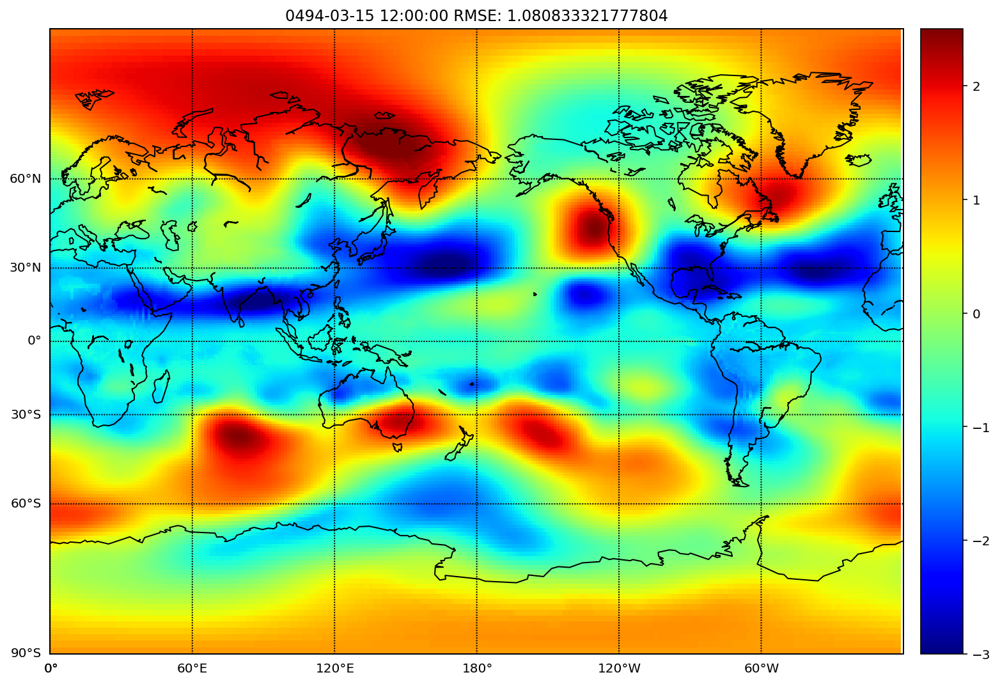

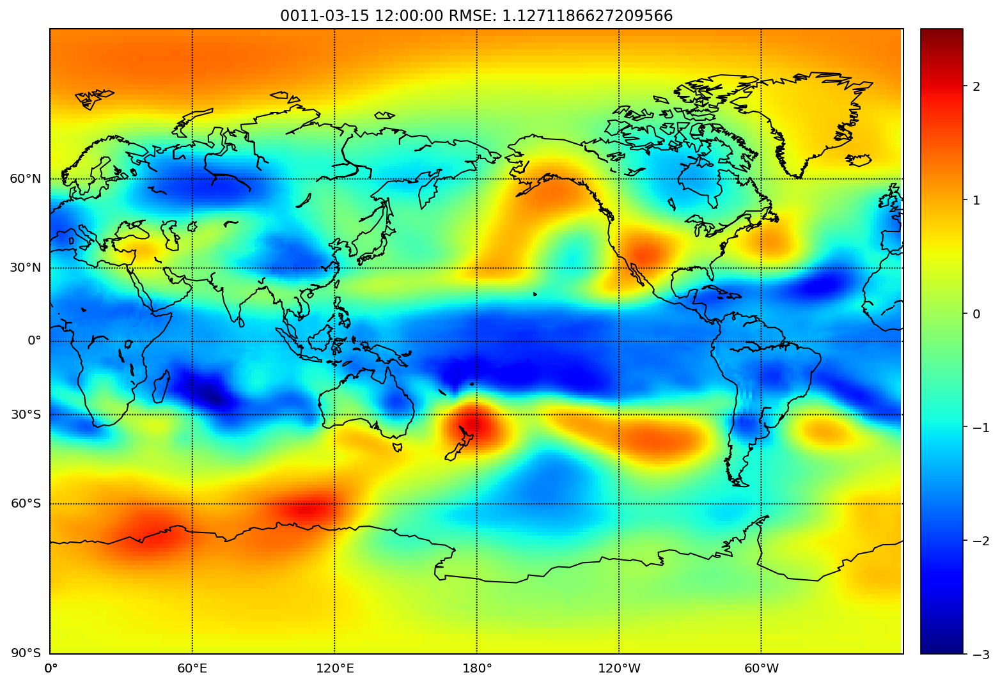

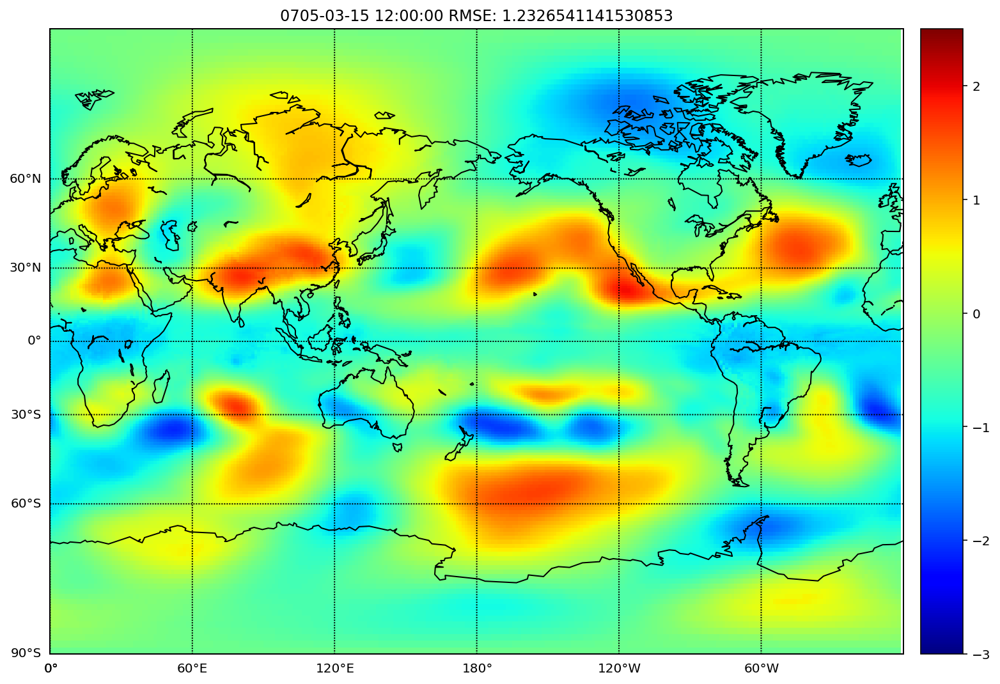

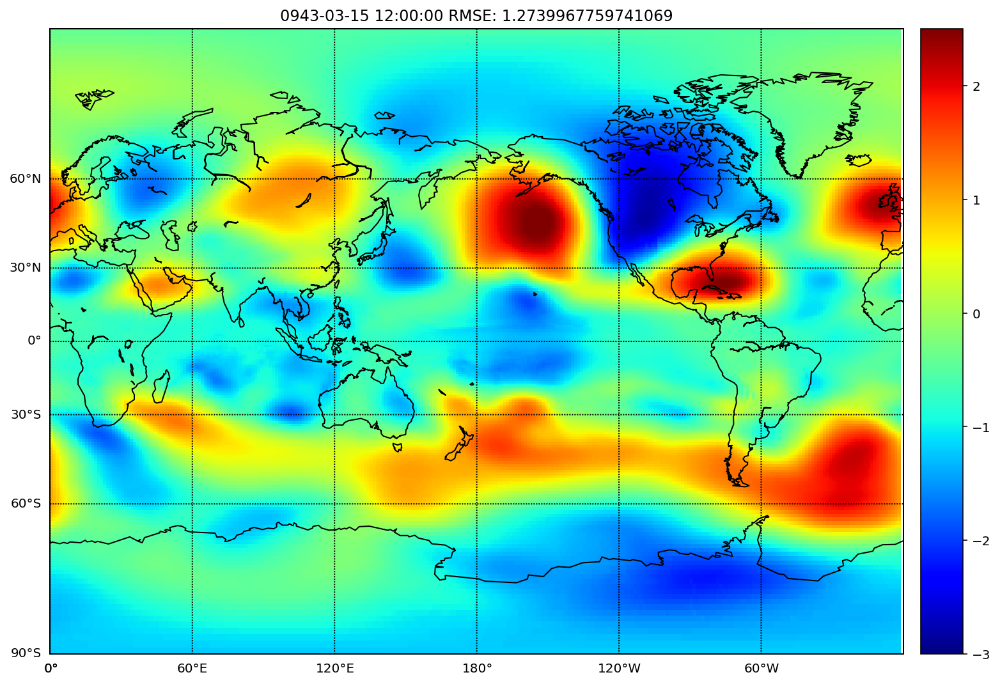

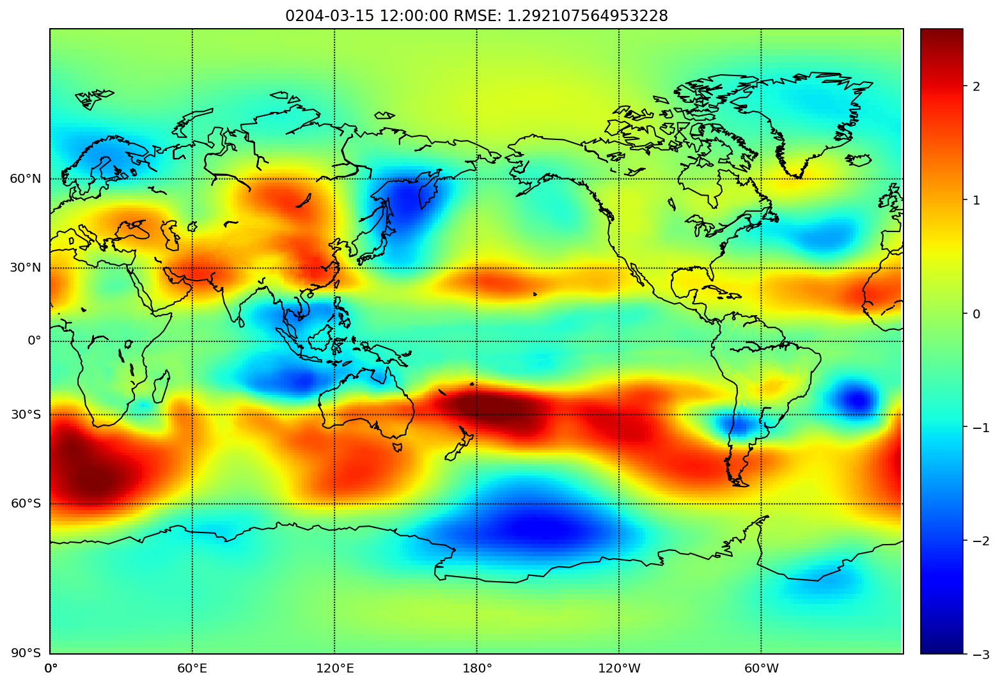

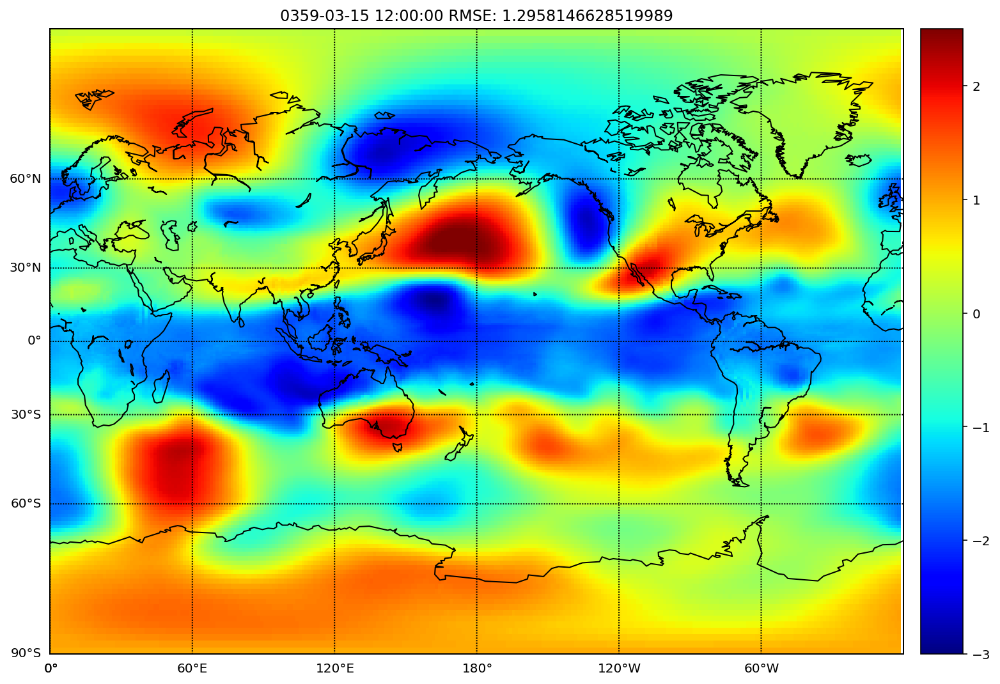

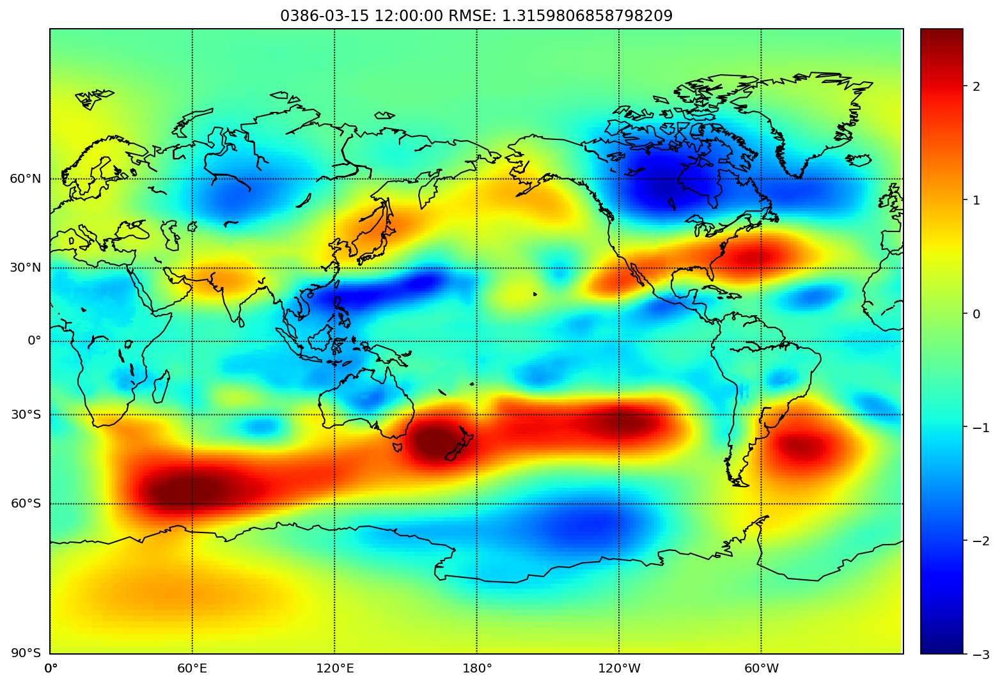

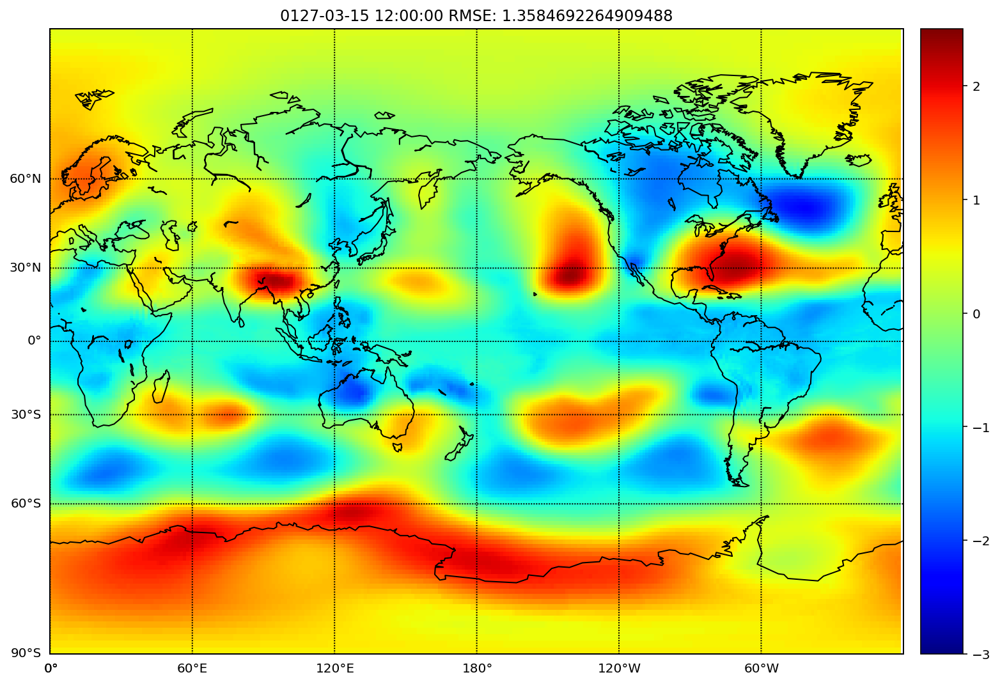

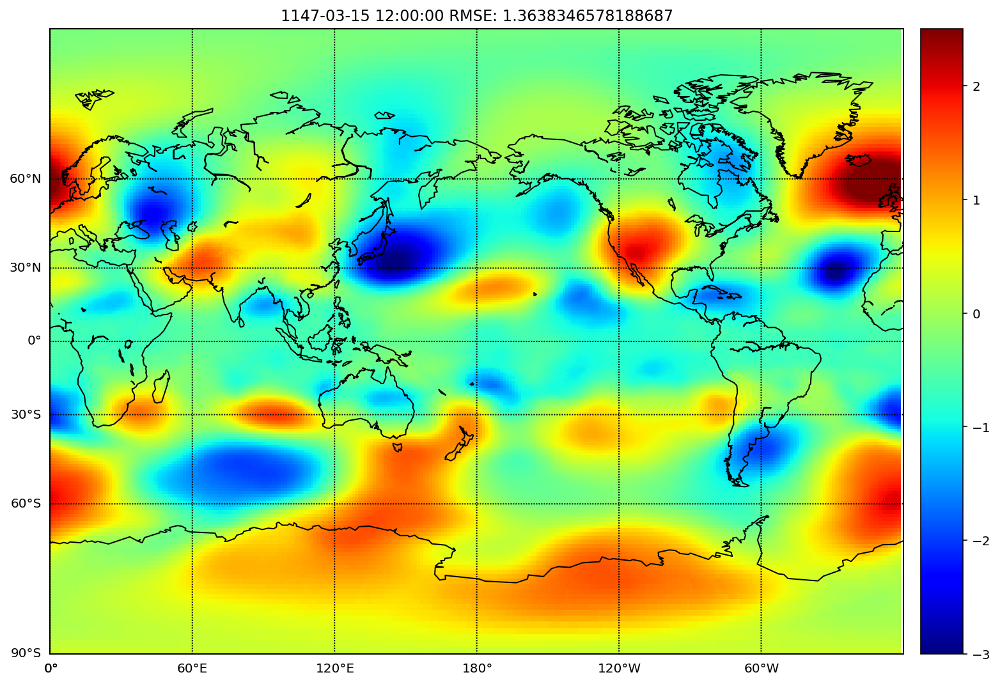

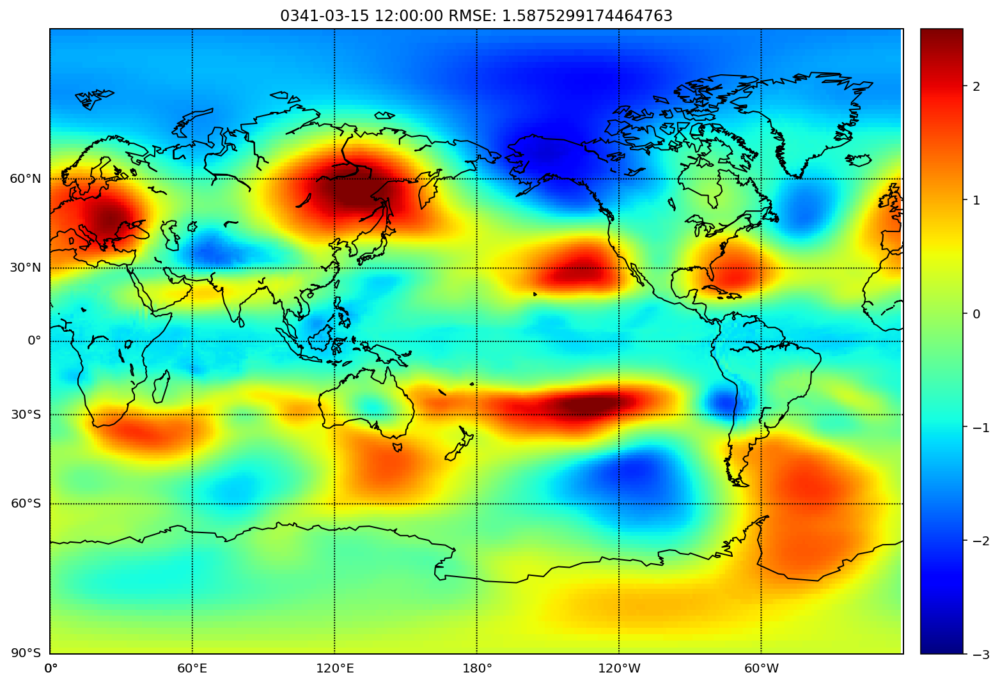

In [0]:
lats = march_analog_anomalies.variables['lat'][:]
lons = march_analog_anomalies.variables['lon'][:]
zg = march_analog_anomalies.variables['zg'][:]

for i in range(10):
  plt.figure(figsize=(18,9))
  m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
                llcrnrlon=0, urcrnrlon=360, resolution='c')

  m.drawcoastlines()
  m.drawmapboundary()
  m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
  m.drawmeridians(np.arange(0.,360., 60.),labels=[0,0,0,1])

  x, y = m(*np.meshgrid(lons,lats))

  m.pcolormesh(x,y,zg[a[i], :, :, 0], shading='flat',cmap=plt.cm.jet, vmin = -3, vmax = 2.5)
  m.colorbar(location='right', )
  plt.title(str(march_analog_anomalies.time[a[i]].values) + ' RMSE: ' + str(rms[a[i]]))
  # plt.savefig(str(i+1) + '_' + str(dates[i])+ '.png')

# March Analog Mean

In [0]:
march_analog_anomalies_mean = march_analog_anomalies.zg.groupby('time.month').mean()
march_analog_anomalies_mean

<xarray.DataArray 'zg' (month: 1, lat: 192, lon: 288)>
array([[[ 0.22333367,  0.22333367,  0.22333367, ...,  0.22333367,
          0.22333367,  0.22333367],
        [ 0.22406149,  0.22455928,  0.22506702, ...,  0.22226802,
          0.22290866,  0.2234556 ],
        [ 0.21213531,  0.2121127 ,  0.21177296, ...,  0.21054749,
          0.2107122 ,  0.21148896],
        ...,
        [ 0.07013258,  0.07207553,  0.0739212 , ...,  0.06409027,
          0.06614141,  0.068142  ],
        [ 0.03451957,  0.03558253,  0.03661927, ...,  0.03112834,
          0.03229115,  0.03339501],
        [-0.0072184 , -0.0072184 , -0.0072184 , ..., -0.0072184 ,
         -0.0072184 , -0.0072184 ]]], dtype=float32)
Coordinates:
  * month    (month) int64 3
    plev     float64 5e+04
  * lat      (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 87.17 88.12 89.06 90.0
  * lon      (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8

# RMSE of March Analog Mean with respect to target march(0500-03)

In [0]:
err = 0
err_1 = (march_monthly_anomalies.zg[499, :, :] - march_analog_anomalies_mean[0, :, :])**2
err_total = err_1.sum()
err = ((err_total/55296)**(1/2))
err

<xarray.DataArray 'zg' ()>
array(1.01628477)
Coordinates:
    plev     float64 5e+04
    time     object 0500-03-15 12:00:00

# Plotting March Anomalies Analog Mean

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7fa110c91550>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7fa110c918d0>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7fa110c91ba8>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7fa110c91eb8>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7fa111949208>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa111949518>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7fa111949748>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa111946b70>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7fa111946c18>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7fa111946f28>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7fa111951278>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7fa111951588>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7fa111951898>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, 'March Analog Anomalies Mean RMSE: 1.0162847652817095')

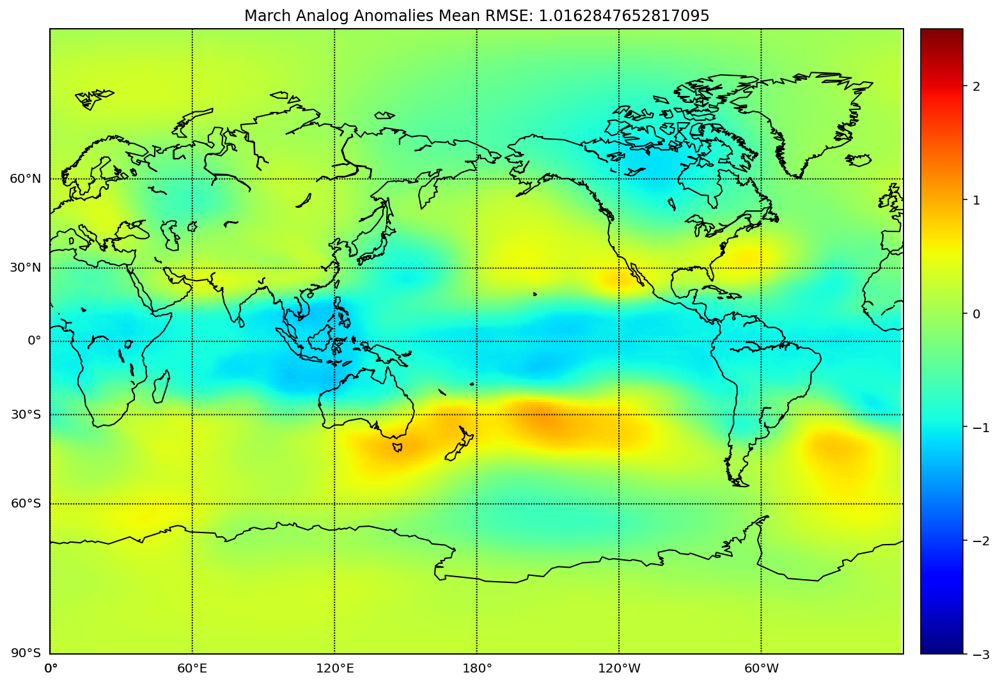

In [0]:
lats = march_analog_anomalies_mean['lat'][:]
lons = march_analog_anomalies_mean['lon'][:]
zg = march_analog_anomalies_mean[:]


plt.figure(figsize=(18,9))
m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
              llcrnrlon=0, urcrnrlon=360, resolution='c')

m.drawcoastlines()
m.drawmapboundary()
m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
m.drawmeridians(np.arange(0.,360., 60.),labels=[0,0,0,1])

x, y = m(*np.meshgrid(lons,lats))

m.pcolormesh(x,y,zg[0, :, :], shading='flat',cmap=plt.cm.jet, vmin = -3, vmax = 2.5)
m.colorbar(location='right', )
plt.title('March Analog Anomalies Mean RMSE: '+ str(err.values))
# plt.savefig(str(i+1) + '_' + str(dates[i])+ '.png')

#April



In [0]:
monthly_data = ds_cesm_500.groupby('time.month').groups
april_data = monthly_data[4]
gs_april=ds_cesm_500.isel(time=april_data)
gs_april

<xarray.Dataset>
Dimensions:    (lat: 192, lon: 288, nbnd: 2, time: 1200)
Coordinates:
  * lat        (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 88.12 89.06 90.0
    lat_bnds   (lat, nbnd) float32 -90.0 -89.52879 -89.52879 ... 89.52879 90.0
  * lon        (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
    lon_bnds   (lon, nbnd) float32 -0.625 0.625 0.625 ... 358.125 359.375
    plev       float64 5e+04
  * time       (time) object 0001-04-15 00:00:00 ... 1200-04-15 00:00:00
    time_bnds  (time, nbnd) object 0001-04-01 00:00:00 ... 1200-05-01 00:00:00
Dimensions without coordinates: nbnd
Data variables:
    zg         (time, lat, lon) float32 4830.6665 4830.6665 ... 5211.2476
Attributes:
    Conventions:            CF-1.7 CMIP-6.2
    activity_id:            CMIP
    branch_method:          standard
    branch_time_in_child:   0.0
    branch_time_in_parent:  48545.0
    case_id:                3
    cesm_casename:          b.e21.B1850.f09_g17.CMIP6-piControl.001
    contact:                cesm_cmip6@ucar.edu
    creation_date:          2019-01-20T22:41:36Z
    data_specs_version:     01.00.29
    experiment:             pre-industrial control
    experiment_id:          piControl
    external_variables:     areacella
    forcing_index:          1
    frequency:              mon
    further_info_url:       https://furtherinfo.es-doc.org/CMIP6.NCAR.CESM2.p...
    grid:                   native 0.9x1.25 finite volume grid (192x288 latxlon)
    grid_label:             gn
    initialization_index:   1
    institution:            National Center for Atmospheric Research, Climate...
    institution_id:         NCAR
    license:                CMIP6 model data produced by <The National Center...
    mip_era:                CMIP6
    model_doi_url:          https://doi.org/10.5065/D67H1H0V
    nominal_resolution:     100 km
    parent_activity_id:     CMIP
    parent_experiment_id:   piControl-spinup
    parent_mip_era:         CMIP6
    parent_source_id:       CESM2
    parent_time_units:      days since 0001-01-01 00:00:00
    parent_variant_label:   r1i1p1f1
    physics_index:          1
    product:                model-output
    realization_index:      1
    realm:                  atmos
    source:                 CESM2 (2017): atmosphere: CAM6 (0.9x1.25 finite v...
    source_id:              CESM2
    source_type:            AOGCM BGC AER
    sub_experiment:         none
    sub_experiment_id:      none
    table_id:               Amon
    tracking_id:            hdl:21.14100/9eddf64a-cf0f-489d-9ce4-8b514e591b1a...
    variable_id:            zg
    variant_info:           CMIP6 CESM2 piControl experiment with CAM6, inter...
    variant_label:          r1i1p1f1
    status:                 2019-10-25;created;by nhn2@columbia.edu

# Plotting March 0500

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7fa111e86390>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7fa111e86710>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7fa111e869e8>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7fa111e86cf8>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7fa111e61048>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa111e61358>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7fa111e61588>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa1108a79b0>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7fa1108a7a58>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7fa1108a7d68>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7fa1108b30b8>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7fa1108b33c8>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7fa1108b36d8>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0500-04-15')

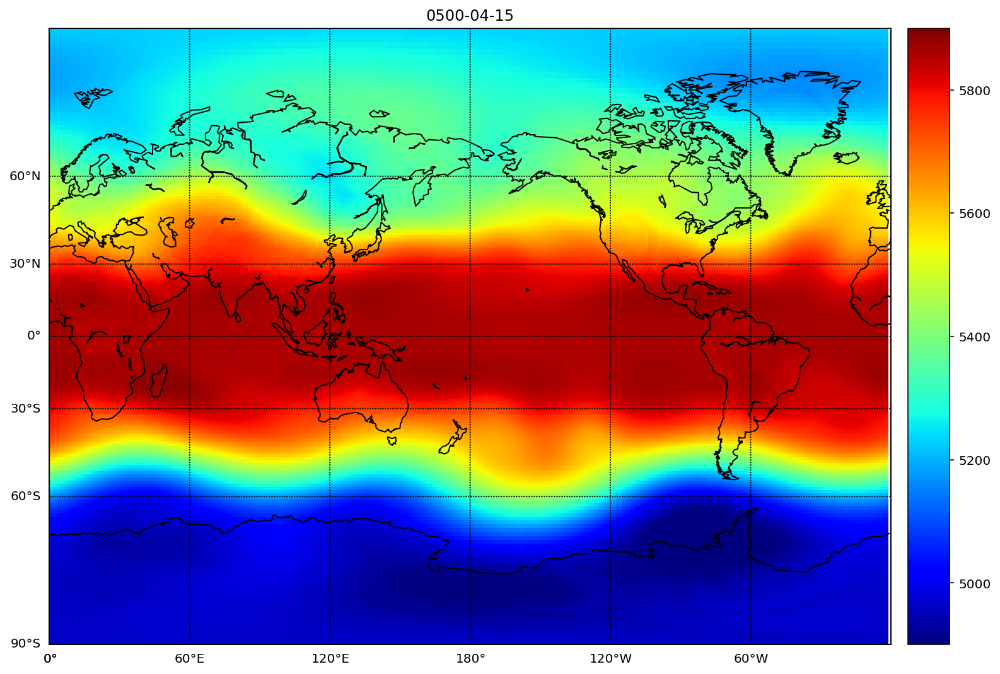

In [0]:
lats = gs_april.variables['lat'][:]
lons = gs_april.variables['lon'][:]
zg = gs_april.variables['zg'][:]


plt.figure(figsize=(18,9))
m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
              llcrnrlon=0, urcrnrlon=360, resolution='c')

m.drawcoastlines()
m.drawmapboundary()
m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
m.drawmeridians(np.arange(0.,360., 60.),labels=[0,0,0,1])

x, y = m(*np.meshgrid(lons,lats))

m.pcolormesh(x,y,zg[499, :, :], shading='flat',cmap=plt.cm.jet, vmin = 4900, vmax = 5900)
m.colorbar(location='right', )
plt.title('0500-04-15')
# plt.savefig(str(i+1) + '_' + str(dates[i])+ '.png')

# Making new dataset of Analog Year

In [0]:
april_analog_1 =  gs_april.sel(time = '0341-04-15')
april_analog_2 =  gs_april.sel(time = '1147-04-15')
april_analog_3 =  gs_april.sel(time = '0943-04-15')
april_analog_4 =  gs_april.sel(time = '0011-04-15')
april_analog_5 =  gs_april.sel(time = '0359-04-15')
april_analog_6 =  gs_april.sel(time = '0705-04-15')
april_analog_7 =  gs_april.sel(time = '0494-04-15')
april_analog_8 =  gs_april.sel(time = '0204-04-15')
april_analog_9 =  gs_april.sel(time = '0127-04-15')
april_analog_10 =  gs_april.sel(time = '0386-04-15')


april_analog = xr.merge([april_analog_1, april_analog_2, april_analog_3, april_analog_4, april_analog_5, april_analog_6, april_analog_7, april_analog_8, april_analog_9, april_analog_10])
april_analog

<xarray.Dataset>
Dimensions:    (lat: 192, lon: 288, nbnd: 2, time: 10)
Coordinates:
  * time       (time) object 0011-04-15 00:00:00 ... 1147-04-15 00:00:00
  * lat        (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 88.12 89.06 90.0
    lat_bnds   (lat, nbnd) float32 -90.0 -89.52879 -89.52879 ... 89.52879 90.0
  * lon        (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
    lon_bnds   (lon, nbnd) float32 -0.625 0.625 0.625 ... 358.125 359.375
    plev       float64 5e+04
    time_bnds  (time, nbnd) object 0011-04-01 00:00:00 ... 1147-05-01 00:00:00
Dimensions without coordinates: nbnd
Data variables:
    zg         (time, lat, lon) float32 4911.7236 4911.7236 ... 5096.7817

# Mean of Analog Year of March

In [0]:
april_analog_mean = april_analog.zg.groupby('time.month').mean()
april_analog_mean

<xarray.DataArray 'zg' (month: 1, lat: 192, lon: 288)>
array([[[4901.505 , 4901.505 , 4901.505 , ..., 4901.505 , 4901.505 ,
         4901.505 ],
        [4903.035 , 4903.112 , 4903.1973, ..., 4902.765 , 4902.8613,
         4902.956 ],
        [4903.1226, 4903.198 , 4903.2705, ..., 4902.971 , 4903.024 ,
         4903.071 ],
        ...,
        [5176.2476, 5176.0303, 5175.8115, ..., 5176.9004, 5176.683 ,
         5176.466 ],
        [5175.4575, 5175.336 , 5175.214 , ..., 5175.8267, 5175.7026,
         5175.5796],
        [5176.0146, 5176.0146, 5176.0146, ..., 5176.014 , 5176.0146,
         5176.0146]]], dtype=float32)
Coordinates:
  * lat      (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 87.17 88.12 89.06 90.0
  * lon      (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
    plev     float64 5e+04
  * month    (month) int64 4

# Calculating RMSE of Mean of Analogs with respect to target year(500)



In [0]:
err = 0
err_1 = (gs_april.zg[499, :, :] - april_analog_mean[0, :, :])**2
err_total = err_1.sum()
err = ((err_total/55296)**(1/2))
err

<xarray.DataArray 'zg' ()>
array(61.63560826)
Coordinates:
    plev     float64 5e+04
    time     object 0500-04-15 00:00:00
    month    int64 4

# Plotting Mean of Analogs of March

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7fa1179dea90>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7fa1179de6d8>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7fa1179dee48>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7fa1179de2b0>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7fa1179b3390>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa1179b37f0>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7fa1179b3748>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa11181f588>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7fa11181fe48>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7fa111cf8080>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7fa111cf89e8>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7fa111cf86d8>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7fa111cf8668>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, 'April Analog Mean RMSE: 61.63560826355589')

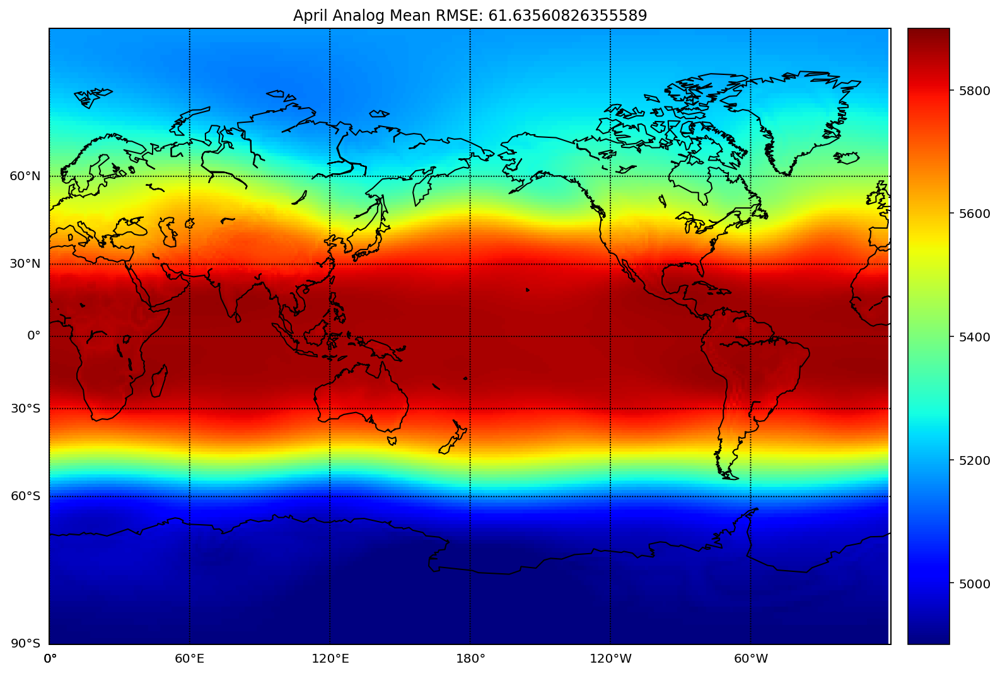

In [0]:
lats = april_analog_mean['lat'][:]
lons = april_analog_mean['lon'][:]
zg = april_analog_mean[:]


plt.figure(figsize=(18,9))
m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
              llcrnrlon=0, urcrnrlon=360, resolution='c')

m.drawcoastlines()
m.drawmapboundary()
m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
m.drawmeridians(np.arange(0.,360., 60.),labels=[0,0,0,1])

x, y = m(*np.meshgrid(lons,lats))

m.pcolormesh(x,y,zg[0, :, :], shading='flat',cmap=plt.cm.jet,  vmin = 4900, vmax = 5900)
m.colorbar(location='right', )
plt.title('April Analog Mean RMSE: '+ str(err.values) )
# plt.savefig(str(i+1) + '_' + str(dates[i])+ '.png')

# Calculating RMSE of Analog year with respect to year 0500 and arranging them in order


In [0]:
import datetime 

rms = []

for i in range(10):
  err = 0
  err_1 = (gs_april.zg[499, :, :] - april_analog.zg[i, :, :])**2
  err_total = err_1.sum()
  err = ((err_total/55296)**(1/2))
  rms.append(err.values)

a = sorted(range(len(rms)), key=lambda i: rms[i])[:10]

dates = [datetime.datetime.strptime(str(april_analog.time[a[i]].values),"%Y-%m-%d %H:%M:%S").date() for i in range(10)] 

for i in range(10):
  print(str(i+1) +' Root mean Square Error of ' + str(dates[i]) + ': ' + str(rms[a[i]]))

1 Root mean Square Error of 0705-04-15: 60.768851384661794
2 Root mean Square Error of 0943-04-15: 70.34807639055849
3 Root mean Square Error of 0494-04-15: 70.97372932733371
4 Root mean Square Error of 1147-04-15: 72.15753246017175
5 Root mean Square Error of 0386-04-15: 74.83674361197475
6 Root mean Square Error of 0204-04-15: 76.96205549562141
7 Root mean Square Error of 0011-04-15: 77.3179238119635
8 Root mean Square Error of 0359-04-15: 79.64947803879102
9 Root mean Square Error of 0127-04-15: 82.5991267553159
10 Root mean Square Error of 0341-04-15: 86.14409090673688


# Plotting Analogs

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7fa111cddda0>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7fa111cdd278>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7fa111cdd828>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7fa111cddb38>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7fa1177059e8>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa117705a58>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7fa117705c50>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa111a0f3c8>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7fa111a0f4a8>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7fa1111105f8>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7fa111110940>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7fa111110e10>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7fa111110518>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0705-04-15 00:00:00 RMS: 60.768851384661794')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7fa1179dfba8>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7fa1179df320>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7fa1179df7b8>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7fa111342a90>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7fa111342278>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa111342cc0>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7fa111342b70>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa1114774a8>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7fa111477390>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7fa11109ff60>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7fa11109fc50>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7fa1113f0828>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7fa1113f0f98>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0943-04-15 00:00:00 RMS: 70.34807639055849')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7fa1119f1d30>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7fa111e409e8>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7fa111e40da0>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7fa111e40d68>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7fa113dc6f60>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa11107a5c0>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7fa11107aac8>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa1114511d0>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7fa117987be0>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7fa117987f98>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7fa11115aa90>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7fa11115a470>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7fa11115a358>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0494-04-15 00:00:00 RMS: 70.97372932733371')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7fa11b4edb70>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7fa111ccf2b0>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7fa11b504630>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7fa111452550>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7fa1111d5b70>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa110fab518>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7fa110fab780>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa111058ba8>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7fa1110582e8>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7fa111058cf8>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7fa111058080>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7fa11198bb70>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7fa11198bf28>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '1147-04-15 00:00:00 RMS: 72.15753246017175')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7fa11085d0b8>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7fa11085d6a0>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7fa110912630>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7fa110912470>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7fa110912d30>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa110874e80>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7fa110874f60>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa111053ef0>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7fa111053fd0>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7fa110efd5f8>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7fa110efdb00>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7fa110efd198>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7fa110efd748>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0386-04-15 00:00:00 RMS: 74.83674361197475')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7fa1120a2588>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7fa1120a2b70>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7fa11146a390>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7fa11146a9e8>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7fa11146a7b8>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa11146a160>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7fa1113bceb8>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa1113b0208>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7fa1113b0278>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7fa1113d6240>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7fa1113d67f0>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7fa1113d6710>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7fa1113d6668>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0204-04-15 00:00:00 RMS: 76.96205549562141')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7fa111b1bef0>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7fa111c072b0>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7fa111c075f8>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7fa111c07940>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7fa111c07c88>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa111c07fd0>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7fa111beb208>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa111bf1940>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7fa111bf1a58>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7fa111bf1da0>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7fa1120e3128>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7fa1120e3470>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7fa1120e37b8>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0011-04-15 00:00:00 RMS: 77.3179238119635')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7fa111a74470>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7fa111a74860>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7fa111a74b38>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7fa111a74e48>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7fa111a80198>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa111a804a8>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7fa111a80668>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa111a8d630>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7fa111a8dbe0>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7fa111a8def0>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7fa110ac1240>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7fa110ac1550>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7fa110ac1860>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0359-04-15 00:00:00 RMS: 79.64947803879102')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7fa111f514e0>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7fa111f51860>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7fa111f51b38>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7fa111f51e48>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7fa111f42198>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa111f424a8>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7fa111f426d8>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa111c4eb00>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7fa111c4eba8>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7fa111c4eeb8>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7fa111c3b208>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7fa111c3b518>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7fa111c3b828>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0127-04-15 00:00:00 RMS: 82.5991267553159')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7fa1107ba4a8>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7fa1107ba828>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7fa1107bab00>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7fa1107bae10>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7fa110a90160>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa110a90470>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7fa110a906a0>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa110a5dac8>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7fa110a5db70>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7fa110a5de80>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7fa110a711d0>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7fa110a714e0>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7fa110a717f0>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0341-04-15 00:00:00 RMS: 86.14409090673688')

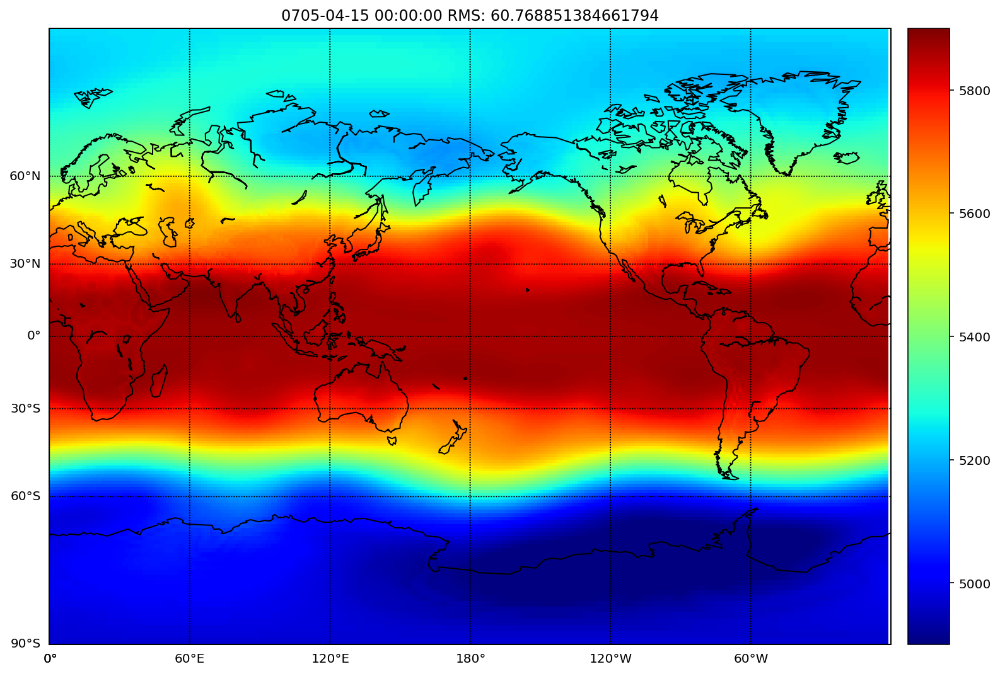

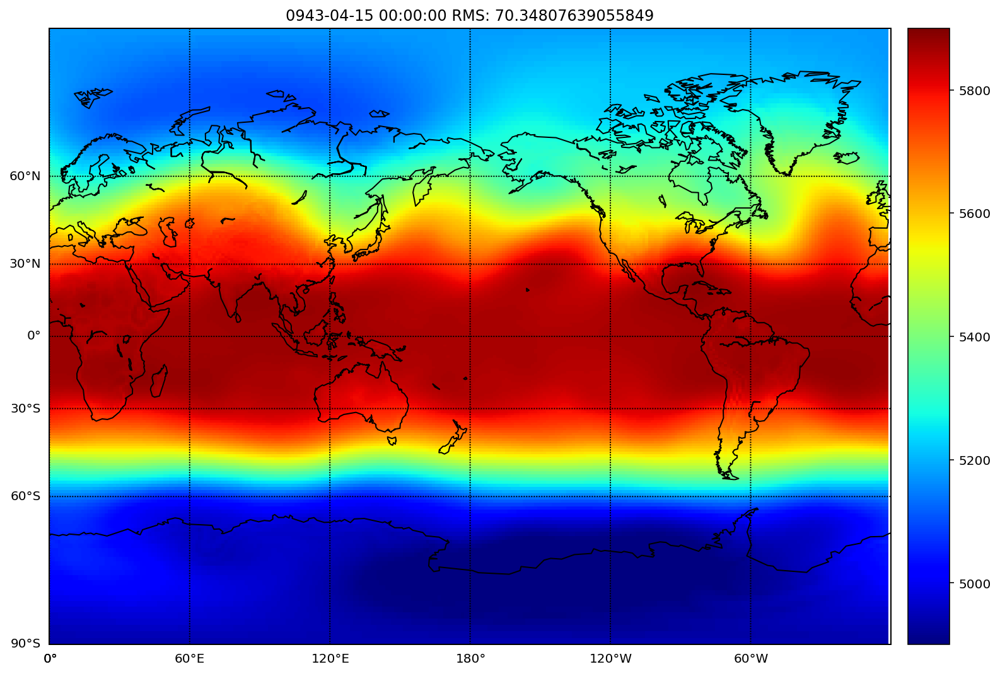

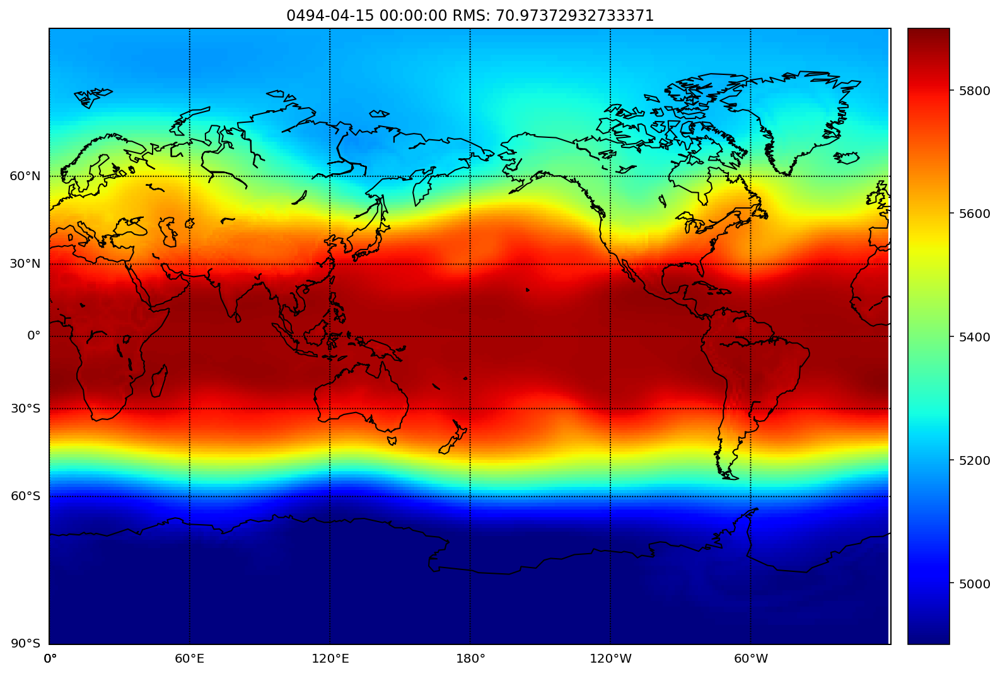

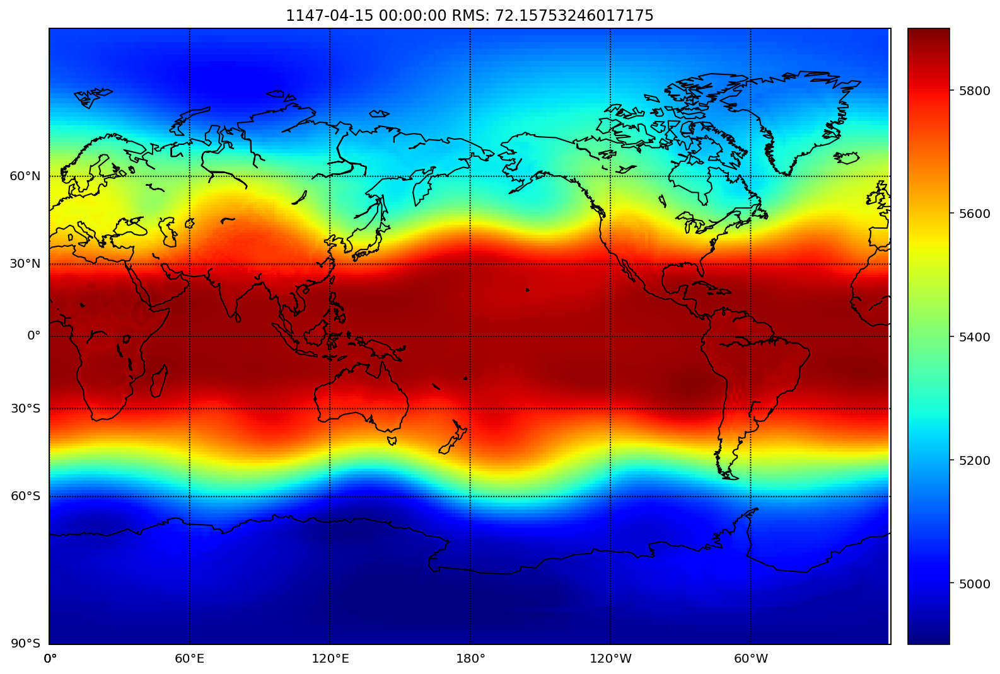

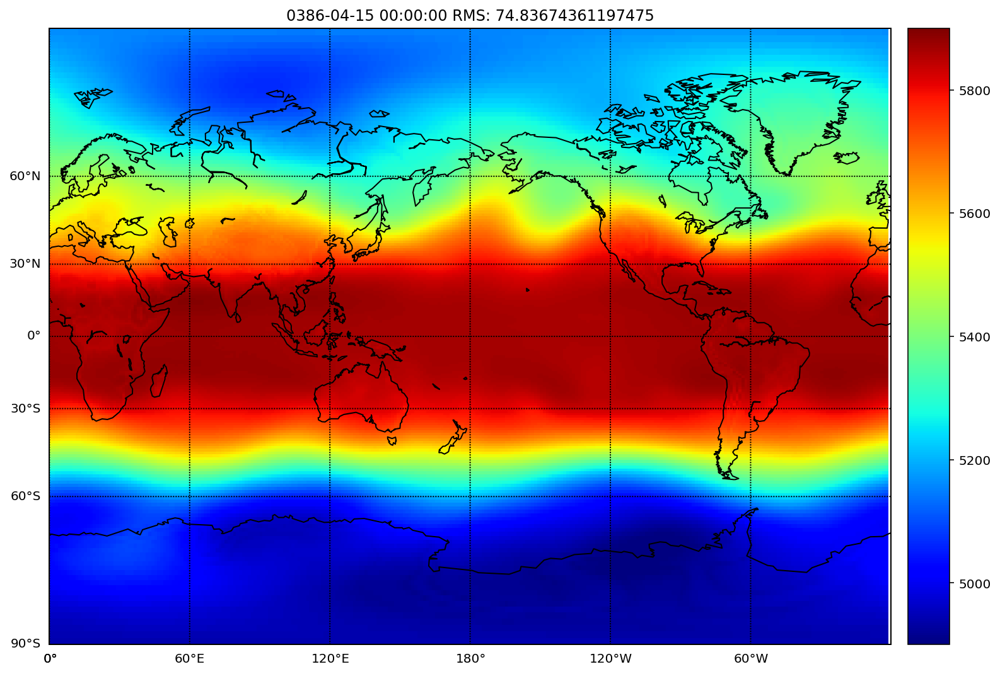

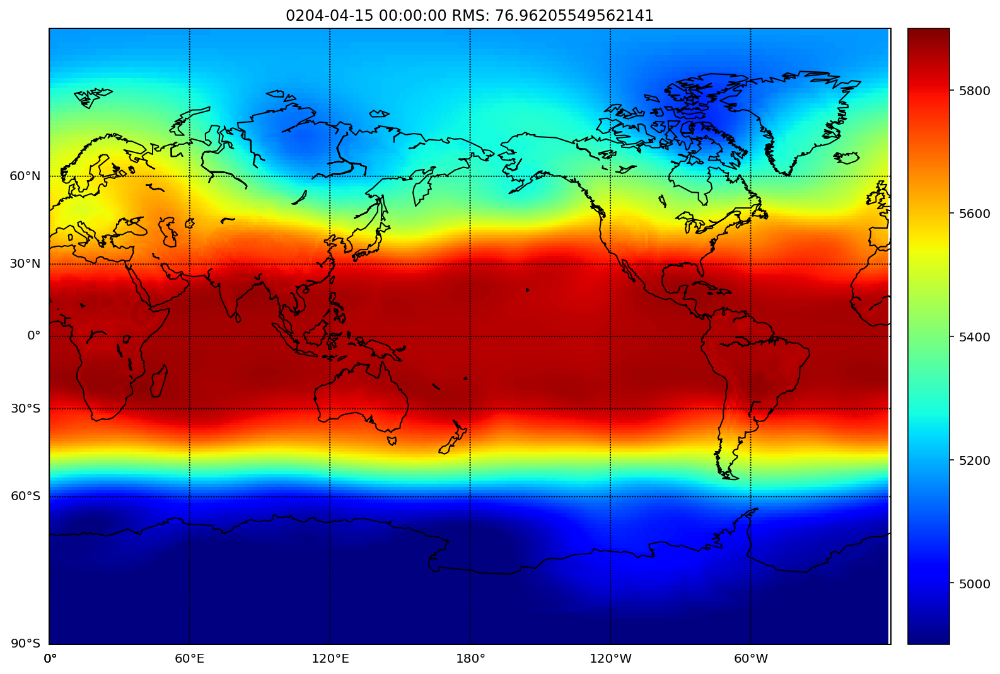

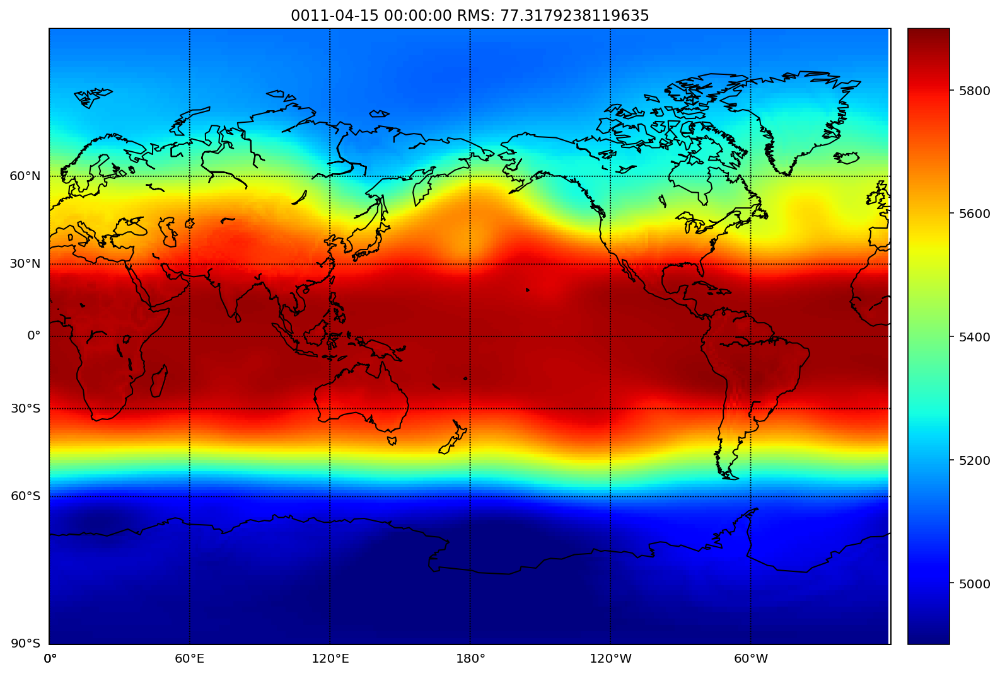

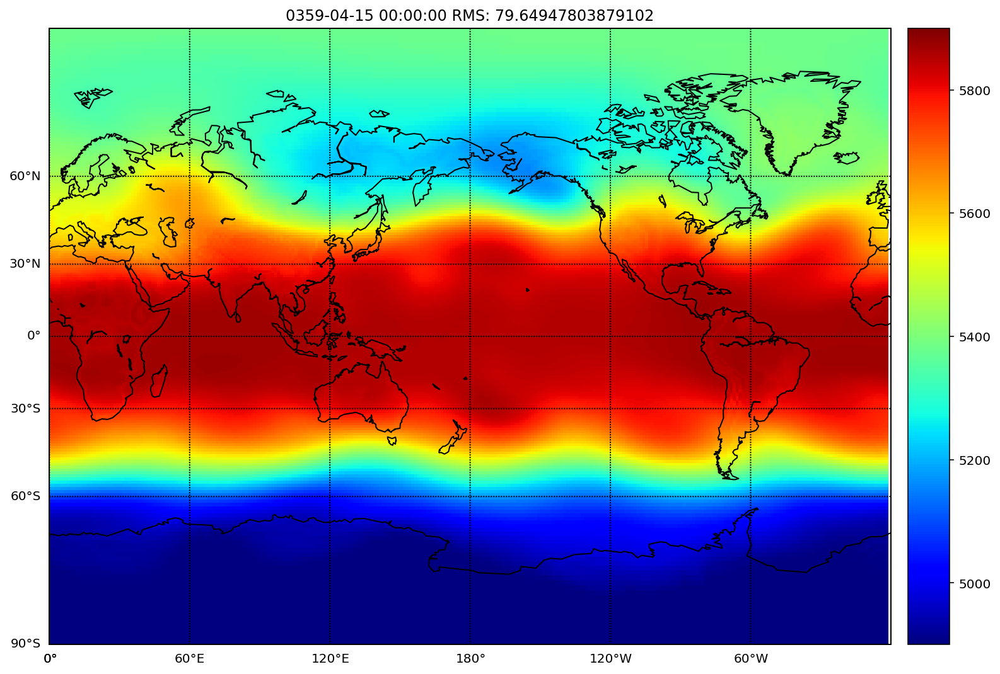

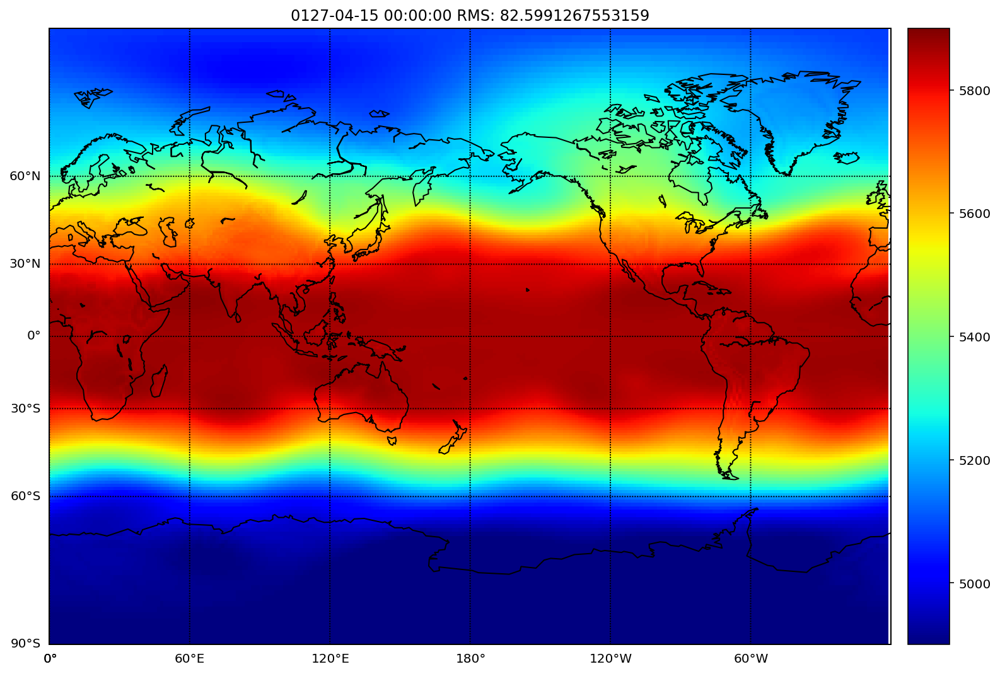

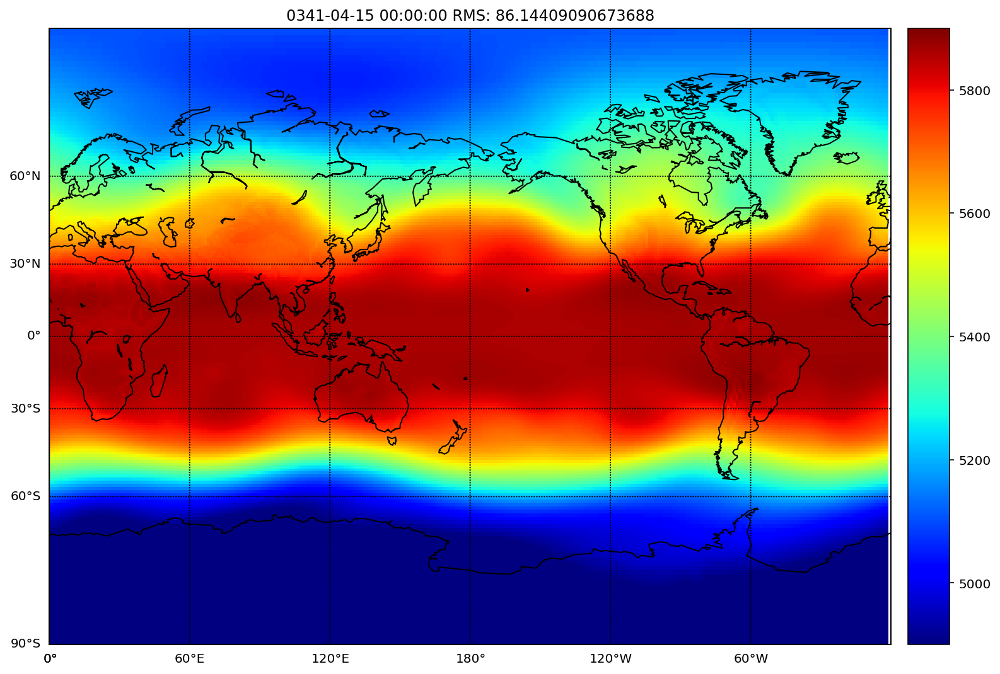

In [0]:
lats = april_analog.variables['lat'][:]
lons = april_analog.variables['lon'][:]
zg = april_analog.variables['zg'][:]

for i in range(10):
  plt.figure(figsize=(18,9))
  m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
                llcrnrlon=0, urcrnrlon=360, resolution='c')

  m.drawcoastlines()
  m.drawmapboundary()
  m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
  m.drawmeridians(np.arange(0.,360., 60.),labels=[0,0,0,1])

  x, y = m(*np.meshgrid(lons,lats))

  m.pcolormesh(x,y,zg[a[i], :, :], shading='flat',cmap=plt.cm.jet,  vmin = 4900, vmax = 5900)
  m.colorbar(location='right', )
  plt.title(str(april_analog.time[a[i]].values)+ ' RMS: ' + str(rms[a[i]]))
  # plt.savefig(str(i+1) + '_' + str(dates[i])+ '.png')

# Calculating STD and Mean of March


In [0]:
gs_april_std = gs_april.groupby('time.month').std()
gs_april_mean = gs_april.groupby('time.month').mean()

# Plotting STD of March

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7fa11150fc18>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7fa111e345c0>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7fa11151da58>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7fa111aa6ba8>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7fa1119f1e80>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa117987ac8>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7fa1179807f0>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa111084128>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7fa1110840b8>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7fa11145e7f0>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7fa111bf7cc0>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7fa111bf7cf8>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7fa111b4f2b0>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, 'April STD')

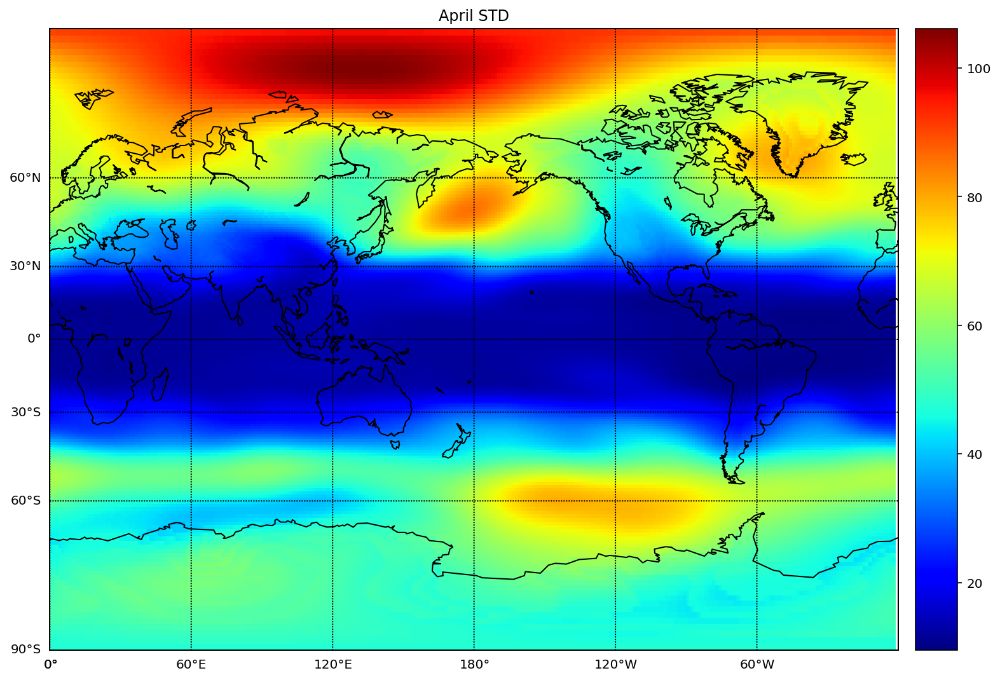

In [0]:
lats = gs_april_std.variables['lat'][:]
lons = gs_april_std.variables['lon'][:]
zg = gs_april_std.variables['zg'][:]


plt.figure(figsize=(18,9))
m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
              llcrnrlon=0, urcrnrlon=360, resolution='c')

m.drawcoastlines()
m.drawmapboundary()
m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
m.drawmeridians(np.arange(0.,360., 60.),labels=[0,0,0,1])

x, y = m(*np.meshgrid(lons,lats))

m.pcolormesh(x,y,zg[0, :, :], shading='flat',cmap=plt.cm.jet)
m.colorbar(location='right', )
plt.title('April STD')
# plt.savefig(str(i+1) + '_' + str(dates[i])+ '.png')

# Calculating RMSE of Mean March with respect to target year(0500)

In [0]:
err = 0
err_1 = (gs_april.zg[499, :, :] - gs_april_mean.zg[0, :, :])**2
err_total = err_1.sum()
err = ((err_total/55296)**(1/2))
err

<xarray.DataArray 'zg' ()>
array(60.2885855)
Coordinates:
    plev     float64 5e+04
    time     object 0500-04-15 00:00:00
    month    int64 4

# Plottting Mean March

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7fa110645eb8>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7fa110650278>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7fa1106505c0>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7fa110650908>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7fa110650c50>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa110650f98>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7fa1106591d0>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa110667908>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7fa110667a20>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7fa110667d68>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7fa11066f0f0>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7fa11066f438>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7fa11066f780>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, 'April Mean RMSE: 60.28858550062911')

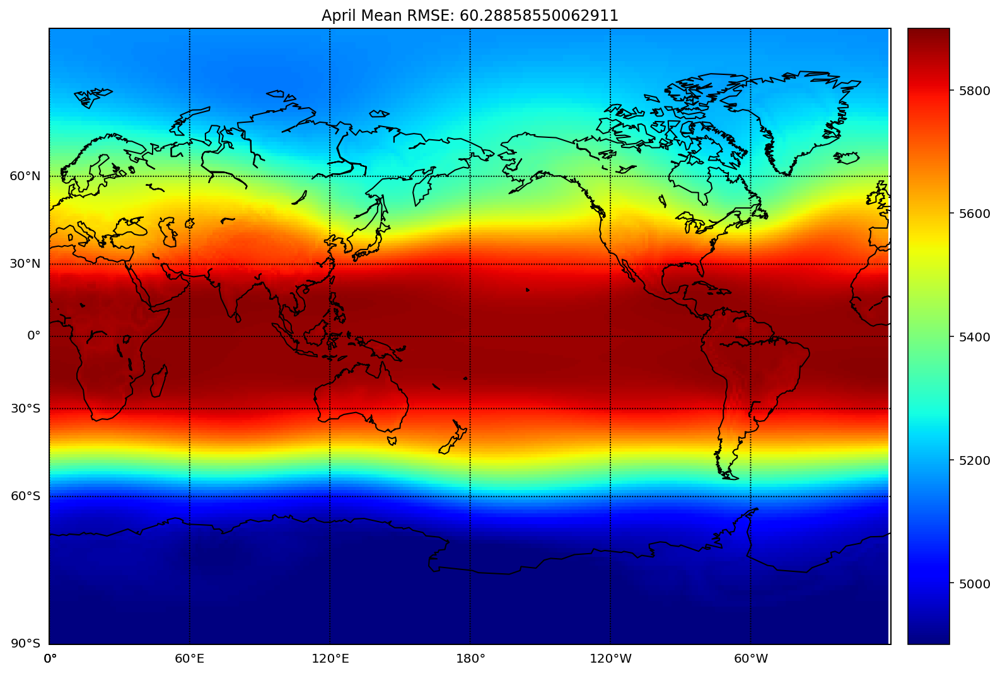

In [0]:
lats = gs_april_mean.variables['lat'][:]
lons = gs_april_mean.variables['lon'][:]
zg = gs_april_mean.variables['zg'][:]


plt.figure(figsize=(18,9))
m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
              llcrnrlon=0, urcrnrlon=360, resolution='c')

m.drawcoastlines()
m.drawmapboundary()
m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
m.drawmeridians(np.arange(0.,360., 60.),labels=[0,0,0,1])

x, y = m(*np.meshgrid(lons,lats))

m.pcolormesh(x,y,zg[0, :, :], shading='flat',cmap=plt.cm.jet,  vmin = 4900, vmax = 5900)
m.colorbar(location='right', )
plt.title('April Mean RMSE: ' + str(err.values))
# plt.savefig(str(i+1) + '_' + str(dates[i])+ '.png')

# April Persistence

In [0]:
april_persistence_1 =  new_monthly_anomalies_jan.sel(time = '0500-01-15')
april_persistence = (april_persistence_1.zg[0] * gs_april_std.zg[0]) + gs_april_mean.zg[0]
april_persistence

<xarray.DataArray 'zg' (lat: 192, lon: 288, month: 1)>
array([[[4854.1235],
        [4854.1235],
        [4854.1235],
        ...,
        [4854.1235],
        [4854.1235],
        [4854.1235]],

       [[4856.546 ],
        [4856.5894],
        [4856.65  ],
        ...,
        [4856.3657],
        [4856.428 ],
        [4856.484 ]],

       [[4856.5864],
        [4856.9243],
        [4857.223 ],
        ...,
        [4855.4126],
        [4855.833 ],
        [4856.2173]],

       ...,

       [[5287.4487],
        [5287.7603],
        [5288.05  ],
        ...,
        [5286.4956],
        [5286.821 ],
        [5287.14  ]],

       [[5279.5103],
        [5279.7036],
        [5279.8916],
        ...,
        [5278.9087],
        [5279.12  ],
        [5279.309 ]],

       [[5274.985 ],
        [5274.985 ],
        [5274.985 ],
        ...,
        [5274.9873],
        [5274.9844],
        [5274.9873]]], dtype=float32)
Coordinates:
  * month    (month) int64 3
    plev     float64 5e+04
  * lat      (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 87.17 88.12 89.06 90.0
  * lon      (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
    time     object 0500-03-15 12:00:00

# Calculating RMSE of March Persistence with respect to target year(0500)

In [0]:
err = 0
err_1 = (gs_april.zg[499, :, :] - april_persistence[:, :, 0])**2
err_total = err_1.sum()
err = ((err_total/55296)**(1/2))
err

<xarray.DataArray 'zg' ()>
array(70.27892511)
Coordinates:
    plev     float64 5e+04
    month    int64 3

# Plotting April Persistence

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7fa1105a9550>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7fa1105a98d0>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7fa1105a9c18>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7fa1105a9f60>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7fa1105b52e8>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa1105b5630>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7fa1105b5828>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa1104a4f60>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7fa1104ad0b8>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7fa1104ad400>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7fa1104ad748>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7fa1104ada90>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7fa1104addd8>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, 'April Persistence RMSE: 70.27892511140743')

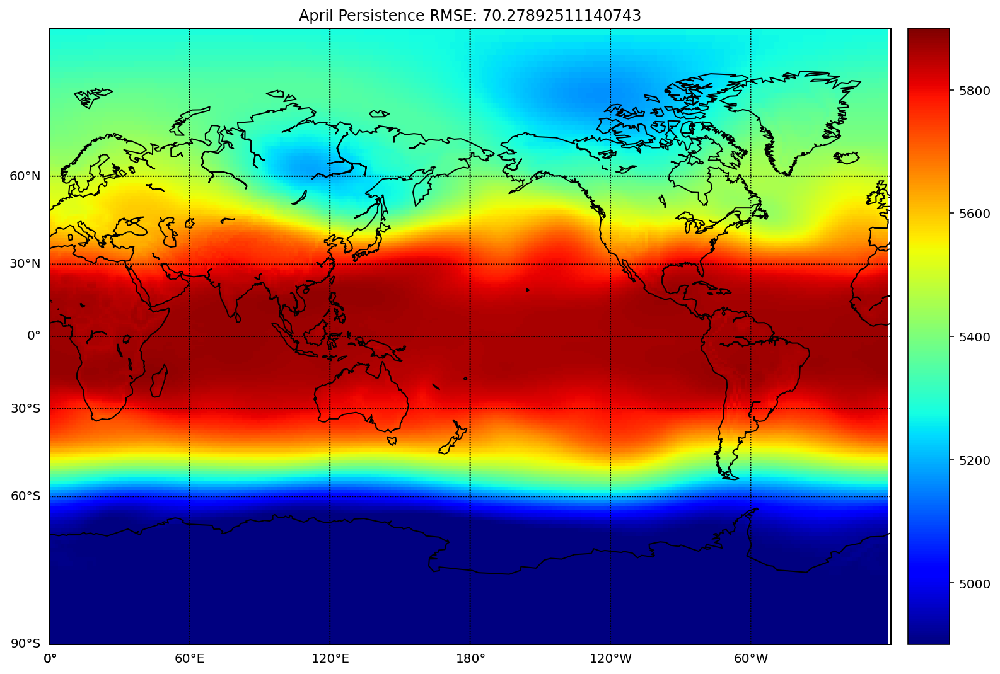

In [0]:
lats = april_persistence['lat'][:]
lons = april_persistence['lon'][:]
zg = april_persistence[:]


plt.figure(figsize=(18,9))
m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
              llcrnrlon=0, urcrnrlon=360, resolution='c')

m.drawcoastlines()
m.drawmapboundary()
m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
m.drawmeridians(np.arange(0.,360., 60.),labels=[0,0,0,1])

x, y = m(*np.meshgrid(lons,lats))

m.pcolormesh(x,y,zg[:, :, 0], shading='flat',cmap=plt.cm.jet,  vmin = 4900, vmax = 5900)
m.colorbar(location='right', )
plt.title('April Persistence RMSE: ' + str(err.values))
# plt.savefig(str(i+1) + '_' + str(dates[i])+ '.png')

# Monthly Anomalies of April

In [0]:
april_monthly_anomalies = (gs_april.groupby('time.month') - gs_april.groupby('time.month').mean())/gs_april.groupby('time.month').std()
april_monthly_anomalies

<xarray.Dataset>
Dimensions:    (lat: 192, lon: 288, month: 1, nbnd: 2, time: 1200)
Coordinates:
    lon_bnds   (lon, nbnd) float32 -0.625 0.625 0.625 ... 358.125 359.375
  * month      (month) int64 4
    plev       float64 5e+04
    lat_bnds   (lat, nbnd) float32 -90.0 -89.52879 -89.52879 ... 89.52879 90.0
  * lat        (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 88.12 89.06 90.0
  * lon        (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
  * time       (time) object 0001-04-15 00:00:00 ... 1200-04-15 00:00:00
    time_bnds  (time, nbnd) object 0001-04-01 00:00:00 ... 1200-05-01 00:00:00
Dimensions without coordinates: nbnd
Data variables:
    zg         (time, lat, lon, month) float32 -1.3538426 ... 0.46173155

# Plotting target year April(0500)

# Making new dataset of Analog Year

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7fa10fcda748>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7fa10fcdaac8>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7fa10fcdada0>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7fa10fb740f0>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7fa10fb74400>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa10fb74710>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7fa10fb74940>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa10fb6ad68>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7fa10fb6ae10>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7fa10fb86160>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7fa10fb86470>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7fa10fb86780>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7fa10fb86a90>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0500-04-15 00:00:00')

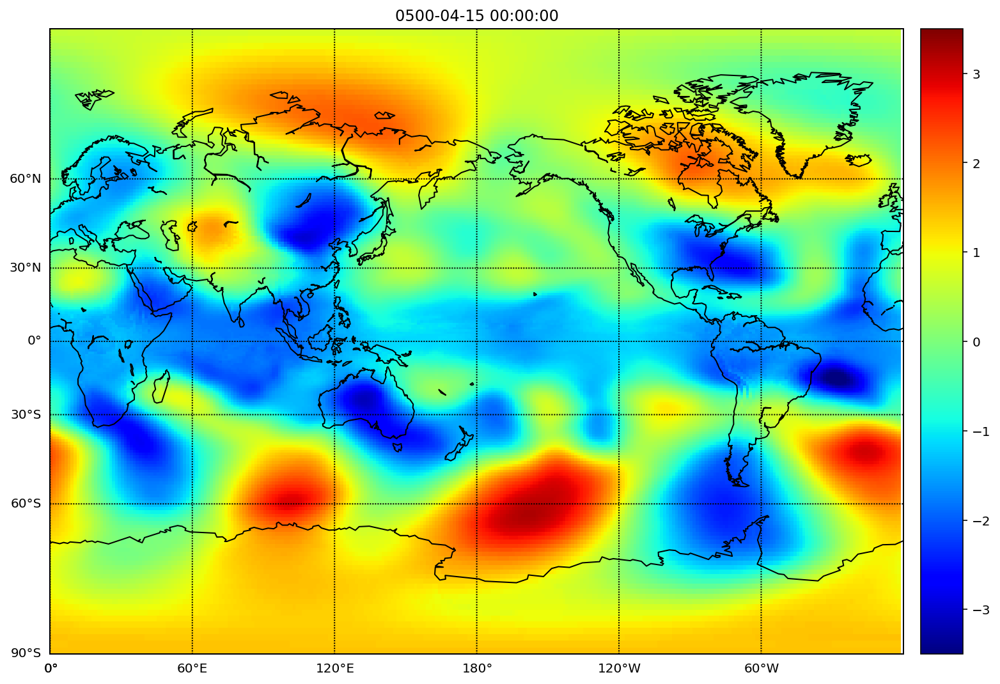

In [0]:
lats = april_monthly_anomalies.variables['lat'][:]
lons = april_monthly_anomalies.variables['lon'][:]
zg = april_monthly_anomalies.variables['zg'][:]

plt.figure(figsize=(18,9))
m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
              llcrnrlon=0, urcrnrlon=360, resolution='c')

m.drawcoastlines()
m.drawmapboundary()
m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
m.drawmeridians(np.arange(0.,360., 60.),labels=[0,0,0,1])

x, y = m(*np.meshgrid(lons,lats))

m.pcolormesh(x,y,zg[499, :, :, 0], shading='flat',cmap=plt.cm.jet, vmin = -3.5, vmax = 3.5)
m.colorbar(location='right', )
plt.title(april_monthly_anomalies.time[499].values)
# plt.savefig(str(i+1) + '_' + str(dates[i])+ '.png')

# Making new dataset of Analog Year

In [0]:
april_analog_anomalies_1 =  april_monthly_anomalies.sel(time = '0341-04-15')
april_analog_anomalies_2 =  april_monthly_anomalies.sel(time = '1147-04-15')
april_analog_anomalies_3 =  april_monthly_anomalies.sel(time = '0943-04-15')
april_analog_anomalies_4 =  april_monthly_anomalies.sel(time = '0011-04-15')
april_analog_anomalies_5 =  april_monthly_anomalies.sel(time = '0359-04-15')
april_analog_anomalies_6 =  april_monthly_anomalies.sel(time = '0705-04-15')
april_analog_anomalies_7 =  april_monthly_anomalies.sel(time = '0494-04-15')
april_analog_anomalies_8 =  april_monthly_anomalies.sel(time = '0204-04-15')
april_analog_anomalies_9 =  april_monthly_anomalies.sel(time = '0127-04-15')
april_analog_anomalies_10 =  april_monthly_anomalies.sel(time = '0386-04-15')


april_analog_anomalies = xr.merge([april_analog_anomalies_1, april_analog_anomalies_2, april_analog_anomalies_3, april_analog_anomalies_4, april_analog_anomalies_5, april_analog_anomalies_6, april_analog_anomalies_7, april_analog_anomalies_8, april_analog_anomalies_9, april_analog_anomalies_10])
april_analog_anomalies

NameError: ignored

# Calculating RMSE with respect to target year(0500) and arranging them in order

In [0]:
import datetime 

rms = []

for i in range(10):
  err = 0
  err_1 = (april_monthly_anomalies.zg[499, :, :] - april_analog_anomalies.zg[i, :, :])**2
  err_total = err_1.sum()
  err = ((err_total/55296)**(1/2))
  rms.append(err.values)

a = sorted(range(len(rms)), key=lambda i: rms[i])[:10]

dates = [datetime.datetime.strptime(str(april_analog_anomalies.time[a[i]].values),"%Y-%m-%d %H:%M:%S").date() for i in range(10)] 

for i in range(10):
  print(str(i+1) +' Root mean Square Error of ' + str(dates[i]) + ': ' + str(rms[a[i]]))

1 Root mean Square Error of 0705-04-15: 1.23822693828784
2 Root mean Square Error of 1147-04-15: 1.2988731586804367
3 Root mean Square Error of 0943-04-15: 1.3226120966144588
4 Root mean Square Error of 0011-04-15: 1.400921406364747
5 Root mean Square Error of 0494-04-15: 1.4045638159496658
6 Root mean Square Error of 0386-04-15: 1.414565179477687
7 Root mean Square Error of 0127-04-15: 1.4181919239484084
8 Root mean Square Error of 0204-04-15: 1.4315201224486778
9 Root mean Square Error of 0359-04-15: 1.4788979060809453
10 Root mean Square Error of 0341-04-15: 1.6075465498739294


# Plotting April monthly anomalies

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7fa111f514e0>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7fa111f519b0>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7fa111f512b0>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7fa111ae9550>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7fa11057e208>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa111a02b00>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7fa111a02860>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa11798c588>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7fa111c26a20>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7fa111c261d0>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7fa111c26cc0>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7fa111c26f60>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7fa111c26198>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0705-04-15 00:00:00 RMSE: 1.23822693828784')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7fa10fd94860>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7fa110bdc390>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7fa112086eb8>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7fa1120863c8>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7fa112086c18>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa110ca7ac8>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7fa110ca7a20>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa1115f55f8>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7fa111f4e390>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7fa111f4efd0>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7fa11043cda0>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7fa11043c358>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7fa11043c208>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '1147-04-15 00:00:00 RMSE: 1.2988731586804367')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7fa11134e128>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7fa11134ec50>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7fa11134e198>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7fa11134eb70>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7fa11098f630>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa11098f860>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7fa11098f710>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa1120a2438>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7fa1120a2668>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7fa1113200b8>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7fa111320a58>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7fa111320908>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7fa1113206a0>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0943-04-15 00:00:00 RMSE: 1.3226120966144588')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7fa111882eb8>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7fa111a0fe80>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7fa111a0f7f0>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7fa1176e57f0>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7fa110de57b8>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa110918c88>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7fa110918278>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa111816e48>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7fa1103846a0>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7fa110384470>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7fa111295208>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7fa111295588>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7fa111295908>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0011-04-15 00:00:00 RMSE: 1.400921406364747')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7fa111375d68>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7fa111375780>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7fa110727320>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7fa110727eb8>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7fa110727128>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa110727710>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7fa1107276d8>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa111bee438>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7fa111bee978>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7fa111bee780>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7fa111bee9e8>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7fa117a79550>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7fa110fab048>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0494-04-15 00:00:00 RMSE: 1.4045638159496658')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7fa11115a3c8>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7fa11115a588>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7fa111f3cb38>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7fa111f3c320>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7fa111f3c550>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa111f3c898>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7fa111f3cb70>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa10f92f2b0>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7fa10f92f898>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7fa10f92ffd0>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7fa11130cf60>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7fa11130c5c0>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7fa11130c0f0>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0386-04-15 00:00:00 RMSE: 1.414565179477687')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7fa1112ceb70>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7fa1112cef60>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7fa1112ce8d0>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7fa10f924710>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7fa10f9244e0>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa10f924668>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7fa10f924b00>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa111dc9198>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7fa1110c4eb8>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7fa1110c4940>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7fa1107b2ba8>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7fa1107b2e48>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7fa1107b25f8>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0127-04-15 00:00:00 RMSE: 1.4181919239484084')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7fa1120e61d0>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7fa1120e6b38>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7fa1120e6a58>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7fa1120e6128>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7fa111bdf828>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa11098cc50>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7fa11098ccc0>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa110977b00>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7fa1109777f0>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7fa1111dd0b8>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7fa1111ddd68>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7fa10fa3a7b8>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7fa10fa3a358>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0204-04-15 00:00:00 RMSE: 1.4315201224486778')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7fa1106c4a90>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7fa1113b08d0>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7fa1113b0b70>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7fa1113b0b00>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7fa111537160>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa111537048>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7fa111537908>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa1109d6be0>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7fa1109d6710>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7fa1109d69e8>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7fa1113a41d0>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7fa1113a4588>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7fa1113a4e80>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0359-04-15 00:00:00 RMSE: 1.4788979060809453')

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7fa111b584a8>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7fa111b58828>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7fa111b58b70>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7fa111b58eb8>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7fa111b6f240>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa111b6f588>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7fa111b6f780>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa10f947eb8>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7fa10f947fd0>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7fa10f91f358>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7fa10f91f6a0>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7fa10f91f9e8>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7fa10f91fd30>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, '0341-04-15 00:00:00 RMSE: 1.6075465498739294')

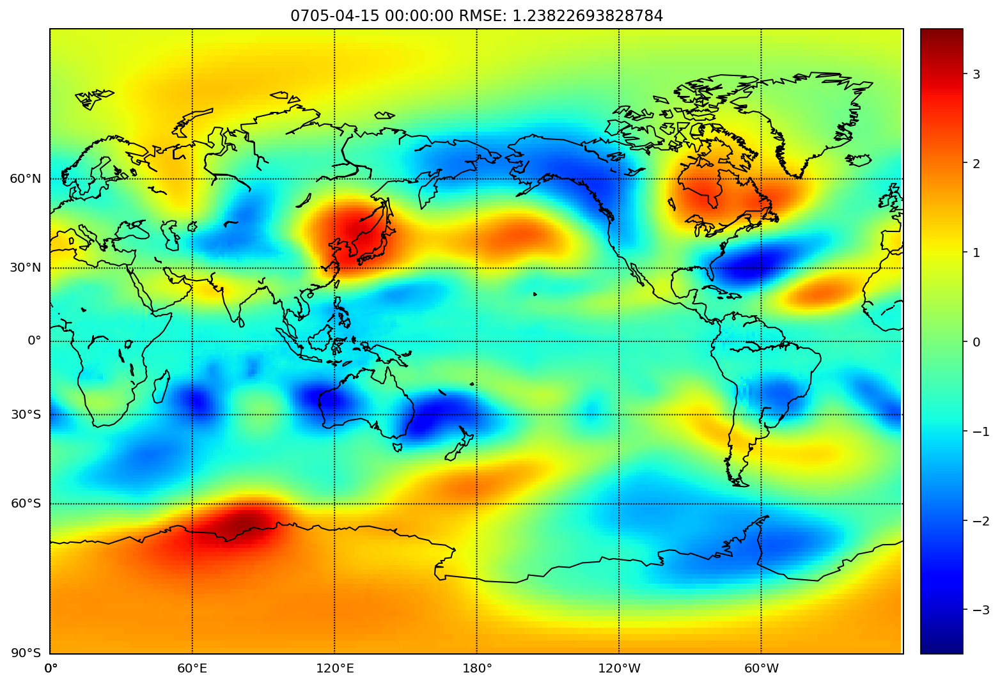

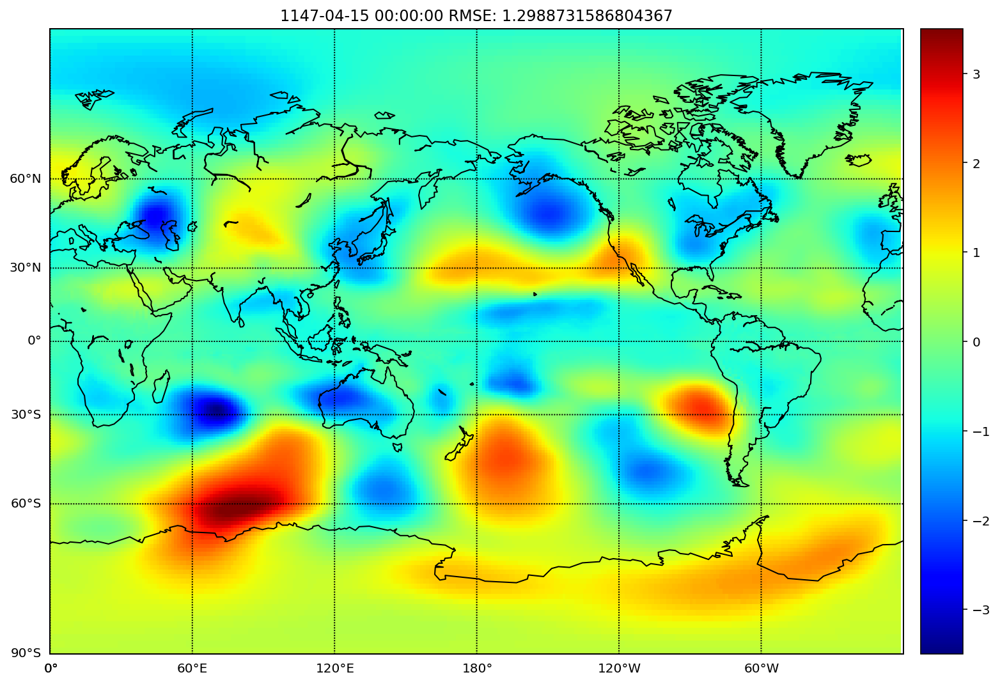

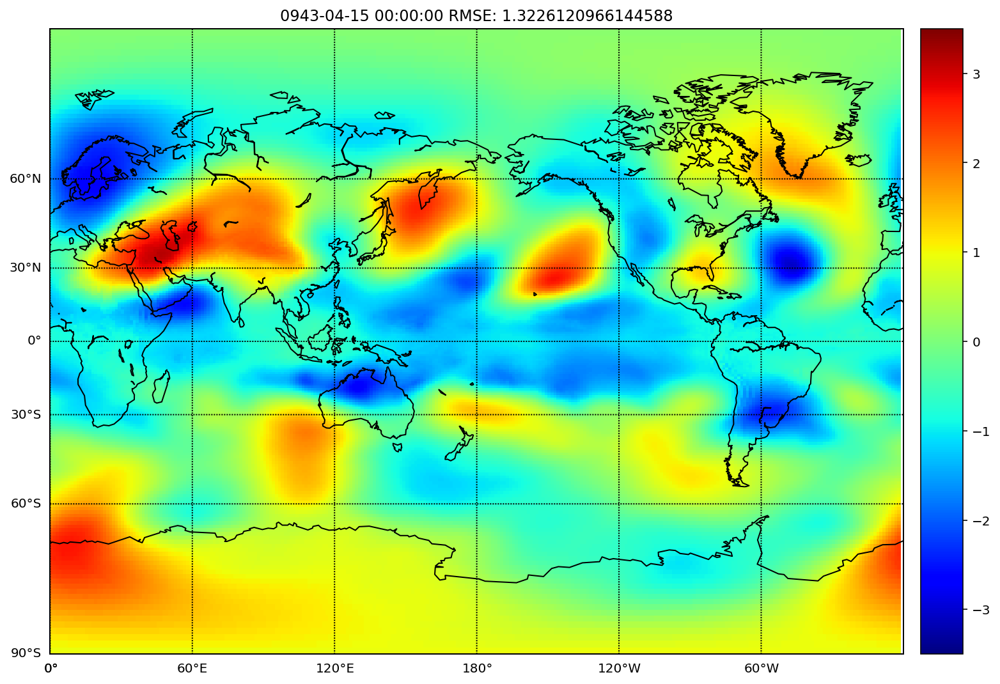

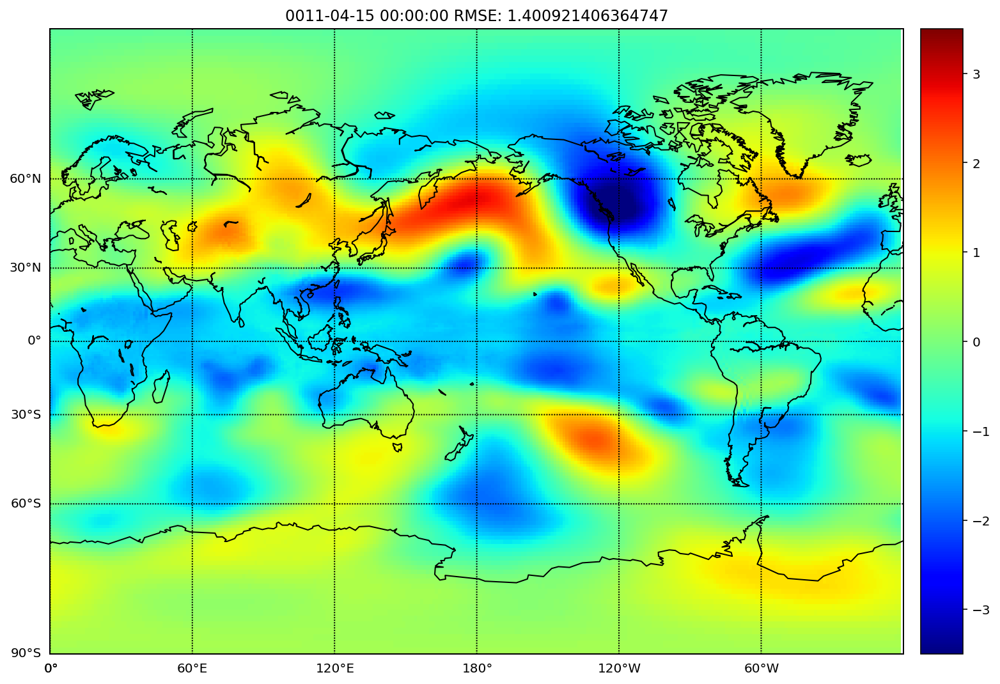

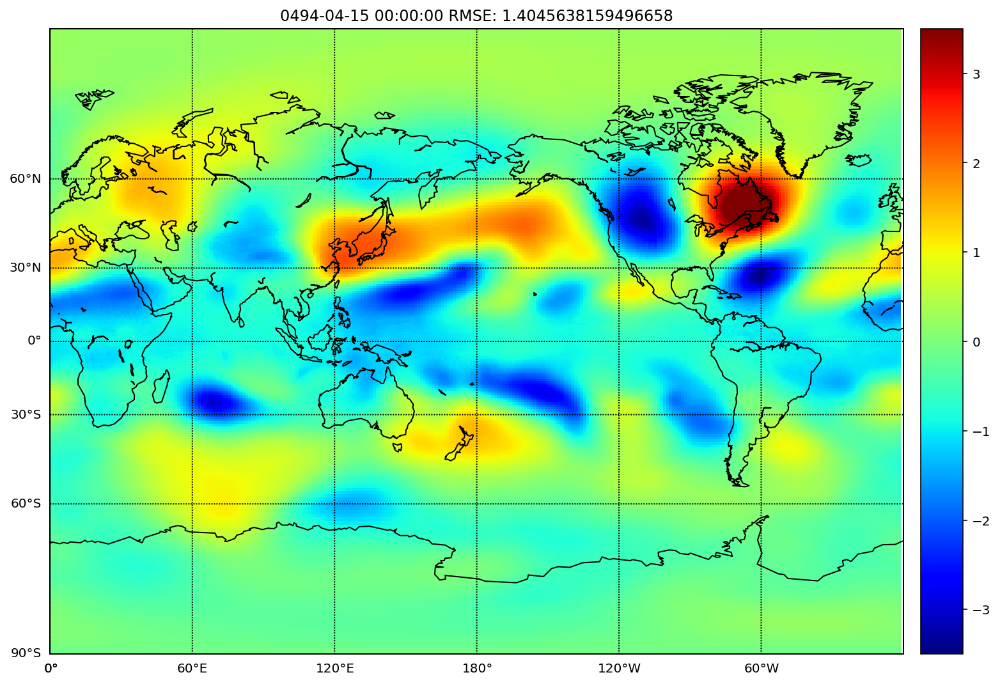

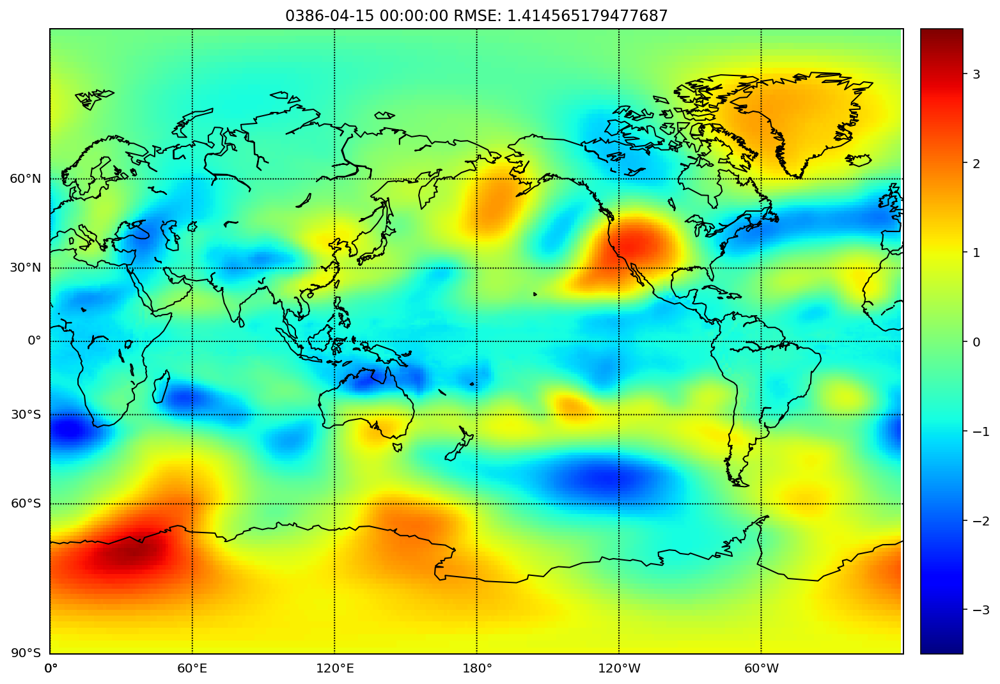

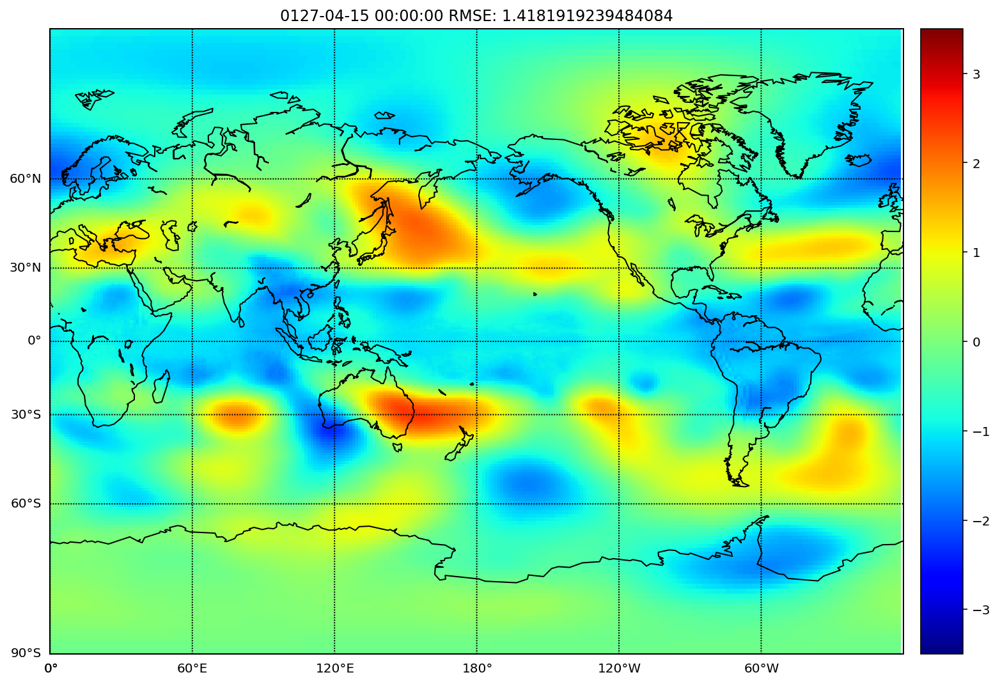

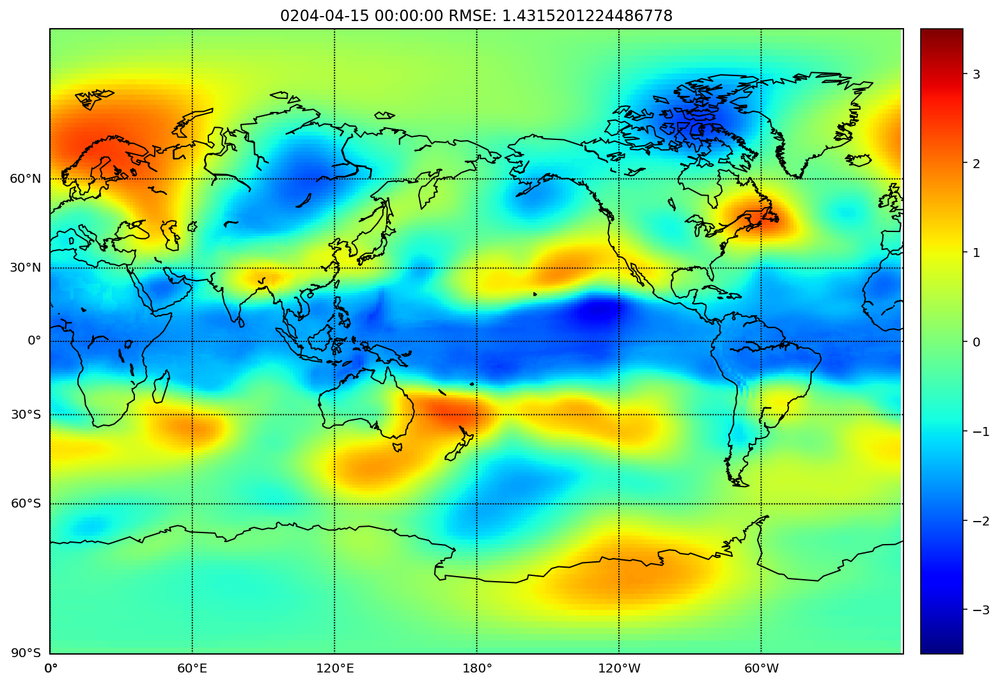

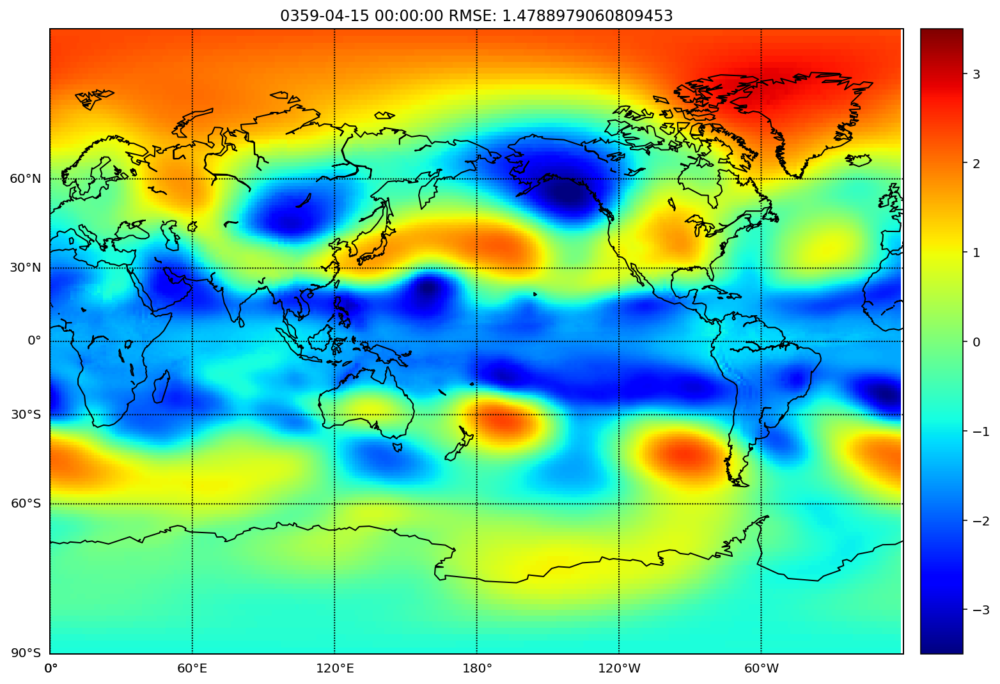

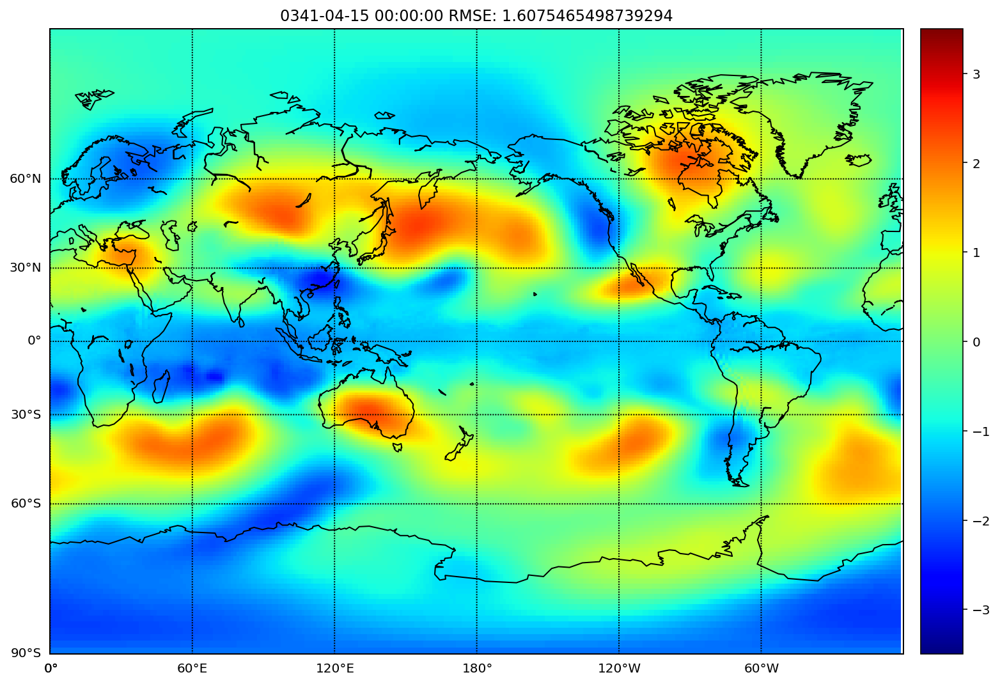

In [0]:
lats = april_analog_anomalies.variables['lat'][:]
lons = april_analog_anomalies.variables['lon'][:]
zg = april_analog_anomalies.variables['zg'][:]

for i in range(10):
  plt.figure(figsize=(18,9))
  m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
                llcrnrlon=0, urcrnrlon=360, resolution='c')

  m.drawcoastlines()
  m.drawmapboundary()
  m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
  m.drawmeridians(np.arange(0.,360., 60.),labels=[0,0,0,1])

  x, y = m(*np.meshgrid(lons,lats))

  m.pcolormesh(x,y,zg[a[i], :, :, 0], shading='flat',cmap=plt.cm.jet, vmin = -3.5, vmax = 3.5)
  m.colorbar(location='right', )
  plt.title(str(april_analog_anomalies.time[a[i]].values) + ' RMSE: ' + str(rms[a[i]]))
  # plt.savefig(str(i+1) + '_' + str(dates[i])+ '.png')

# April Analogs Mean

In [0]:
april_analog_anomalies_mean = april_analog_anomalies.zg.groupby('time.month').mean()
april_analog_anomalies_mean

<xarray.DataArray 'zg' (month: 1, lat: 192, lon: 288)>
array([[[0.13549204, 0.13549204, 0.13549204, ..., 0.13549204,
         0.13549204, 0.13549204],
        [0.14119847, 0.14121017, 0.14108752, ..., 0.14139241,
         0.14141163, 0.14144449],
        [0.16261761, 0.1622831 , 0.16156211, ..., 0.1623749 ,
         0.16292387, 0.16302647],
        ...,
        [0.09226409, 0.09146268, 0.09072398, ..., 0.09441424,
         0.09370686, 0.09296593],
        [0.08641539, 0.08617026, 0.08593891, ..., 0.08729558,
         0.08690576, 0.08671977],
        [0.08292685, 0.08292685, 0.08292688, ..., 0.08292635,
         0.0829269 , 0.0829269 ]]], dtype=float32)
Coordinates:
  * month    (month) int64 4
    plev     float64 5e+04
  * lat      (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 87.17 88.12 89.06 90.0
  * lon      (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8

# RMSE of April Analogz Mean with respect to target april(0500-03)

In [0]:
err = 0
err_1 = (april_monthly_anomalies.zg[499, :, :] - april_analog_anomalies_mean[0, :, :])**2
err_total = err_1.sum()
err = ((err_total/55296)**(1/2))
err

<xarray.DataArray 'zg' ()>
array(1.13223458)
Coordinates:
    plev     float64 5e+04
    time     object 0500-04-15 00:00:00

# Plotting April Anomalies Analog Mean

<Figure size 1296x648 with 0 Axes>

{-90.0: ([<matplotlib.lines.Line2D at 0x7fa111ce6240>],
  [Text(-400301.54742485227, 29350.068807226715, '90°S')]),
 -60.0: ([<matplotlib.lines.Line2D at 0x7fa111ce65c0>],
  [Text(-400301.54742485227, 7073366.582541638, '60°S')]),
 -30.0: ([<matplotlib.lines.Line2D at 0x7fa111ce6898>],
  [Text(-400301.54742485227, 11241076.353167832, '30°S')]),
 0.0: ([<matplotlib.lines.Line2D at 0x7fa111ce6ba8>],
  [Text(-400301.54742485227, 14704384.472420584, '0°')]),
 30.0: ([<matplotlib.lines.Line2D at 0x7fa111ce6eb8>],
  [Text(-400301.54742485227, 18138342.52286611, '30°N')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa111d04208>],
  [Text(-400301.54742485227, 22306052.293492302, '60°N')])}

{0.0: ([<matplotlib.lines.Line2D at 0x7fa111d04438>],
  [Text(40030.154742485225, -400301.54742485227, '0°')]),
 60.0: ([<matplotlib.lines.Line2D at 0x7fa111e04860>],
  [Text(6685035.8419950325, -400301.54742485227, '60°E')]),
 120.0: ([<matplotlib.lines.Line2D at 0x7fa111e04908>],
  [Text(13370071.683990065, -400301.54742485227, '120°E')]),
 180.0: ([<matplotlib.lines.Line2D at 0x7fa111e04c18>],
  [Text(20055107.5259851, -400301.54742485227, '180°')]),
 240.0: ([<matplotlib.lines.Line2D at 0x7fa111e04f28>],
  [Text(26700113.213237647, -400301.54742485227, '120°W')]),
 300.0: ([<matplotlib.lines.Line2D at 0x7fa111de8278>],
  [Text(33385149.055232678, -400301.54742485227, '60°W')]),
 360.0: ([<matplotlib.lines.Line2D at 0x7fa111de8588>],
  [Text(40030.154742485225, -400301.54742485227, '0°')])}

Text(0.5, 1.0, 'April Analog Anomalies Mean RMSE: 1.132234584286227')

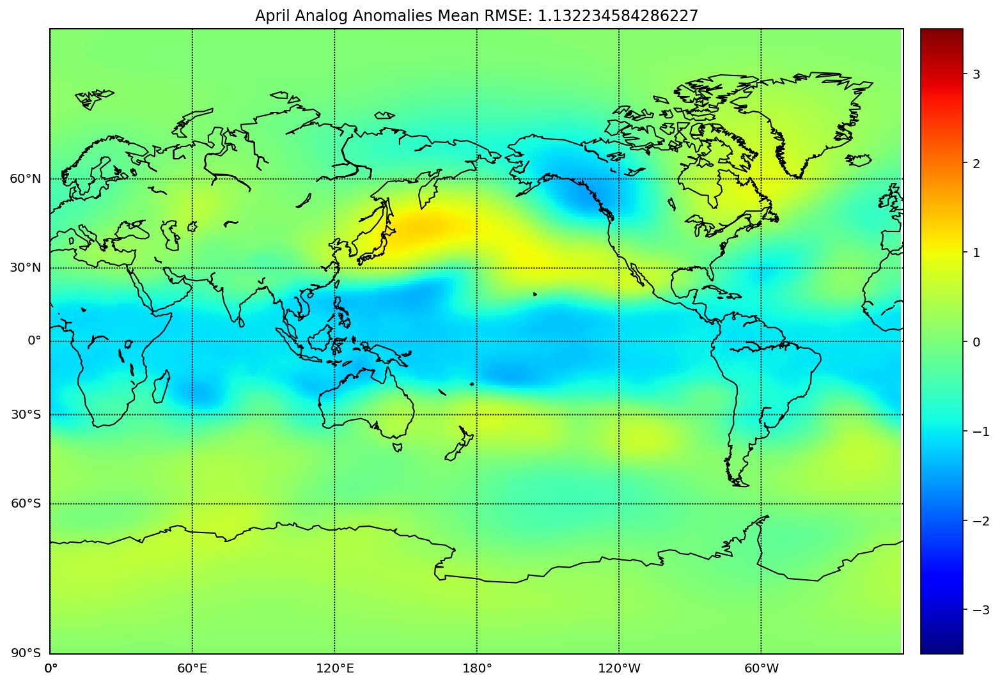

In [0]:
lats = april_analog_anomalies_mean['lat'][:]
lons = april_analog_anomalies_mean['lon'][:]
zg = april_analog_anomalies_mean[:]


plt.figure(figsize=(18,9))
m = Basemap(projection='mill', llcrnrlat=-90, urcrnrlat=90,\
              llcrnrlon=0, urcrnrlon=360, resolution='c')

m.drawcoastlines()
m.drawmapboundary()
m.drawparallels(np.arange(-90.,90.,30.),labels=[1,0,0,0])
m.drawmeridians(np.arange(0.,360., 60.),labels=[0,0,0,1])

x, y = m(*np.meshgrid(lons,lats))

m.pcolormesh(x,y,zg[0, :, :], shading='flat',cmap=plt.cm.jet, vmin = -3.5, vmax = 3.5)
m.colorbar(location='right', )
plt.title('April Analog Anomalies Mean RMSE: '+ str(err.values))
# plt.savefig(str(i+1) + '_' + str(dates[i])+ '.png')